In [1]:
import xarray as xr
import xesmf as xe
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import dask
import cftime
import random
import glob
import matplotlib.gridspec as gs

In [2]:
from dask.distributed import Client, LocalCluster
client = Client()
client

/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/distributed/node.py:182: UserWarning: Port 8787 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 46577 instead
  warnings.warn(


Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /proxy/46577/status,
Dashboard: /proxy/46577/status,Workers: 7
Total threads: 14,Total memory: 63.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:39579,Workers: 7
Dashboard: /proxy/46577/status,Total threads: 14
Started: Just now,Total memory: 63.00 GiB
Comm: tcp://127.0.0.1:41175,Total threads: 2
Dashboard: /proxy/38689/status,Memory: 9.00 GiB
Nanny: tcp://127.0.0.1:42849,


In [3]:
def regrid_ACCESS_u(ds, var):
    #rename coords
    ds = ds.rename({"geolon_c": "longitude", "geolat_c": "latitude"})
    #create the output grid
    ds_out = xe.util.grid_global(1, 1)
    ds_out = ds_out.drop({'lon_b', 'lat_b'})
    #rename grid coords
    ds_out = ds_out.rename({'lon': 'longitude', 'lat': 'latitude'})
    #drop the coords on input ds
    ds_in_1deg = ds.drop({'xu_ocean', 'yu_ocean'})
    #create regridder
    regridder_1deg = xe.Regridder(ds_in_1deg, ds_out, 'bilinear', periodic=True)
    #now regrid
    regridded = regridder_1deg(ds[var].chunk({'xu_ocean': -1, 'yu_ocean': -1}))
    regridded = regridded.assign_coords({'x': ds_out.longitude[0, :], 'y': ds_out.latitude[:, 0]})
    regridded = regridded.rename({'x': 'longitude', 'y': 'latitude'})
    return regridded

In [4]:
def regrid_ACCESS(ds, var):
    #rename coords
    ds = ds.rename({"geolon_t": "longitude", "geolat_t": "latitude"})
    #create the output grid
    ds_out = xe.util.grid_global(1, 1)
    ds_out = ds_out.drop({'lon_b', 'lat_b'})
    #rename grid coords
    ds_out = ds_out.rename({'lon': 'longitude', 'lat': 'latitude'})
    #drop the coords on input ds
    ds_in_1deg = ds.drop({'xt_ocean', 'yt_ocean'})
    #create regridder
    regridder_1deg = xe.Regridder(ds_in_1deg, ds_out, 'bilinear', periodic=True)
    #now regrid
    regridded = regridder_1deg(ds[var].chunk({'xt_ocean': -1, 'yt_ocean': -1}))
    regridded = regridded.assign_coords({'x': ds_out.longitude[0, :], 'y': ds_out.latitude[:, 0]})
    regridded = regridded.rename({'x': 'longitude', 'y': 'latitude'})
    return regridded

In [5]:
#now write a fucntion to output bias and to optioanlly plot
def plot_bias(exp, ctrl, exp_u, exp_v, ref_u, ref_v, freq=None, temp_scale = 2):
    #check frequency of sampling, defaukt to monthly if not specified
    if freq == None:
        freq = 'monthly'
    #check what the obs file is time or month already
    if ctrl.dims[0] == "time":
        ctrl_mon = ctrl.groupby('time.month').mean('time')
        ctrl_mn = ctrl.mean('time')
    else:
        ctrl_mon = ctrl 
        ctrl_mn = ctrl.mean('month')
    #calculate the bias
    if freq == "monthly":
        bias = (exp.groupby('time.month').mean('time') - ctrl_mon)
        #get wind  climatologies
        # Ref dataset
        ref_str = np.sqrt(ref_u**2+ref_v**2)
        ref_u = ref_u.groupby('time.month').mean('time')
        ref_v = ref_v.groupby('time.month').mean('time')
        ref_spd = ref_str.groupby('time.month').mean('time')
        # Exp dataset
        exp_str = np.sqrt(exp_u**2+exp_v**2)
        exp_u = exp_u.groupby('time.month').mean('time')
        exp_v = exp_v.groupby('time.month').mean('time')
        exp_spd = exp_str.groupby('time.month').mean('time')  
        #Now get bias
        u_bias = exp_u - ref_u
        v_bias = exp_v - ref_v
        spd_bias = exp_spd - ref_spd
        fg = bias.plot.contourf(col='month', col_wrap = 4,  transform=ccrs.PlateCarree(),
                             subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8), vmin = -1*temp_scale, vmax = temp_scale, levels =10, extend = 'both',  cmap = 'RdBu_r',
                                cbar_kwargs=dict(label='Depth bias ($m$)'))
        for i, ax in enumerate(fg.axs.flat):
            if i ==0:
                Q = ax.quiver(u_bias.longitude[::10].values, u_bias.latitude[::10].values, u_bias[i, ::10,::10].values, v_bias[i, ::10,::10].values, 
                          transform=ccrs.PlateCarree(), scale = 1, scale_units = 'width', width = 0.0015, headwidth=5)
            else:
                ax.quiver(u_bias.longitude[::10].values, u_bias.latitude[::10].values, u_bias[i, ::10,::10].values, v_bias[i, ::10,::10].values, 
                          transform=ccrs.PlateCarree(), scale = 1, scale_units = 'width', width = 0.0015, headwidth=5)
            ax.coastlines()
            #ax.set_facecolor('grey')
            gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                              linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

            if i in [0,1,2,3,4,5,6,7]:
                gl.bottom_labels = False
            if i in [1,2,3,5,6,7,9,10,11]:
                gl.left_labels = False
            gl.top_labels = False
            gl.right_labels = False               
        qk = ax.quiverkey(Q, 1, 1.1, 0.05, r'$0.05 \frac{N}{m^2}$', labelpos='E',
                   coordinates='axes')
        #now add the month labels\n",
        titles =['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun','Jul',
                 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
        for ax,title in zip(fg.axs.flatten(),titles):
            ax.set_title(title )
            ax.axhline(y=-15, color='black', linestyle='--', linewidth=1)  # 15S
            ax.axhline(y=15, color='black', linestyle='--', linewidth=1)
        return

    elif freq == "season":
        bias = (exp.groupby('time.season').mean('time') - ctrl.groupby('time.season').mean('time'))
        #get wind  climatologies
        # Ref dataset
        ref_str = np.sqrt(ref_u**2+ref_v**2)
        ref_u = ref_u.groupby('time.season').mean('time')
        ref_v = ref_v.groupby('time.season').mean('time')
        ref_spd = ref_str.groupby('time.season').mean('time')
        # Exp dataset
        exp_str = np.sqrt(exp_u**2+exp_v**2)
        exp_u = exp_u.groupby('time.season').mean('time')
        exp_v = exp_v.groupby('time.season').mean('time')
        exp_spd = exp_str.groupby('time.season').mean('time')  
        #Now get bias
        u_bias = exp_u - ref_u
        v_bias = exp_v - ref_v
        spd_bias = exp_spd - ref_spd
        fg = bias.plot.contourf(col='season', col_wrap = 2,  transform=ccrs.PlateCarree(),
                             subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8), vmin = -1*temp_scale, vmax = temp_scale, levels =10, extend = 'both',  cmap = 'RdBu_r',
                                cbar_kwargs=dict(label='Depth bias ($m$)'))
        for i, ax in enumerate(fg.axs.flat):
            if i ==0:
                Q = ax.quiver(u_bias.longitude[::8].values, u_bias.latitude[::4].values, u_bias[i, ::4,::8].values, v_bias[i, ::4,::8].values, 
                          transform=ccrs.PlateCarree(), scale = 1, scale_units = 'width', width = 0.001, headwidth=5)
            else:
                ax.quiver(u_bias.longitude[::8].values, u_bias.latitude[::4].values, u_bias[i, ::4,::8].values, v_bias[i, ::4,::8].values, 
                          transform=ccrs.PlateCarree(), scale = 1, scale_units = 'width', width = 0.001, headwidth=5)

            ax.coastlines()
            #ax.set_facecolor('grey')
            gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                              linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

            if i in [0,1]:
                gl.bottom_labels = False
            if i in [1,3]:
                gl.left_labels = False
            gl.top_labels = False
            gl.right_labels = False               
        qk = ax.quiverkey(Q, 1., 1.05, 0.05, r'$0.05 \frac{N}{m^2}$', labelpos='E',
                   coordinates='axes')
        #now add the month labels\n",
        titles =['DJF', 'MAM', 'JJA', 'SON']
        for ax,title in zip(fg.axs.flatten(),titles):
            ax.set_title(title )
            ax.axhline(y=-15, color='black', linestyle='--', linewidth=1)  # 15S
            ax.axhline(y=15, color='black', linestyle='--', linewidth=1)
        return

    elif freq == "annual":
        bias = (exp.mean('time') - ctrl_mn)
        # Ref dataset
        ref_str = np.sqrt(ref_u**2+ref_v**2)
        ref_u = ref_u.mean('time')
        ref_v = ref_v.mean('time')
        ref_spd = ref_str.mean('time')
        # Exp dataset
        exp_str = np.sqrt(exp_u**2+exp_v**2)
        exp_u = exp_u.mean('time')
        exp_v = exp_v.mean('time')
        exp_spd = exp_str.mean('time')  
        #Now get bias
        u_bias = exp_u - ref_u
        v_bias = exp_v - ref_v
        spd_bias = exp_spd - ref_spd
        # Now plot figure
        plt.figure(figsize = (12,8))
        ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
        bias.plot.contourf(ax=ax, vmin = -1*temp_scale, vmax = temp_scale, cmap = "RdBu_r", levels = 10, extend = 'both',
               transform=ccrs.PlateCarree(), cbar_kwargs=dict(label='Depth bias ($m$)'))

        Q = ax.quiver(u_bias.longitude[::10].values, u_bias.latitude[::5].values,
                      u_bias[::5,::10].values, v_bias[::5,::10].values, 
                  transform=ccrs.PlateCarree(), scale = 1, scale_units = 'width', width = 0.0015, headlength=3)

        #ax.set_title('Annual mean SST bias')
        ax.coastlines(color = 'k')
        ax.axhline(y=-15, color='black', linestyle='--', linewidth=1)  # 15S
        ax.axhline(y=15, color='black', linestyle='--', linewidth=1)
        ax.gridlines()
        #ax.set_facecolor('grey')
        gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                              linewidth=0.7, color='gray', alpha=0.5, linestyle='--')
        gl.top_labels = False
        gl.right_labels = False
        qk = ax.quiverkey(Q, 0.9, 1.1, 0.05, r'$0.05 \frac{N}{m^2}$', labelpos='E',
                   coordinates='axes')
        return 


In [6]:
#load in z20

In [5]:
data_dir = "/g/data/e14/sm2435/Exps_ACCESS_initial/"

In [6]:
ctrl_z20 = xr.open_dataset(data_dir+"ctrl_z20.nc", use_cftime=True, chunks= {"time":240})

In [7]:
ctrl_z20 = regrid_ACCESS(ctrl_z20, 'z20')
ctrl_z20 = ctrl_z20.compute()

In [8]:
VC_z20 = xr.open_dataset(data_dir+"Var_pace_z20.nc", use_cftime=True, chunks= {"time":240})

In [9]:
OC_z20 = xr.open_dataset(data_dir+"obs_pace_z20.nc", use_cftime=True, chunks= {"time":240})

In [10]:
MC_z20 = xr.open_dataset(data_dir+"mod_pace_z20.nc", use_cftime=True, chunks= {"time":240})

In [11]:
OC_z20 = regrid_ACCESS(OC_z20, 'z20')
OC_z20 = OC_z20.compute()

In [12]:
VC_z20 = regrid_ACCESS(VC_z20, 'z20')
VC_z20 = VC_z20.compute()

In [13]:
MC_z20 = regrid_ACCESS(MC_z20, 'z20')
MC_z20 = MC_z20.compute()

In [14]:
ctrl_u = xr.open_dataset(data_dir+"ctrl_uwnd.nc", use_cftime=True, chunks= {"time":240})

In [15]:
ctrl_u = regrid_ACCESS_u(ctrl_u, 'tauu')
ctrl_u = ctrl_u.compute()

In [16]:
ctrl_v = xr.open_dataset(data_dir+"ctrl_vwnd.nc", use_cftime=True, chunks= {"time":240})

In [17]:
ctrl_v = regrid_ACCESS_u(ctrl_v, 'tauv')
ctrl_v = ctrl_v.compute()

In [18]:
VC_u = xr.open_dataset(data_dir+"var_uwnd.nc", use_cftime=True, chunks= {"time":240})
VC_u = regrid_ACCESS_u(VC_u, 'tauu')
VC_u = VC_u.compute()

In [19]:
VC_v = xr.open_dataset(data_dir+"var_vwnd.nc", use_cftime=True, chunks= {"time":240})
VC_v = regrid_ACCESS_u(VC_v, 'tauv')
VC_v = VC_v.compute()

In [20]:
OC_u = xr.open_dataset(data_dir+"ob_uwnd.nc", use_cftime=True, chunks= {"time":240})
OC_u = regrid_ACCESS_u(OC_u, 'tauu')
OC_u = OC_u.compute()

In [21]:
OC_v = xr.open_dataset(data_dir+"ob_vwnd.nc", use_cftime=True, chunks= {"time":240})
OC_v = regrid_ACCESS_u(OC_v, 'tauv')
OC_v = OC_v.compute()

In [22]:
MC_v = xr.open_dataset(data_dir+"mod_vwnd.nc", use_cftime=True, chunks= {"time":240})
MC_v = regrid_ACCESS_u(MC_v, 'tauv')
MC_v = MC_v.compute()

In [23]:
MC_u = xr.open_dataset(data_dir+"mod_uwnd.nc", use_cftime=True, chunks= {"time":240})
MC_u = regrid_ACCESS_u(MC_u, 'tauu')
MC_u = MC_u.compute()

In [24]:
ctrl_sst = xr.open_dataset("/g/data/e14/sm2435/Exps_ACCESS_initial/ctrl_sst.nc",  use_cftime=True, chunks= {"time":240})
VC = xr.open_dataset("/g/data/e14/sm2435/Exps_ACCESS_initial/VAR_PACE_sst.nc",  use_cftime=True, chunks= {"time":240})
MC = xr.open_dataset("/g/data/e14/sm2435/Exps_ACCESS_initial/MC_sst.nc",  use_cftime=True, chunks= {"time":240})
OC = xr.open_dataset("/g/data/e14/sm2435/Exps_ACCESS_initial/OC_sst.nc",  use_cftime=True, chunks= {"time":240})

In [25]:
VC = regrid_ACCESS(VC, 'sst')
VC = VC.compute()

In [26]:
MC = regrid_ACCESS(MC, 'sst')
MC = MC.compute()

In [27]:
OC = regrid_ACCESS(OC, 'sst')
OC = OC.compute()

In [28]:
ctrl = regrid_ACCESS(ctrl_sst, 'sst')
ctrl = ctrl.compute()

In [29]:
MC_u = MC_u.sel(time = slice("0951-01-01", "1103-12-31"))
MC_v = MC_v.sel(time = slice("0951-01-01", "1103-12-31"))
MC_z20 = MC_z20.sel(time = slice("0951-01-01", "1103-12-31"))

In [30]:
ctrl_u = ctrl_u.sel(time = slice("0950-01-01", "1150-12-31"))
ctrl_v = ctrl_v.sel(time = slice("0950-01-01", "1150-12-31"))
ctrl_z20 = ctrl_z20.sel(time = slice("0950-01-01", "1150-12-31"))

In [ ]:
def roll_lon(df):
    df.coords['longitude'] = (df.coords['longitude']) % 360# - 180
    df = df.sortby(df.longitude)
    return df

In [ ]:
ctrl = roll_lon(ctrl)
VC = roll_lon(VC)

ctrl_z20 = roll_lon(ctrl_z20)
VC = roll_lon(VC)

ctrl = roll_lon(ctrl)
VC = roll_lon(VC)

ctrl = roll_lon(ctrl)
VC = roll_lon(VC)

In [33]:
ctrl_uias(OC, VC, OC_u, OC_v, VC_u, VC_v, freq="season", temp_scale = 1)

NameError: name 'ctrl_uias' is not defined

In [33]:
from scipy.stats import ttest_ind

In [33]:
OC_s = OC.groupby('time.season')
ctrl_s = ctrl.groupby('time.season')

In [42]:
dims = ('latitude', 'longitude')

In [45]:
OC.coords

Coordinates:
  * time       (time) object 0951-01-16 12:00:00 ... 1000-12-15 12:00:00
  * longitude  (longitude) float64 -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
  * latitude   (latitude) float64 -89.5 -88.5 -87.5 -86.5 ... 87.5 88.5 89.5

In [84]:
i = 0
for gp in OC_s.groups:
    t_stat,p_value = ttest_ind(OC_s[gp], ctrl_s[gp])
    # Create xarray datasets to hold the results
    t_stat_ds = xr.DataArray(t_stat, dims=dims, coords={dim: OC.coords[dim] for dim in dims})
    p_value_ds = xr.DataArray(p_value, dims=dims, coords={dim: OC.coords[dim] for dim in dims})
    sig_p = p_value_ds.where(p_value_ds<0.05, np.nan)
    # Create a coordinate array for the new dimension "seas"
    seas_coord = xr.DataArray(i, dims=["seas"], coords={"seas": [i]})
    
    # Add the "seas" coordinate to sig_p and concat with sig_p_ds
    sig_p_with_seas = sig_p.expand_dims(seas=seas_coord)
    if i==0:
        sig_p_ds = sig_p_with_seas
    if i>0:
        sig_p_ds = xr.concat([sig_p_ds, sig_p_with_seas], dim = "seas")
    i = i+1

In [38]:
#now write a fucntion to output bias and to optioanlly plot
def plot_bias_sig(exp, ctrl, exp_u, exp_v, ref_u, ref_v, freq=None, temp_scale = 2):
    #check frequency of sampling, defaukt to monthly if not specified
    if freq == None:
        freq = 'monthly'
    #check what the obs file is time or month already
    if ctrl.dims[0] == "time":
        ctrl_mon = ctrl.groupby('time.month').mean('time')
        ctrl_mn = ctrl.mean('time')
    else:
        ctrl_mon = ctrl 
        ctrl_mn = ctrl.mean('month')
    #calculate the bias
    if freq == "monthly":
        bias = (exp.groupby('time.month').mean('time') - ctrl_mon)
        #get wind  climatologies
        # Ref dataset
        ref_str = np.sqrt(ref_u**2+ref_v**2)
        ref_u = ref_u.groupby('time.month').mean('time')
        ref_v = ref_v.groupby('time.month').mean('time')
        ref_spd = ref_str.groupby('time.month').mean('time')
        # Exp dataset
        exp_str = np.sqrt(exp_u**2+exp_v**2)
        exp_u = exp_u.groupby('time.month').mean('time')
        exp_v = exp_v.groupby('time.month').mean('time')
        exp_spd = exp_str.groupby('time.month').mean('time')  
        #Now get bias
        u_bias = exp_u - ref_u
        v_bias = exp_v - ref_v
        spd_bias = exp_spd - ref_spd
        fg = bias.plot.contourf(col='month', col_wrap = 4,  transform=ccrs.PlateCarree(),
                             subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8), vmin = -1*temp_scale, vmax = temp_scale, levels =10, extend = 'both',  cmap = 'RdBu_r',
                                cbar_kwargs=dict(label='Depth bias ($m$)'))
        for i, ax in enumerate(fg.axs.flat):
            if i ==0:
                Q = ax.quiver(u_bias.longitude[::10].values, u_bias.latitude[::10].values, u_bias[i, ::10,::10].values, v_bias[i, ::10,::10].values, 
                          transform=ccrs.PlateCarree(), scale = 1, scale_units = 'width', width = 0.0015, headwidth=5)
            else:
                ax.quiver(u_bias.longitude[::10].values, u_bias.latitude[::10].values, u_bias[i, ::10,::10].values, v_bias[i, ::10,::10].values, 
                          transform=ccrs.PlateCarree(), scale = 1, scale_units = 'width', width = 0.0015, headwidth=5)
            ax.coastlines()
            #ax.set_facecolor('grey')
            gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                              linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

            if i in [0,1,2,3,4,5,6,7]:
                gl.bottom_labels = False
            if i in [1,2,3,5,6,7,9,10,11]:
                gl.left_labels = False
            gl.top_labels = False
            gl.right_labels = False               
        qk = ax.quiverkey(Q, 1, 1.1, 0.05, r'$0.05 \frac{N}{m^2}$', labelpos='E',
                   coordinates='axes')
        #now add the month labels\n",
        titles =['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun','Jul',
                 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
        for ax,title in zip(fg.axs.flatten(),titles):
            ax.set_title(title )
            ax.axhline(y=-15, color='black', linestyle='--', linewidth=1)  # 15S
            ax.axhline(y=15, color='black', linestyle='--', linewidth=1)
        return

    elif freq == "season":
        bias = (exp.groupby('time.season').mean('time') - ctrl.groupby('time.season').mean('time'))
        #get wind  climatologies
        # Ref dataset
        ref_str = np.sqrt(ref_u**2+ref_v**2)
        ref_u = ref_u.groupby('time.season').mean('time')
        ref_v = ref_v.groupby('time.season').mean('time')
        ref_spd = ref_str.groupby('time.season').mean('time')
        # Exp dataset
        exp_str = np.sqrt(exp_u**2+exp_v**2)
        exp_u = exp_u.groupby('time.season').mean('time')
        exp_v = exp_v.groupby('time.season').mean('time')
        exp_spd = exp_str.groupby('time.season').mean('time')  
        #Now get bias
        u_bias = exp_u - ref_u
        v_bias = exp_v - ref_v
        spd_bias = exp_spd - ref_spd
        fg = bias.plot.contourf(col='season', col_wrap = 2,  transform=ccrs.PlateCarree(),
                             subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                              figsize=(20,8), vmin = -1*temp_scale, vmax = temp_scale, levels =10, extend = 'both',  cmap = 'RdBu_r',
                                cbar_kwargs=dict(label='Depth bias ($m$)'))
        i = 0
        dims = ('latitude', 'longitude')
        for gp in exp.groupby('time.season').groups:
            t_stat,p_value = ttest_ind(exp.groupby('time.season')[gp], ctrl.groupby('time.season')[gp])
            # Create xarray datasets to hold the results
            t_stat_ds = xr.DataArray(t_stat, dims=dims, coords={dim: exp.coords[dim] for dim in dims})
            p_value_ds = xr.DataArray(p_value, dims=dims, coords={dim: exp.coords[dim] for dim in dims})
            sig_p = p_value_ds.where(p_value_ds<0.05, np.nan)
            # Create a coordinate array for the new dimension "seas"
            seas_coord = xr.DataArray(i, dims=["seas"], coords={"seas": [i]})

            # Add the "seas" coordinate to sig_p and concat with sig_p_ds
            sig_p_with_seas = sig_p.expand_dims(seas=seas_coord)
            if i==0:
                sig_p_ds = sig_p_with_seas
            if i>0:
                sig_p_ds = xr.concat([sig_p_ds, sig_p_with_seas], dim = "seas")
            i = i+1

              
        
        for i, ax in enumerate(fg.axs.flat):
            ax.contourf(sig_p_ds.longitude, sig_p_ds.latitude, sig_p_ds[i],  
                          transform=ccrs.PlateCarree(),levels=[0, 0.05],
                                                                hatches=['///'], alpha = 0.0, add_colorbar=False)

        #now add the month labels\n",
        titles =['DJF', 'MAM', 'JJA', 'SON']
        i = 0
        for ax,title in zip(fg.axs.flatten(),titles):
            ax.set_title(title )
            ax.axhline(y=-15, color='black', linestyle='--', linewidth=1)  # 15S
            ax.axhline(y=15, color='black', linestyle='--', linewidth=1)
            ax.coastlines()
            #ax.set_facecolor('grey')
            gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                              linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

            if i in [0,1]:
                gl.bottom_labels = False
            if i in [1,3]:
                gl.left_labels = False
            gl.top_labels = False
            gl.right_labels = False      
            i=i+1
        return

    elif freq == "annual":
        bias = (exp.mean('time') - ctrl_mn)
        # Ref dataset
        ref_str = np.sqrt(ref_u**2+ref_v**2)
        ref_u = ref_u.mean('time')
        ref_v = ref_v.mean('time')
        ref_spd = ref_str.mean('time')
        # Exp dataset
        exp_str = np.sqrt(exp_u**2+exp_v**2)
        exp_u = exp_u.mean('time')
        exp_v = exp_v.mean('time')
        exp_spd = exp_str.mean('time')  
        #Now get bias
        u_bias = exp_u - ref_u
        v_bias = exp_v - ref_v
        spd_bias = exp_spd - ref_spd
        # Now plot figure
        plt.figure(figsize = (12,8))
        ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
        bias.plot.contourf(ax=ax, vmin = -1*temp_scale, vmax = temp_scale, cmap = "RdBu_r", levels = 10, extend = 'both',
               transform=ccrs.PlateCarree(), cbar_kwargs=dict(label='Depth bias ($m$)'))

        Q = ax.quiver(u_bias.longitude[::10].values, u_bias.latitude[::5].values,
                      u_bias[::5,::10].values, v_bias[::5,::10].values, 
                  transform=ccrs.PlateCarree(), scale = 1, scale_units = 'width', width = 0.0015, headlength=3)

        #ax.set_title('Annual mean SST bias')
        ax.coastlines(color = 'k')
        ax.axhline(y=-15, color='black', linestyle='--', linewidth=1)  # 15S
        ax.axhline(y=15, color='black', linestyle='--', linewidth=1)
        ax.gridlines()
        #ax.set_facecolor('grey')
        gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                              linewidth=0.7, color='gray', alpha=0.5, linestyle='--')
        gl.top_labels = False
        gl.right_labels = False
        qk = ax.quiverkey(Q, 0.9, 1.1, 0.05, r'$0.05 \frac{N}{m^2}$', labelpos='E',
                   coordinates='axes')
        return 


In [55]:
def plot_bias_sig_annual(ctrl, exp, temp_scale=2):
    ctrl_mn = ctrl.mean('time')
    exp_mn = exp.mean("time")
    # Now calculate significance for annual component
    dims = ('latitude', 'longitude')
    t_stat, p_value = ttest_ind(exp, ctrl)
    t_stat_ds = xr.DataArray(t_stat, dims=dims, coords={dim: exp.coords[dim] for dim in dims})
    p_value_ds = xr.DataArray(p_value, dims=dims, coords={dim: exp.coords[dim] for dim in dims})
    sig_p = p_value_ds.where(p_value_ds < 0.05, np.nan)
    
    # Now plot figure
    plt.figure(figsize=(12, 8))
    ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
    bias = (exp_mn - ctrl_mn)
    bias.plot.contourf(ax=ax, vmin=-1*temp_scale, vmax=temp_scale, cmap="RdBu_r", levels=10, extend='both',
                       transform=ccrs.PlateCarree(), cbar_kwargs=dict(label='Depth bias ($m$)'))

    ax.coastlines(color='k')
    ax.axhline(y=-15, color='black', linestyle='--', linewidth=1)  # 15S
    ax.axhline(y=15, color='black', linestyle='--', linewidth=1)
    ax.gridlines()
    
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
   
    # Plot significance
    ax.contourf(sig_p.longitude, sig_p.latitude, sig_p, levels=[0, 0.05],
                hatches=['///'], alpha=0.0, add_colorbar=False, transform=ccrs.PlateCarree())
    
    return



In [38]:
def plot_bias_sig_annual(ctrl, exp, temp_scale=2):
    ctrl_mn = ctrl.mean('time')
    exp_mn = exp.mean("time")
    # Now calculate significance for annual component
    dims = ('latitude', 'longitude')
    t_stat, p_value = ttest_ind(exp, ctrl)
    t_stat_ds = xr.DataArray(t_stat, dims=dims, coords={dim: exp.coords[dim] for dim in dims})
    p_value_ds = xr.DataArray(p_value, dims=dims, coords={dim: exp.coords[dim] for dim in dims})
    sig_p = p_value_ds.where(p_value_ds < 0.05, np.nan)
    
    # Now plot figure
    plt.figure(figsize=(12, 4))
    ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))

    # Set extent for longitude and latitude if provided
    ax.set_extent([30, 290, -30, 30], crs=ccrs.PlateCarree())

    bias = (exp_mn - ctrl_mn)
    bias.plot.contourf(ax=ax, vmin=-1*temp_scale, vmax=temp_scale, cmap="RdBu_r", levels=10, extend='both',
                       transform=ccrs.PlateCarree(), cbar_kwargs=dict(label='temp bias oC'))

    ax.coastlines(color='k')
    ax.axhline(y=-15, color='black', linestyle='--', linewidth=1)  # 15S
    ax.axhline(y=15, color='black', linestyle='--', linewidth=1)
    ax.gridlines()
    
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
   
    # Plot significance
    ax.contourf(sig_p.longitude, sig_p.latitude, sig_p, levels=[0, 0.05],
                hatches=['///'], alpha=0.0, add_colorbar=False, transform=ccrs.PlateCarree())
    
    return


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1662: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = super().contourf(*args, **kwargs)


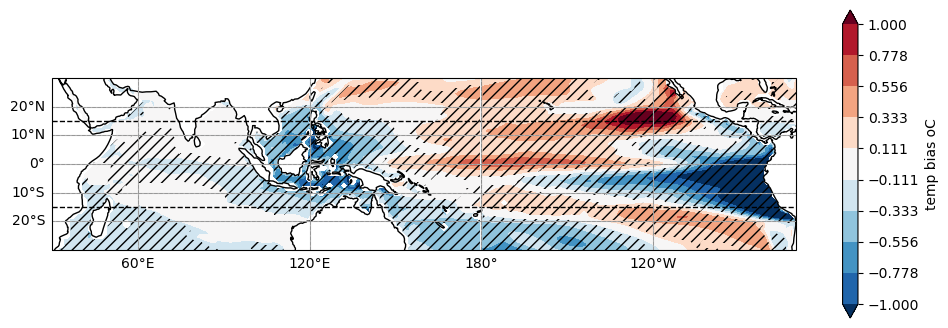

In [39]:
plot_bias_sig_annual(ctrl, VC, temp_scale=1)

/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1662: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = super().contourf(*args, **kwargs)


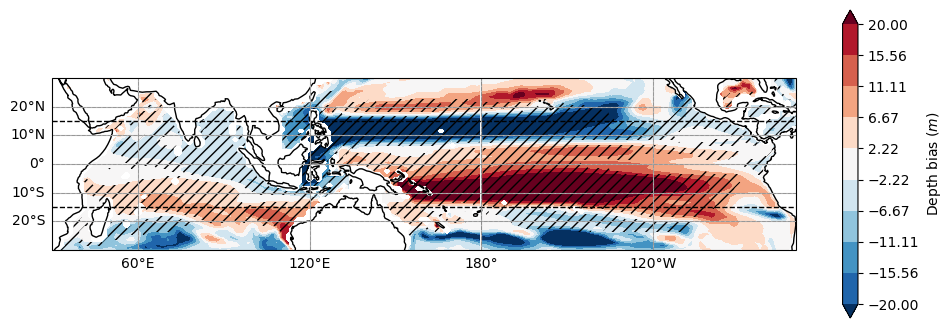

In [37]:
plot_bias_sig_annual(ctrl_z20, VC_z20, temp_scale=20)

/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1662: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = super().contourf(*args, **kwargs)


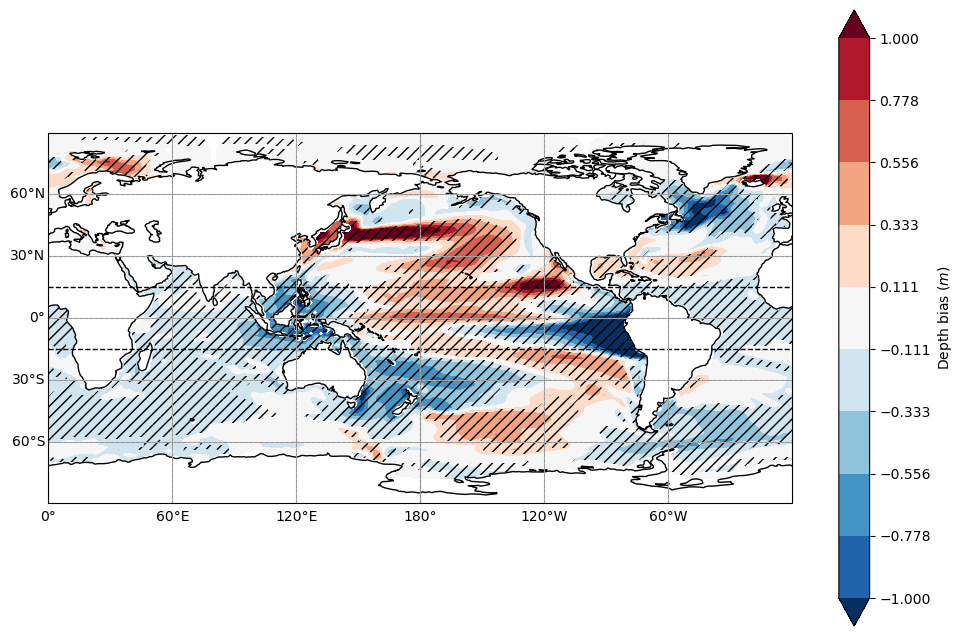

In [60]:
plot_bias_sig_annual(ctrl, OC, temp_scale=1)

/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1662: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = super().contourf(*args, **kwargs)


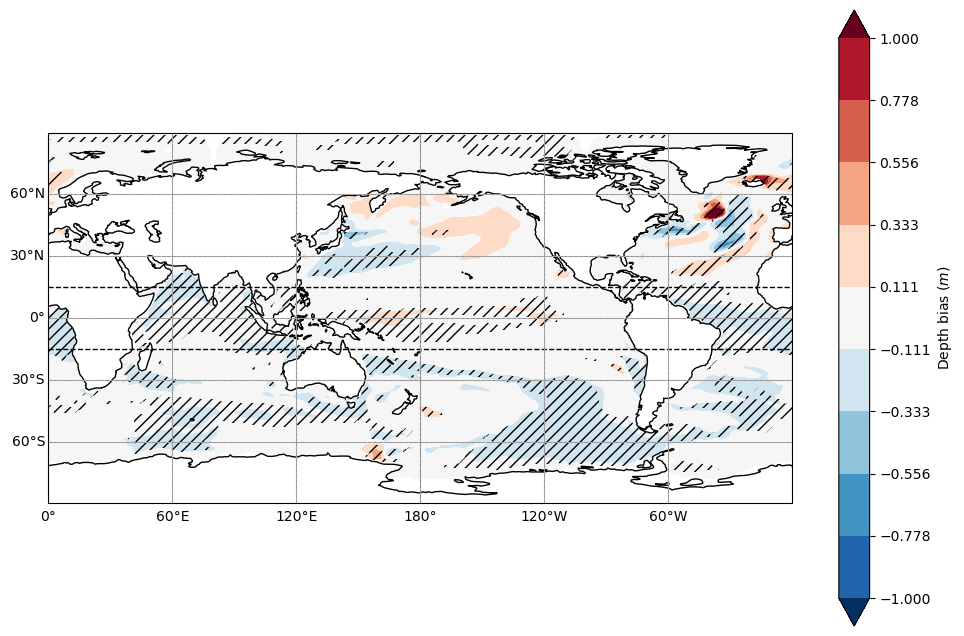

In [61]:
plot_bias_sig_annual(ctrl, MC, temp_scale=1)

/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1662: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = super().contourf(*args, **kwargs)


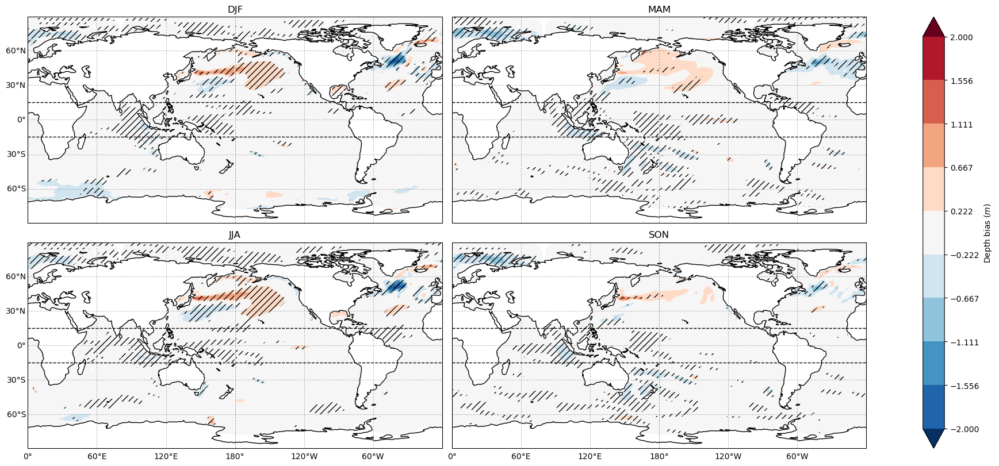

In [39]:
plot_bias_sig(OC, VC, OC_u, OC_v, ctrl_u, ctrl_v, freq='season', temp_scale = 2)

/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1662: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = super().contourf(*args, **kwargs)


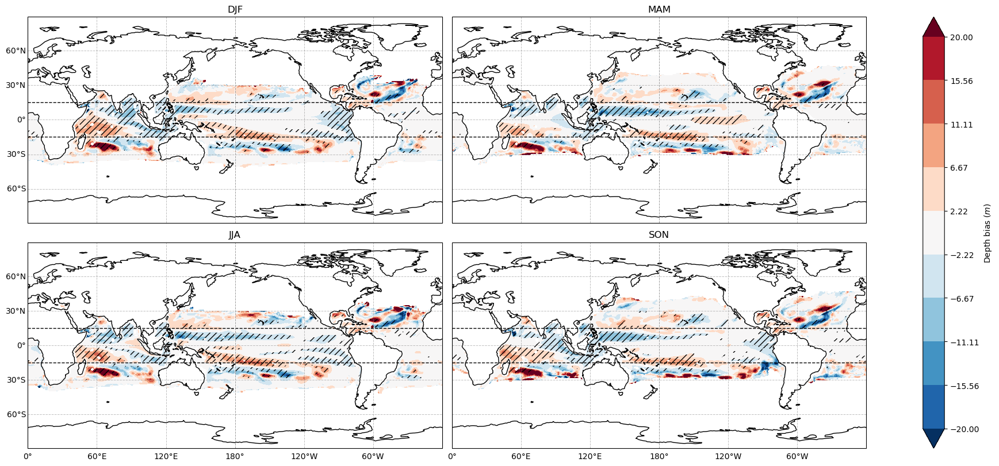

In [44]:
plot_bias_sig(OC_z20, VC_z20, OC_u, OC_v, ctrl_u, ctrl_v, freq='season', temp_scale = 20)

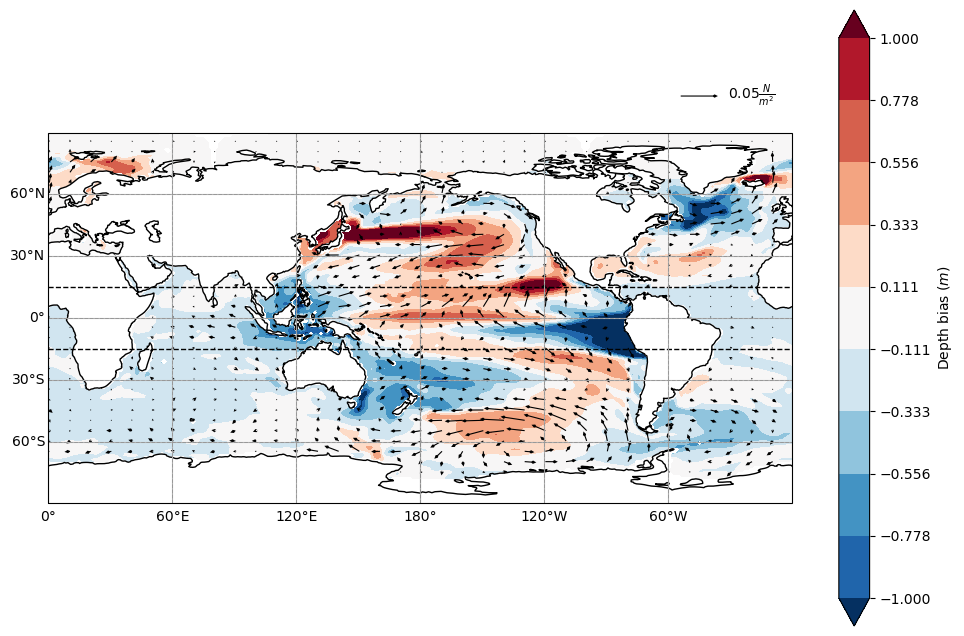

In [40]:
plot_bias_sig(OC, ctrl, OC_u, OC_v, ctrl_u, ctrl_v, freq='annual', temp_scale = 1)

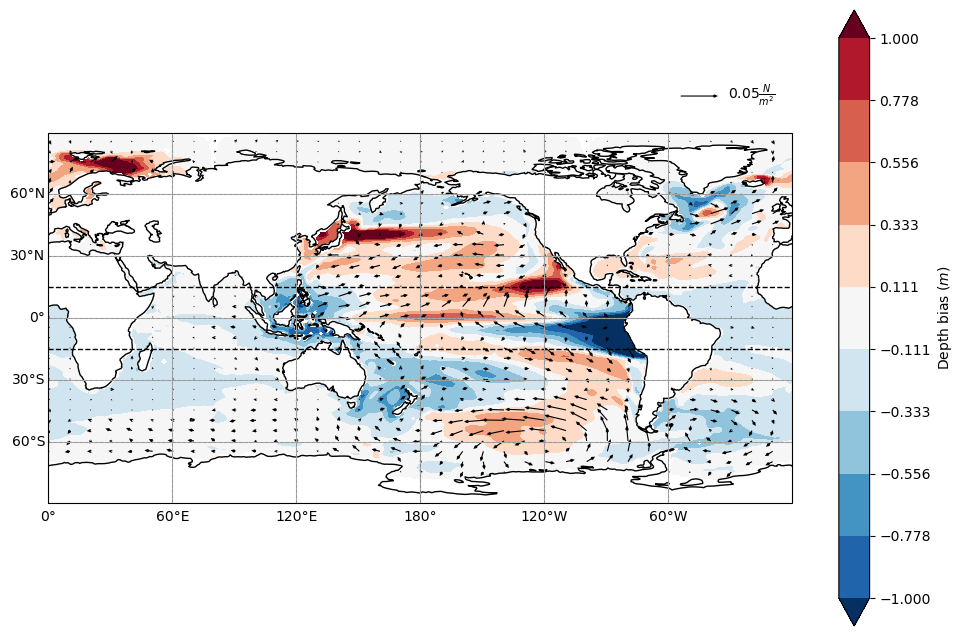

In [42]:
plot_bias_sig(VC, ctrl, VC_u, VC_v, ctrl_u, ctrl_v, freq='annual', temp_scale = 1)

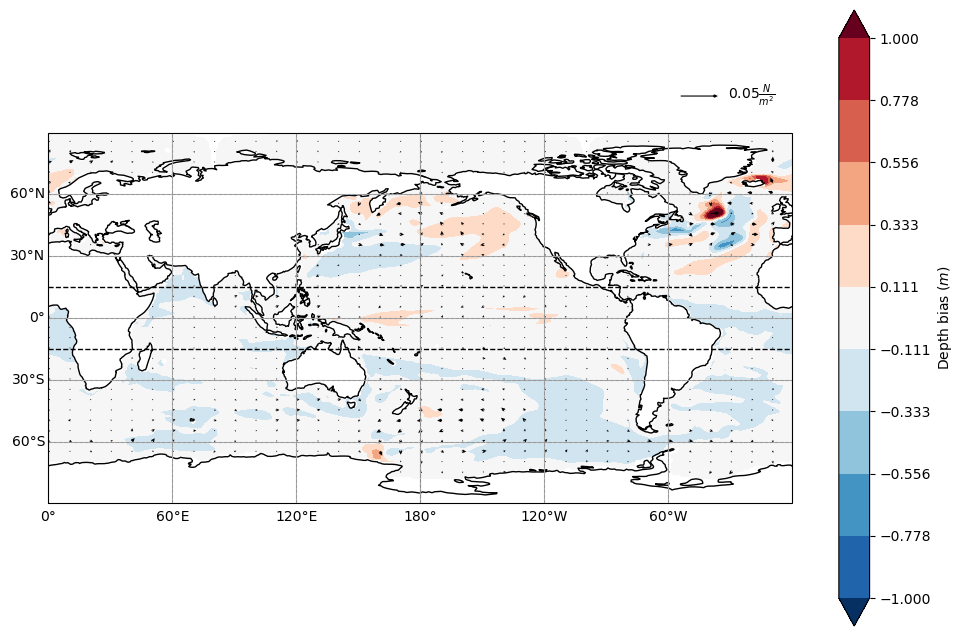

In [43]:
plot_bias_sig(MC, ctrl, MC_u, MC_v, ctrl_u, ctrl_v, freq='annual', temp_scale = 1)

/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1662: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = super().contourf(*args, **kwargs)


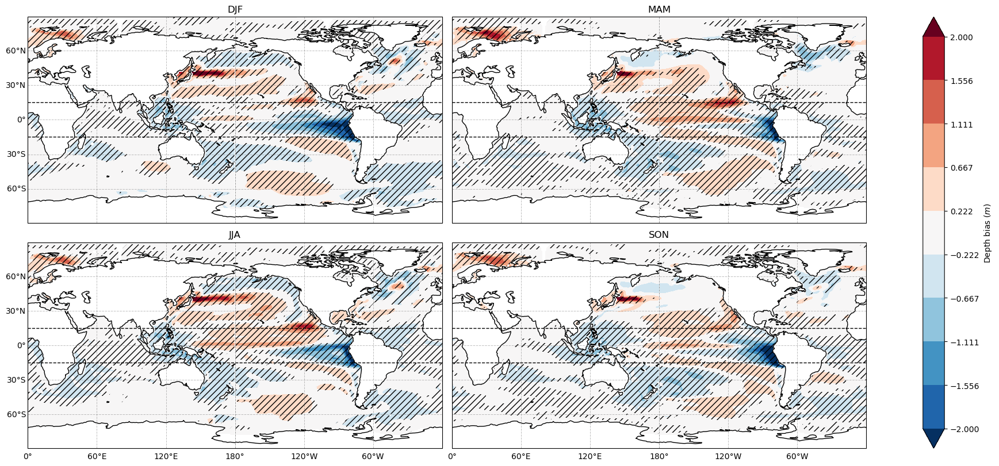

In [41]:
plot_bias_sig(VC, ctrl, OC_u, OC_v, ctrl_u, ctrl_v, freq='season', temp_scale = 2)

/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1662: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = super().contourf(*args, **kwargs)


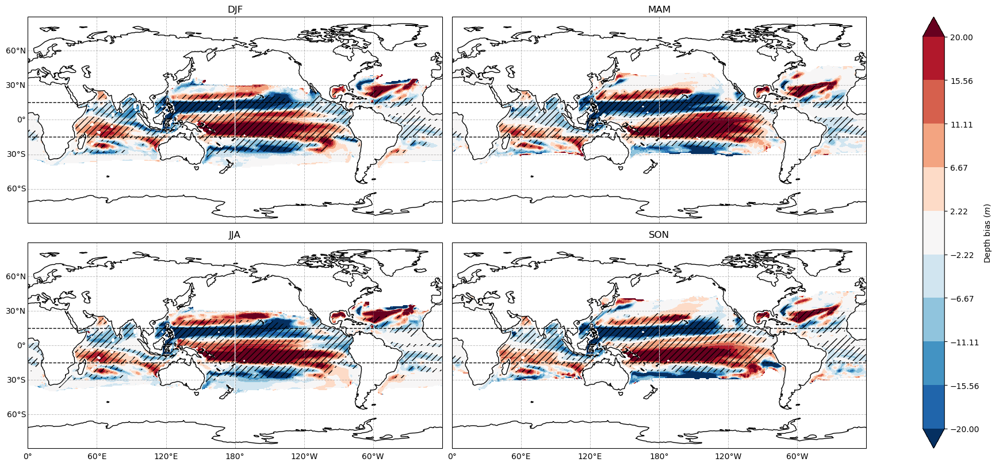

In [45]:
plot_bias_sig(OC_z20, ctrl_z20, OC_u, OC_v, ctrl_u, ctrl_v, freq='season', temp_scale = 20)

/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1662: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = super().contourf(*args, **kwargs)


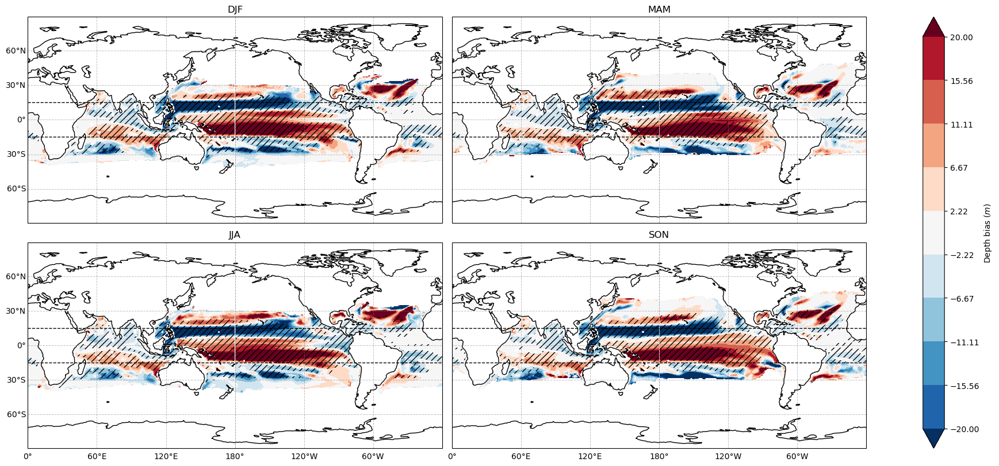

In [46]:
plot_bias_sig(VC_z20, ctrl_z20, OC_u, OC_v, ctrl_u, ctrl_v, freq='season', temp_scale = 20)

/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1662: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = super().contourf(*args, **kwargs)


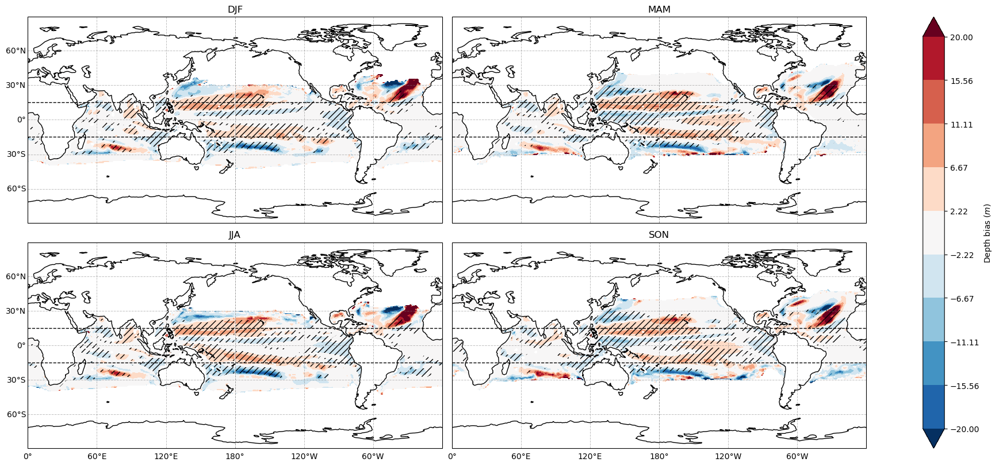

In [47]:
plot_bias_sig(MC_z20, ctrl_z20, OC_u, OC_v, ctrl_u, ctrl_v, freq='season', temp_scale = 20)

/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1662: UserWarning: The following kwargs were not used by contour: 'add_colorbar'
  result = super().contourf(*args, **kwargs)


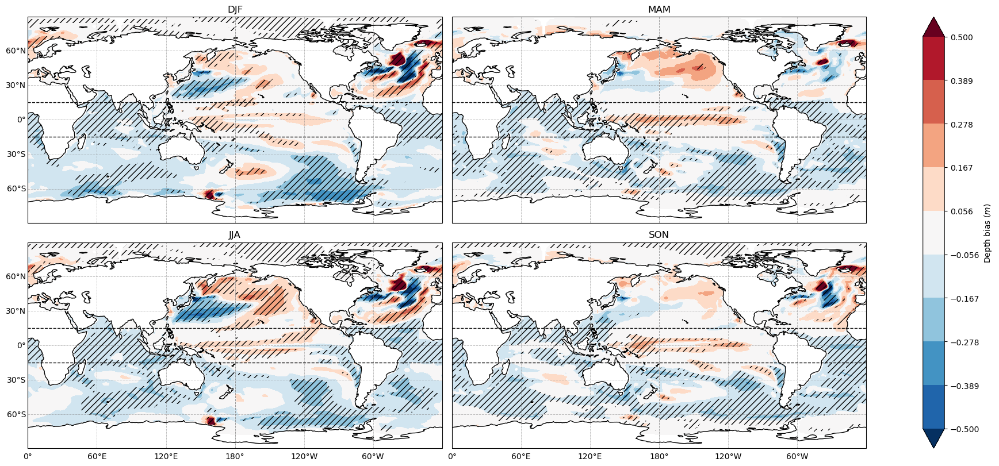

In [48]:
plot_bias_sig(MC, ctrl, OC_u, OC_v, ctrl_u, ctrl_v, freq='season', temp_scale = 0.5)

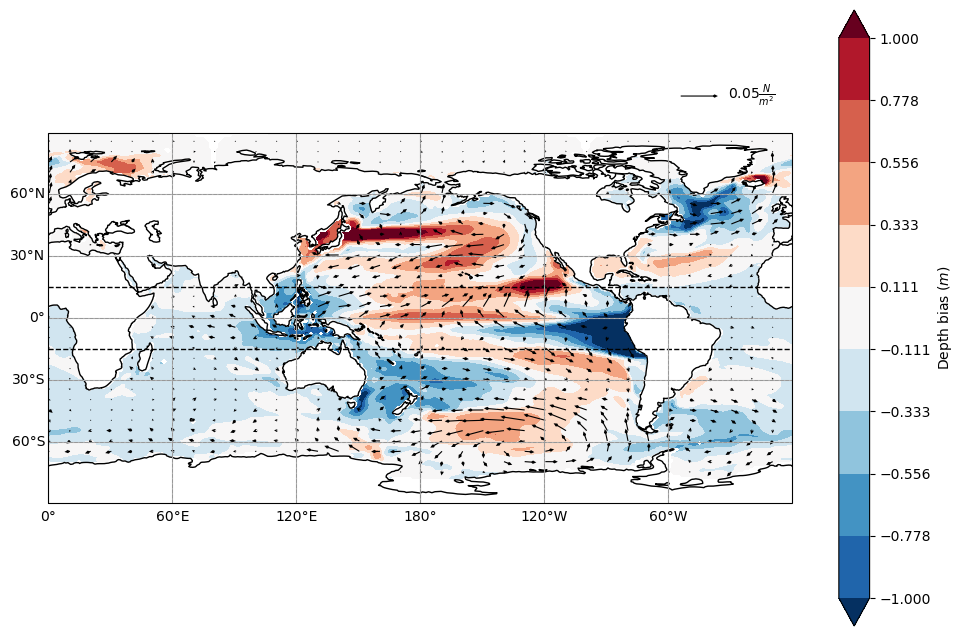

In [44]:
plot_bias(OC, ctrl, OC_u, OC_v, ctrl_u, ctrl_v, freq="annual", temp_scale = 1)

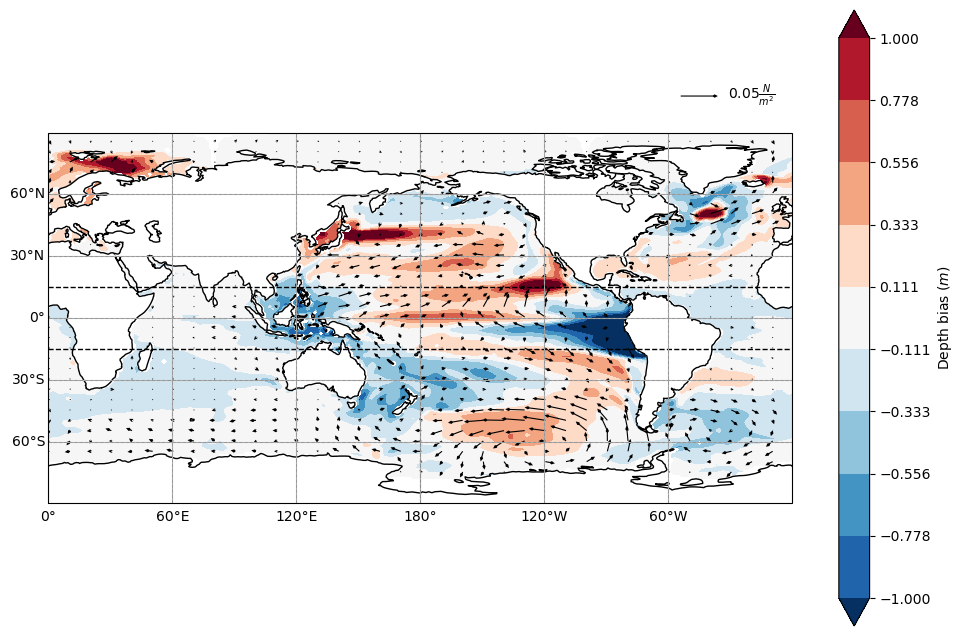

In [48]:
plot_bias(VC, ctrl, VC_u, VC_v, ctrl_u, ctrl_v, freq="annual", temp_scale = 1)

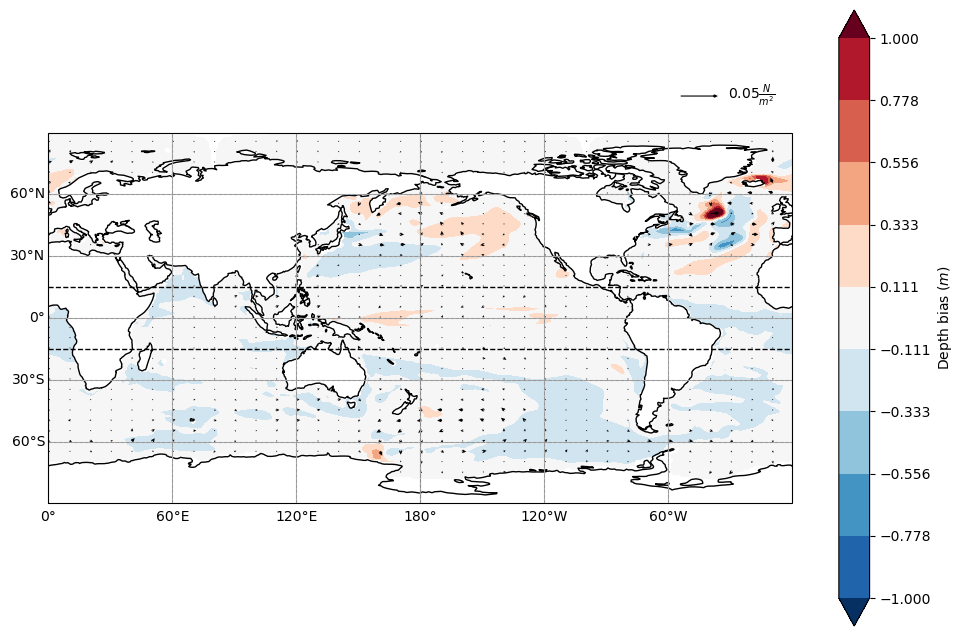

In [46]:
plot_bias(MC, ctrl, MC_u, MC_v, ctrl_u, ctrl_v, freq="annual", temp_scale = 1)

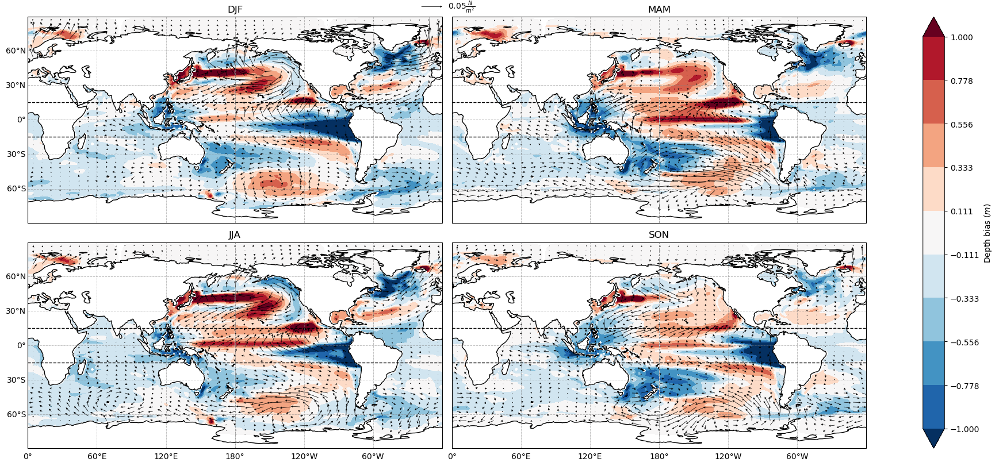

In [33]:
plot_bias(OC, ctrl, OC_u, OC_v, ctrl_u, ctrl_v, freq="season", temp_scale = 1)

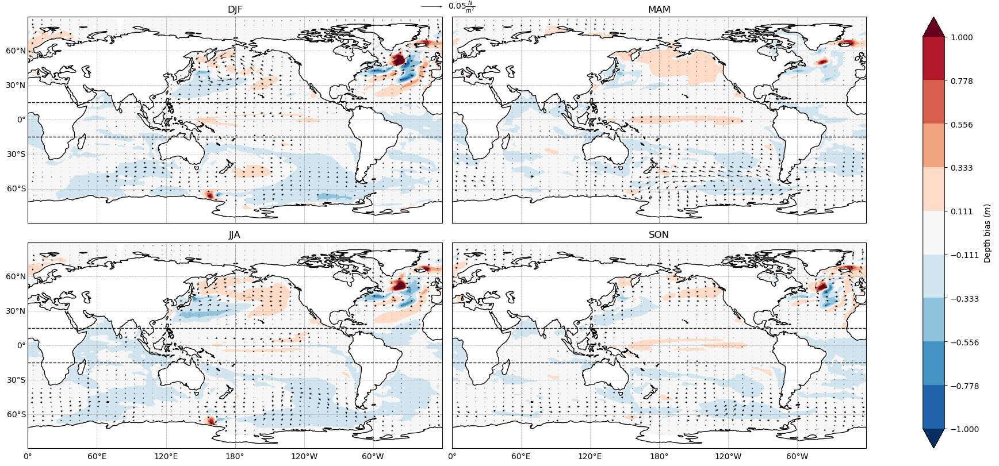

In [36]:
plot_bias(MC, ctrl, MC_u, MC_v, ctrl_u, ctrl_v, freq="season", temp_scale = 1)

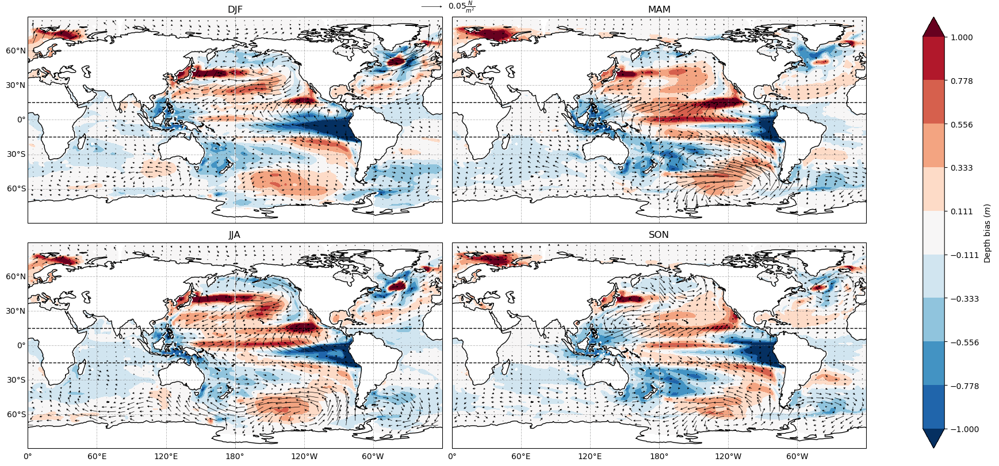

In [37]:
plot_bias(VC, ctrl, VC_u, VC_v, ctrl_u, ctrl_v, freq="season", temp_scale = 1)

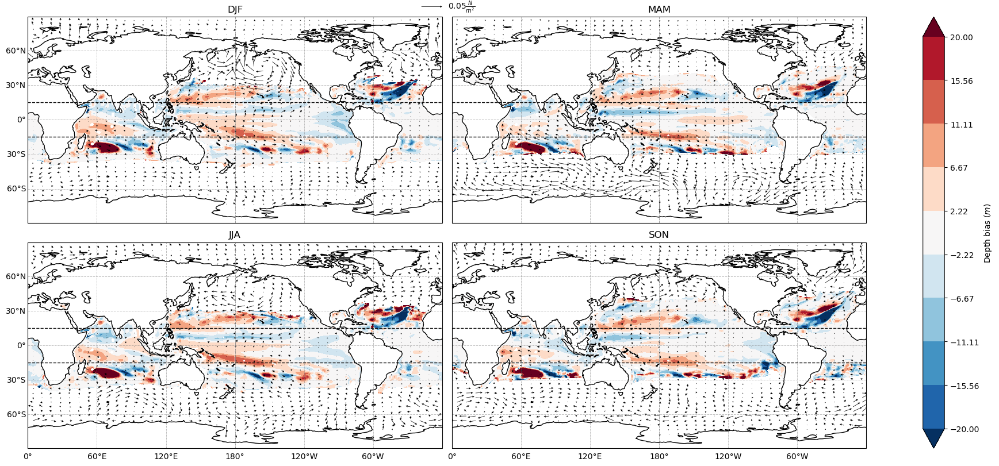

In [98]:
plot_bias(OC_z20, VC_z20, OC_u, OC_v, VC_u, VC_v, freq="season", temp_scale = 20)

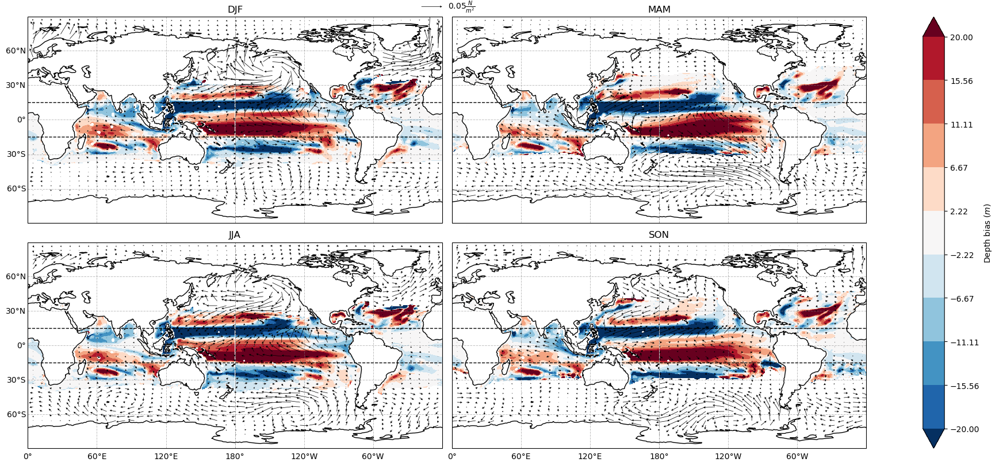

In [63]:
plot_bias(OC_z20, ctrl_z20, OC_u, OC_v, ctrl_u, ctrl_v, freq="season", temp_scale = 20)

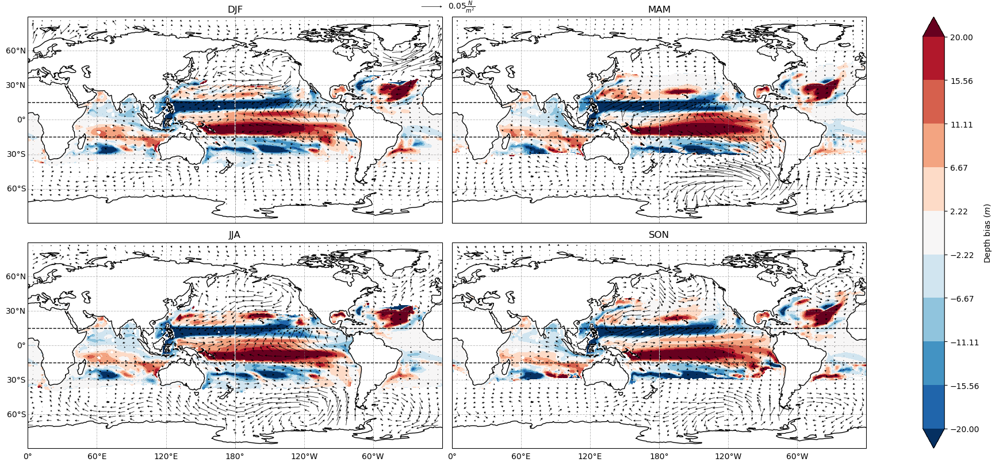

In [64]:
plot_bias(VC_z20, ctrl_z20, VC_u, VC_v, ctrl_u, ctrl_v, freq="season", temp_scale = 20)

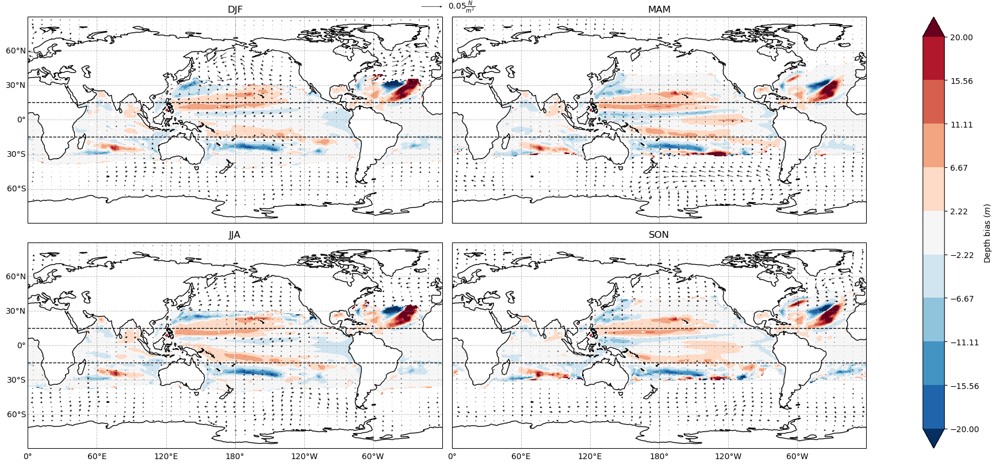

In [65]:
plot_bias(MC_z20, ctrl_z20, MC_u, MC_v, ctrl_u, ctrl_v, freq="season", temp_scale = 20)

Text(0.5, 1.0, 'No ENSO no Bias exp - CTRL \n Z20 and windstress difference')

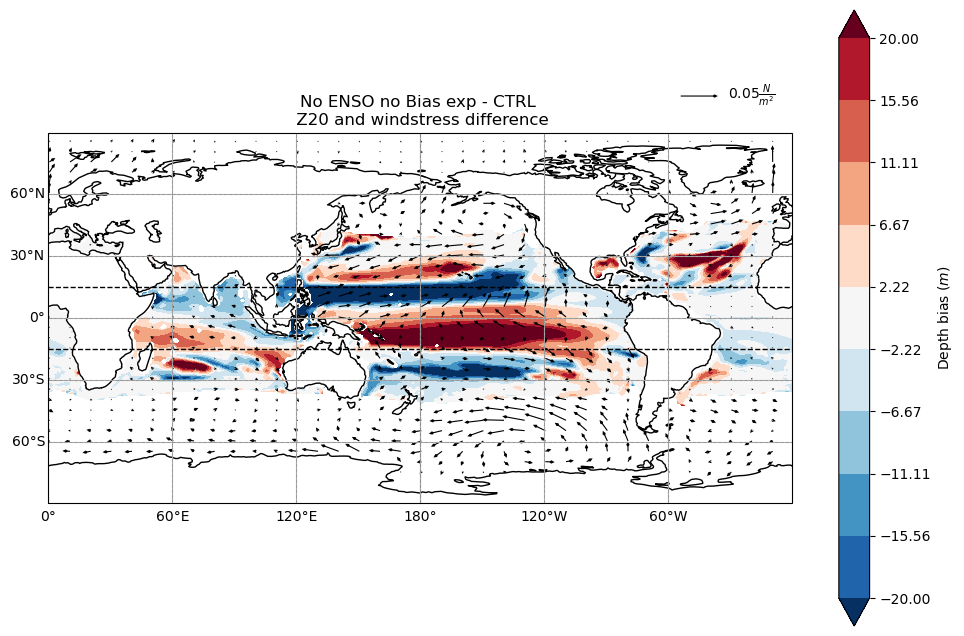

In [31]:
plot_bias(OC_z20, ctrl_z20, OC_u, OC_v, ctrl_u, ctrl_v, freq="annual", plot=True, temp_scale = 20)
plt.title("No ENSO no Bias exp - CTRL \n Z20 and windstress difference")

Text(0.5, 1.0, 'No ENSO exp - CTRL \n Z20 and windstress difference')

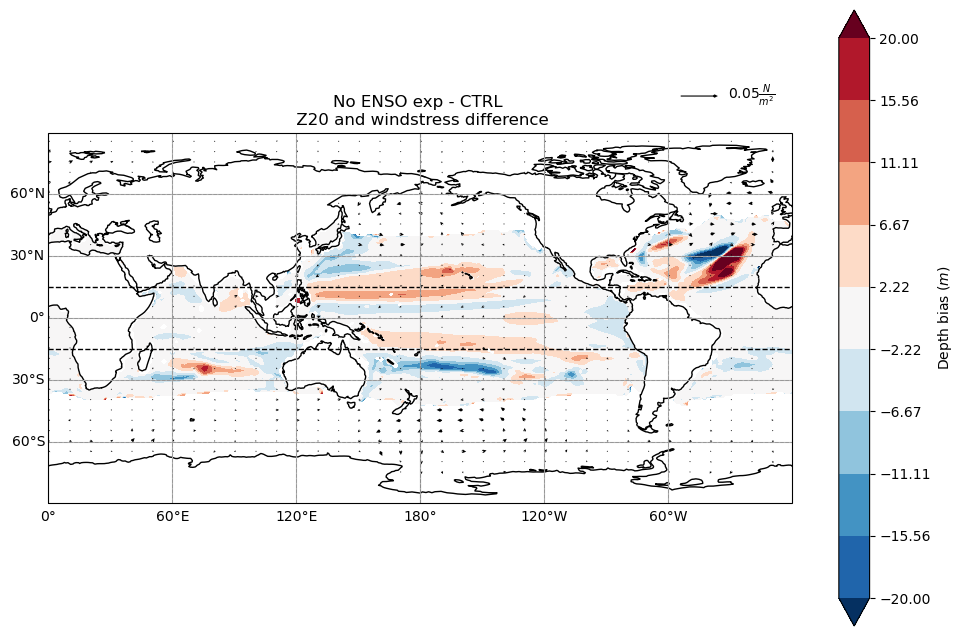

In [32]:
plot_bias(MC_z20, ctrl_z20, MC_u, MC_v, ctrl_u, ctrl_v, freq="annual", plot=True, temp_scale = 20)
plt.title("No ENSO exp - CTRL \n Z20 and windstress difference")

Text(0.5, 1.0, 'ENSO no Bias exp - CTRL \n Z20 and windstress difference')

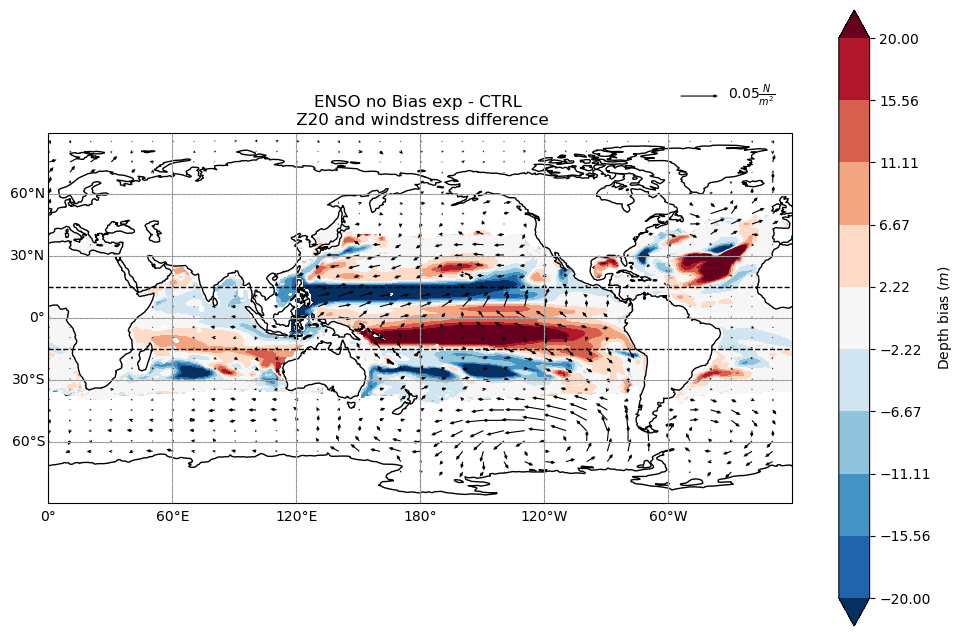

In [33]:
plot_bias(VC_z20, ctrl_z20, VC_u, VC_v, ctrl_u, ctrl_v, freq="annual", plot=True, temp_scale = 20)
plt.title("ENSO no Bias exp - CTRL \n Z20 and windstress difference")

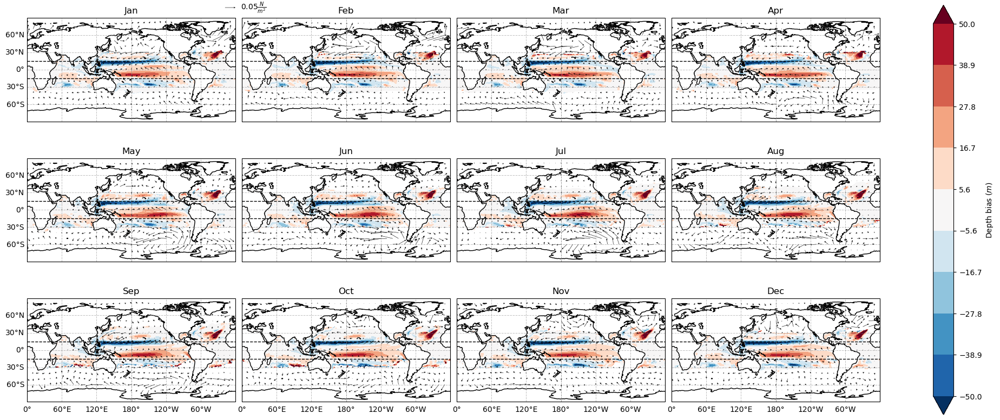

In [55]:
plot_bias(VC_z20, ctrl_z20, VC_u, VC_v, ctrl_u, ctrl_v, freq="monthly", temp_scale = 50)

/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1662: UserWarning: The following kwargs were not used by contour: 'facecolor'
  result = super().contourf(*args, **kwargs)
/jobfs/92367427.gadi-pbs/ipykernel_1868188/3184439763.py:43: DeprecationWarning: self.axes is deprecated since 2022.11 in order to align with matplotlibs plt.subplots, use self.axs instead.
  for i, ax in enumerate(fg.axes.flat):
/jobfs/92367427.gadi-pbs/ipykernel_1868188/3184439763.py:57: DeprecationWarning: self.axes is deprecated since 2022.11 in order to align with matplotlibs plt.subplots, use self.axs instead.
  for ax,title in zip(fg.axes.flatten(),titles):


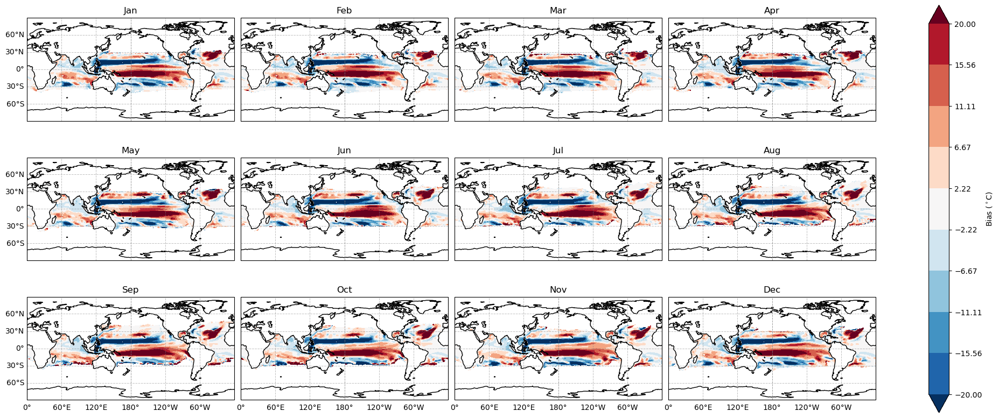

In [23]:
z20_bias(VC_z20, ctrl_z20, freq="monthly", plot=True, temp_scale = 20)

Text(0.5, 1.0, 'z20C depth difference (no bias-ctrl)')

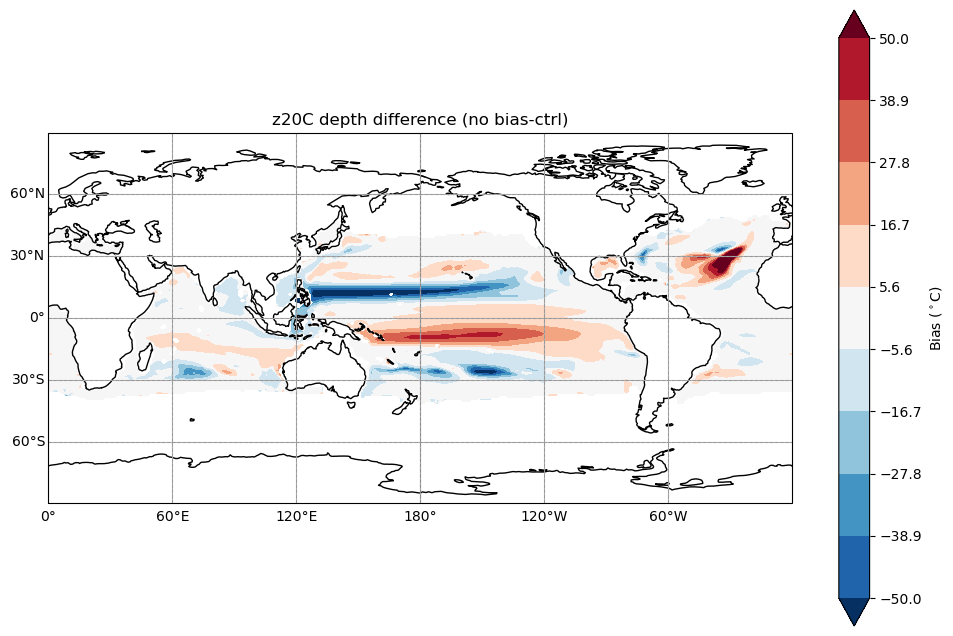

In [33]:
z20_bias(VC_z20, ctrl_z20, freq="annual", plot=True, temp_scale = 50)
plt.title("z20C depth difference (no bias-ctrl)")

Text(0.5, 1.0, 'z20C depth difference (no enso no bias-ctrl)')

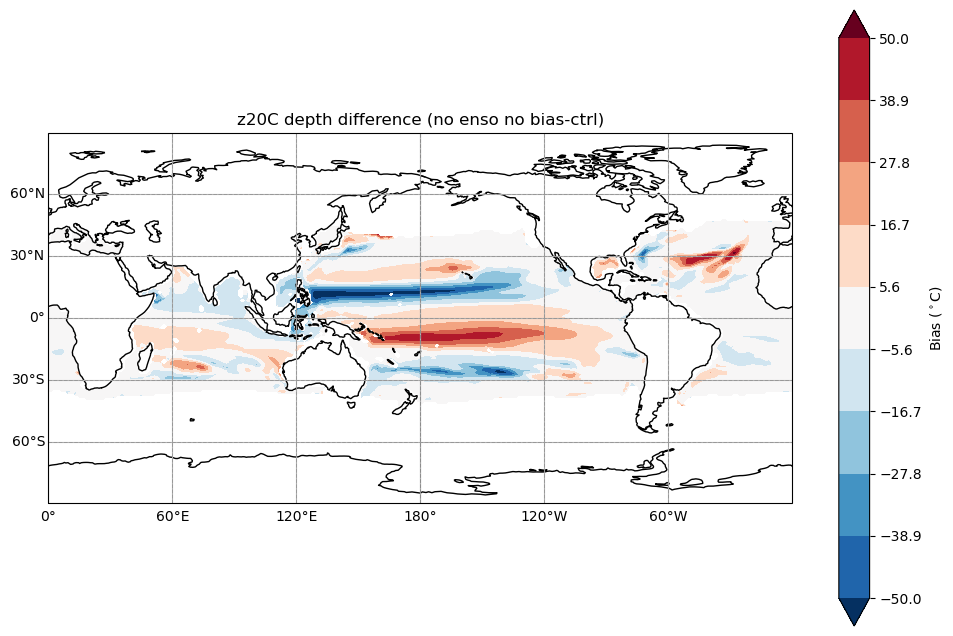

In [31]:
z20_bias(OC_z20, ctrl_z20, freq="annual", plot=True, temp_scale = 50)
plt.title("z20C depth difference (no enso no bias-ctrl)")

Text(0.5, 1.0, 'z20C depth difference (no enso-ctrl)')

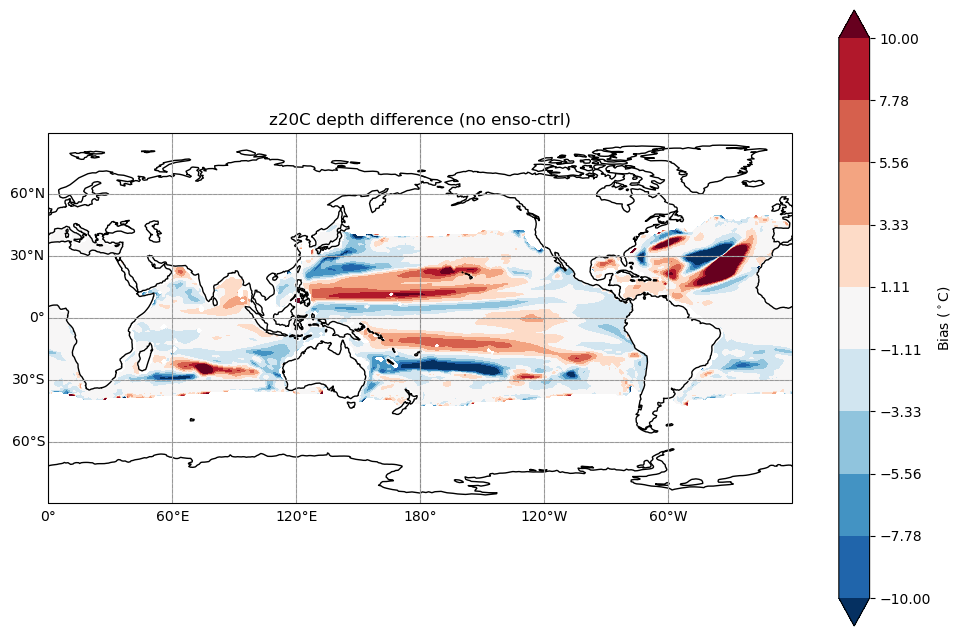

In [15]:
plot_bias(MC_z20, ctrl_z20, freq="annual", plot=True, temp_scale = 10)
plt.title("z20C depth difference (no enso-ctrl)")

In [76]:
#look at correlation of SST difference
bias_OC = (OC.groupby('time.season') - ctrl.groupby('time.season').mean('time')).resample(time='QS-DEC').mean(dim="time")
bias_VC = (VC.groupby('time.season') - ctrl.groupby('time.season').mean('time')).resample(time='QS-DEC').mean(dim="time")


In [89]:
bias_OCz = (OC_z20.groupby('time.season') - ctrl_z20.groupby('time.season').mean('time')).resample(time='QS-DEC').mean(dim="time")
bias_VCz = (VC_z20.groupby('time.season') - ctrl_z20.groupby('time.season').mean('time')).resample(time='QS-DEC').mean(dim="time")


In [37]:
import xskillscore as xs

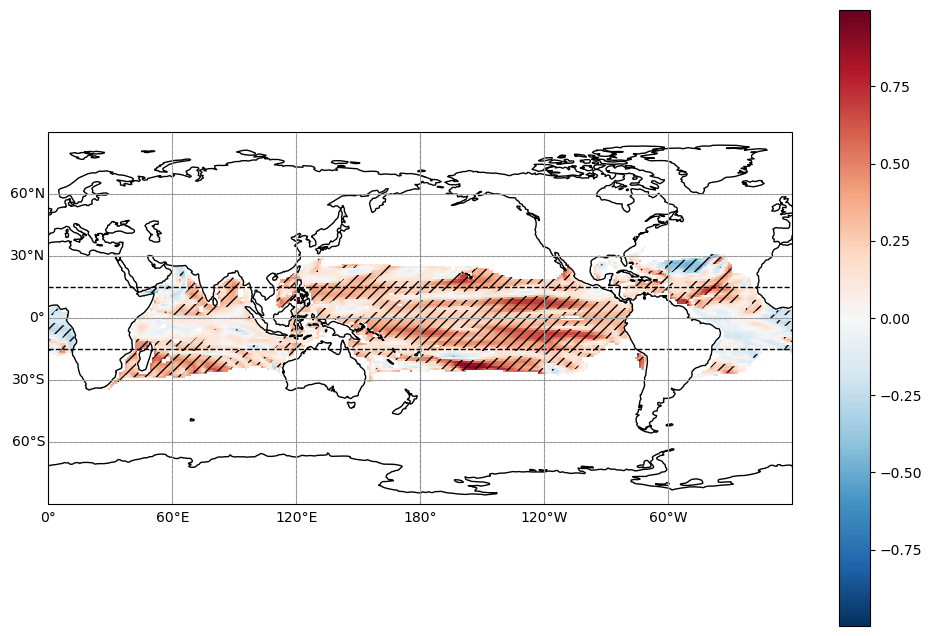

In [90]:
c = xs.pearson_r(bias_OCz, bias_VCz, dim="time")
p1 = xs.pearson_r_p_value(bias_OCz, bias_VCz, dim="time")
# Now plot figure
plt.figure(figsize = (12,8))
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
c.plot(ax = ax, transform=ccrs.PlateCarree(),
                              )
(p1.where(p1<0.05)).plot.contourf(ax = ax, levels=[0, 0.05],
                                  hatches=['///'], alpha = 0.0, add_colorbar=False, transform=ccrs.PlateCarree(),
                             )


ax.coastlines(color = 'k')
ax.axhline(y=-15, color='black', linestyle='--', linewidth=1)  # 15S
ax.axhline(y=15, color='black', linestyle='--', linewidth=1)
ax.gridlines()
#ax.set_facecolor('grey')
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False


In [98]:
bias_MC = (MC.groupby('time.month').mean('time') - ctrl.groupby('time.month').mean('time'))#.resample(time='QS-DEC').mean(dim="time")
bias_VCOC = (VC.groupby('time.month').mean('time') - OC.groupby('time.month').mean('time'))#.resample(time='QS-DEC').mean(dim="time")


In [99]:
bias_VCOC

<xarray.DataArray (month: 12, latitude: 180, longitude: 360)>
array([[[        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        ...,
        [ 0.00014389,  0.00013471,  0.00012624, ...,  0.00016499,
          0.00015998,  0.00015187],
        [-0.00111389, -0.00109756, -0.00108087, ..., -0.00116813,
         -0.00114918, -0.0011313 ],
        [-0.00329518, -0.00328064, -0.0032661 , ..., -0.00333977,
         -0.00332463, -0.00330961]],

       [[        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
...
        [-0.00126755, -0.00122929, -0.00119102, ..., -0.00138414,
         -0.00134444, -0.0013057 ],
        [-0.00222945, -0.00217927, -0.00212908, ..., -0.00238419,
         -0.00233209, -0.00228012],
        [-0.0038116 , -0.00379014, -0.00376713, ..., -0.00387788,
         -0.00385618, -0.00383389]],

       [[        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        ...,
        [-0.00048661, -0.00047672, -0.00046623, ..., -0.00051904,
         -0.00050724, -0.00049675],
        [-0.00172186, -0.00170076, -0.00168121, ..., -0.00178671,
         -0.00176466, -0.0017432 ],
        [-0.00373316, -0.0037154 , -0.00369644, ..., -0.00379241,
         -0.00377202, -0.00375259]]], dtype=float32)
Coordinates:
  * longitude  (longitude) float64 -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
  * latitude   (latitude) float64 -89.5 -88.5 -87.5 -86.5 ... 87.5 88.5 89.5
  * month      (month) int64 1 2 3 4 5 6 7 8 9 10 11 12

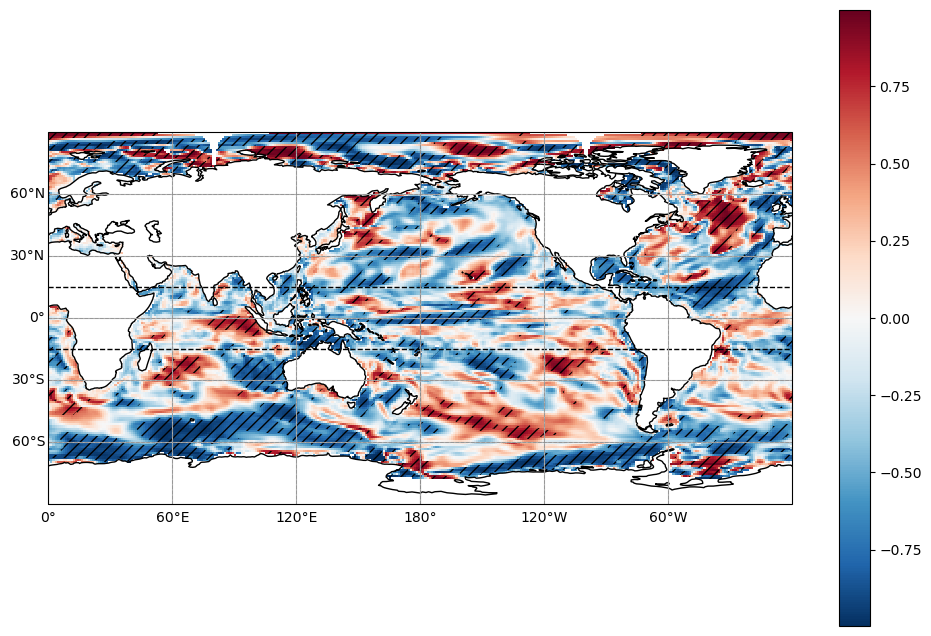

In [100]:
c = xs.pearson_r(bias_MC, bias_VCOC, dim="month")
p1 = xs.pearson_r_p_value(bias_MC, bias_VCOC, dim="month")
# Now plot figure
plt.figure(figsize = (12,8))
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
c.plot(ax = ax, transform=ccrs.PlateCarree(),
                              )
(p1.where(p1<0.05)).plot.contourf(ax = ax, levels=[0, 0.05],
                                  hatches=['///'], alpha = 0.0, add_colorbar=False, transform=ccrs.PlateCarree(),
                             )


ax.coastlines(color = 'k')
ax.axhline(y=-15, color='black', linestyle='--', linewidth=1)  # 15S
ax.axhline(y=15, color='black', linestyle='--', linewidth=1)
ax.gridlines()
#ax.set_facecolor('grey')
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False



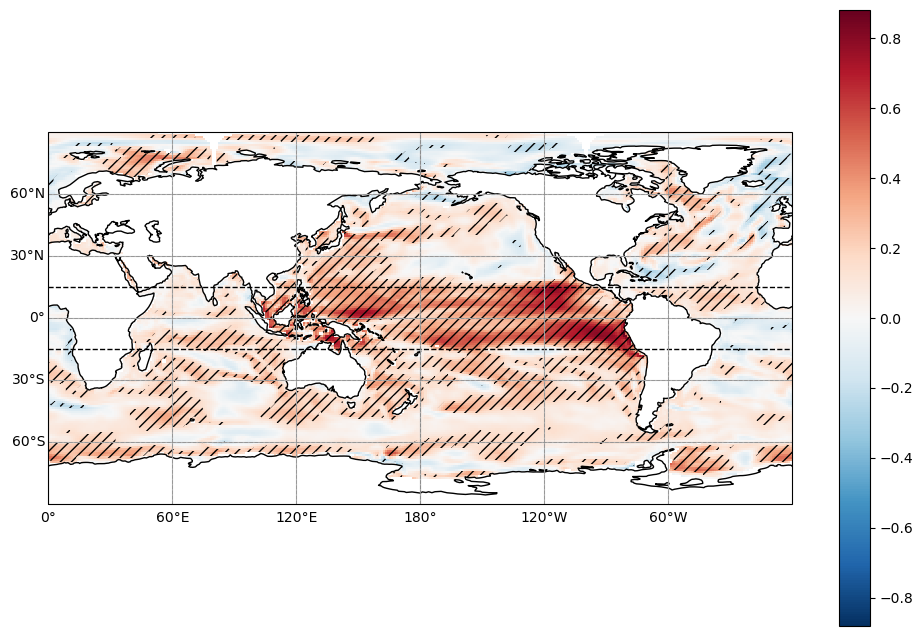

In [87]:
c = xs.pearson_r(bias_OC, bias_VC, dim="time")
p1 = xs.pearson_r_p_value(bias_OC, bias_VC, dim="time")
# Now plot figure
plt.figure(figsize = (12,8))
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
c.plot(ax = ax, transform=ccrs.PlateCarree(),
                              )
(p1.where(p1<0.05)).plot.contourf(ax = ax, levels=[0, 0.05],
                                  hatches=['///'], alpha = 0.0, add_colorbar=False, transform=ccrs.PlateCarree(),
                             )


ax.coastlines(color = 'k')
ax.axhline(y=-15, color='black', linestyle='--', linewidth=1)  # 15S
ax.axhline(y=15, color='black', linestyle='--', linewidth=1)
ax.gridlines()
#ax.set_facecolor('grey')
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False



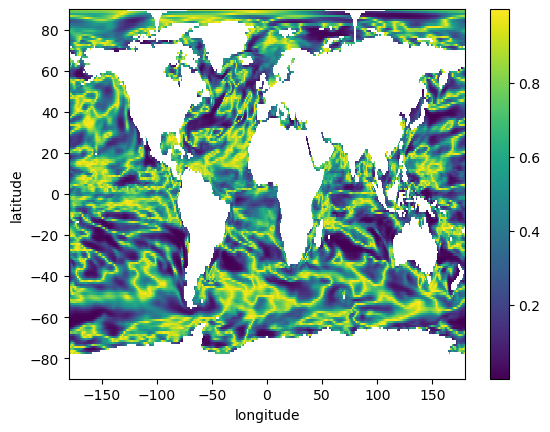

In [69]:
p2.plot()

In [38]:
from scipy.stats import pearsonr
def corrcoef_func(x, y):
    x, y = np.nan_to_num(x), np.nan_to_num(y)
    r,p =  pearsonr(x, y)
    return r,p
def calc_pearsonr(arr, index):
    corr_coef, pvals = np.apply_along_axis(corrcoef_func, axis=0, arr=arr, y=index)
    corr_coef = convert_to_da(corr_coef)
    pvals = convert_to_da(pvals)
    return corr_coef, pvals

In [57]:
corrcoef_func(bias_OC, bias_VC)

ValueError: shapes (50,180,360) and (50,180,360) not aligned: 360 (dim 2) != 180 (dim 1)

In [8]:
#lets look at winds

In [8]:
ctrl_u = xr.open_dataset(data_dir+"ctrl_uwnd.nc", use_cftime=True)

In [9]:
ctrl_u = regrid_ACCESS_u(ctrl_u, 'tauu')
ctrl_u = ctrl_u.compute()

In [10]:
ctrl_v = xr.open_dataset(data_dir+"ctrl_vwnd.nc", use_cftime=True)

In [11]:
ctrl_v = regrid_ACCESS_u(ctrl_v, 'tauv')
ctrl_v = ctrl_v.compute()

In [12]:
VC_u = xr.open_dataset(data_dir+"var_uwnd.nc", use_cftime=True)
VC_u = regrid_ACCESS_u(VC_u, 'tauu')
VC_u = VC_u.compute()

In [13]:
VC_v = xr.open_dataset(data_dir+"var_vwnd.nc", use_cftime=True)
VC_v = regrid_ACCESS_u(VC_v, 'tauv')
VC_v = VC_v.compute()

In [25]:
OC_u = xr.open_dataset(data_dir+"ob_uwnd.nc", use_cftime=True)
OC_u = regrid_ACCESS_u(OC_u, 'tauu')
OC_u = OC_u.compute()

In [26]:
OC_v = xr.open_dataset(data_dir+"ob_vwnd.nc", use_cftime=True)
OC_v = regrid_ACCESS_u(OC_v, 'tauv')
OC_v = OC_v.compute()

In [27]:
MC_v = xr.open_dataset(data_dir+"mod_vwnd.nc", use_cftime=True)
MC_v = regrid_ACCESS_u(MC_v, 'tauv')
MC_v = MC_v.compute()

In [28]:
MC_u = xr.open_dataset(data_dir+"mod_uwnd.nc", use_cftime=True)
MC_u = regrid_ACCESS_u(MC_u, 'tauu')
MC_u = MC_u.compute()

In [77]:
def plot_win_bias_clim(exp_u, exp_v, ref_u, ref_v):
    # calc climatologies
    # Ref dataset
    ref_str = np.sqrt(ref_u**2+ref_v**2)
    ref_u = ref_u.groupby('time.month').mean('time')
    ref_v = ref_v.groupby('time.month').mean('time')
    ref_spd = ref_str.groupby('time.month').mean('time')
    # Exp dataset
    exp_str = np.sqrt(exp_u**2+exp_v**2)
    exp_u = exp_u.groupby('time.month').mean('time')
    exp_v = exp_v.groupby('time.month').mean('time')
    exp_spd = exp_str.groupby('time.month').mean('time')  
    #Now get bias
    u_bias = exp_u - ref_u
    v_bias = exp_v - ref_v
    spd_bias = exp_spd - ref_spd
    
    
    fg = spd_bias.mean('month').plot.contourf(transform=ccrs.PlateCarree(),
                                 subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                                  figsize=(16,6), vmin = -0.12, vmax = 0.12, levels =14,  cmap = 'RdBu_r',#can do 11 or 21 levels
                                    cbar_kwargs=dict(label='wind speed N*m^-2'), extend = 'both')
    Q = plt.quiver(u_bias.longitude[::7].values, u_bias.latitude[::7].values, u_bias.mean('month')[::7,::7].values, 
                  v_bias.mean('month')[::7,::7].values, 
                      transform=ccrs.PlateCarree())
    qk = plt.quiverkey(Q, 1, 1.1, 0.05, r'$0.05 \frac{N}{m^2}$', labelpos='E',
                       coordinates='axes')
    return


In [57]:
def plot_win_bias(exp_u, exp_v, ref_u, ref_v):
    # calc climatologies
    # Ref dataset
    ref_str = np.sqrt(ref_u**2+ref_v**2)
    ref_u = ref_u.groupby('time.month').mean('time')
    ref_v = ref_v.groupby('time.month').mean('time')
    ref_spd = ref_str.groupby('time.month').mean('time')
    # Exp dataset
    exp_str = np.sqrt(exp_u**2+exp_v**2)
    exp_u = exp_u.groupby('time.month').mean('time')
    exp_v = exp_v.groupby('time.month').mean('time')
    exp_spd = exp_str.groupby('time.month').mean('time')  
    #Now get bias
    u_bias = exp_u - ref_u
    v_bias = exp_v - ref_v
    spd_bias = exp_spd - ref_spd
    
    
    fg = spd_bias.plot.contourf(col='month', col_wrap = 4,  transform=ccrs.PlateCarree(),
                                 subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180)}, 
                                  figsize=(16,6), vmin = -0.12, vmax = 0.12, levels =14,  cmap = 'RdBu_r',#can do 11 or 21 levels
                                    cbar_kwargs=dict(label='wind speed N*m^-2'), extend = 'both')
    #Add in features
    for i, ax in enumerate(fg.axs.flat):
        if i ==0:
            Q = ax.quiver(u_bias.longitude[::10].values, u_bias.latitude[::10].values, u_bias[i, ::10,::10].values, v_bias[i, ::10,::10].values, 
                      transform=ccrs.PlateCarree(),  width=0.002)
        else:
            ax.quiver(u_bias.longitude[::10].values, u_bias.latitude[::10].values, u_bias[i, ::10,::10].values, v_bias[i, ::10,::10].values, 
                      transform=ccrs.PlateCarree(),  width=0.002)
        #ax.coastlines()
        ax.set_facecolor('grey')
        gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                          linewidth=0.7, color='gray', alpha=0.5, linestyle='--')
        if i in [0,1,2,3,4,5,6,7]:
            gl.bottom_labels = False
        if i in [1,2,3,5,6,7,9,10,11]:
            gl.left_labels = False
        gl.top_labels = False
        gl.right_labels = False
        ax.set_xlim([-160,120])
        ax.set_ylim([-80, 80])
    #now add the month labels
    titles =['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun','Jul', 
             'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
    for ax,title in zip(fg.axes.flatten(),titles):
        ax.set_title(title )
    qk = ax.quiverkey(Q, 1, 1.1, 0.05, r'$0.05 \frac{N}{m^2}$', labelpos='E',
                       coordinates='axes')
    return


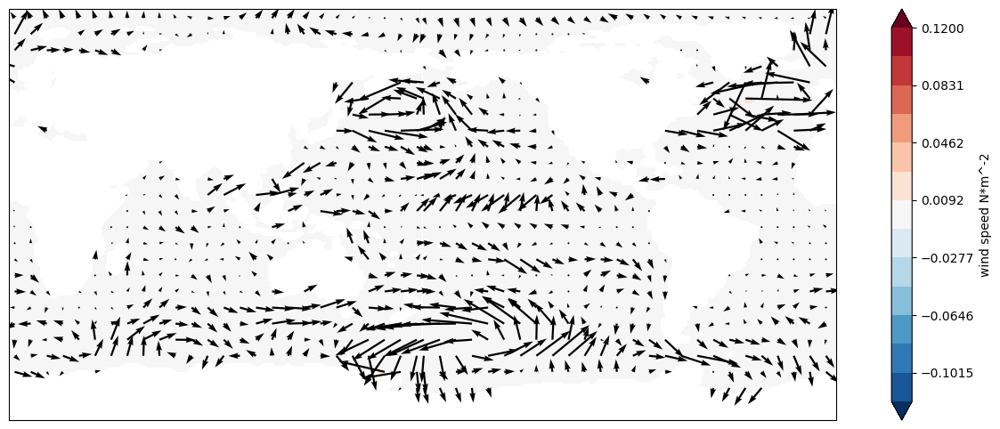

In [80]:
plot_win_bias_clim(MC_u, MC_v, ctrl_u, ctrl_v)

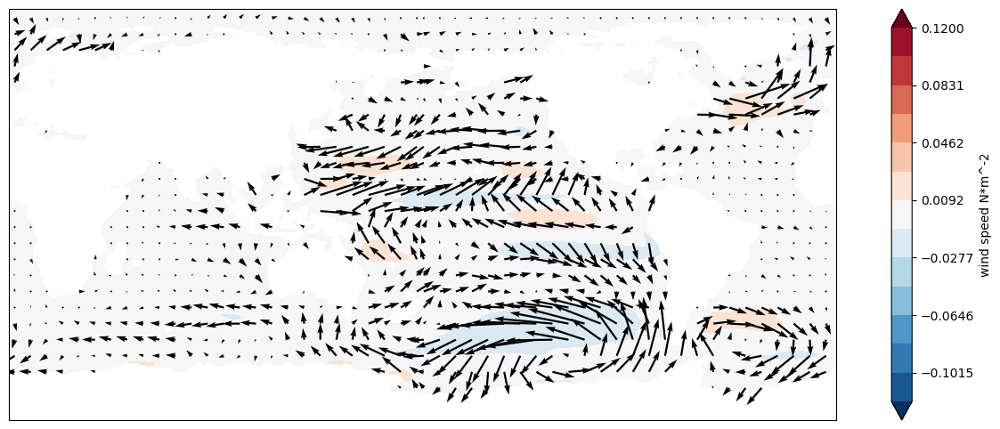

In [79]:
plot_win_bias_clim(VC_u, VC_v, ctrl_u, ctrl_v)

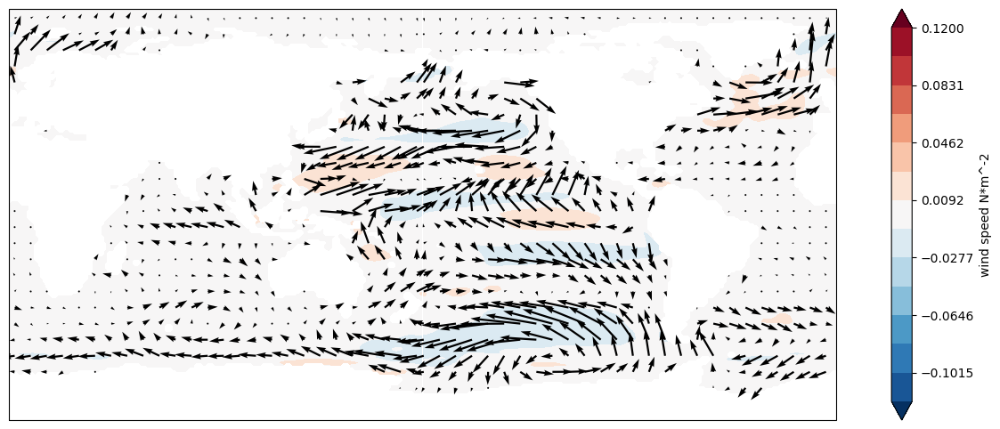

In [78]:
plot_win_bias_clim(OC_u, OC_v, ctrl_u, ctrl_v)

/jobfs/92468374.gadi-pbs/ipykernel_1107659/1640055601.py:46: DeprecationWarning: self.axes is deprecated since 2022.11 in order to align with matplotlibs plt.subplots, use self.axs instead.
  for ax,title in zip(fg.axes.flatten(),titles):


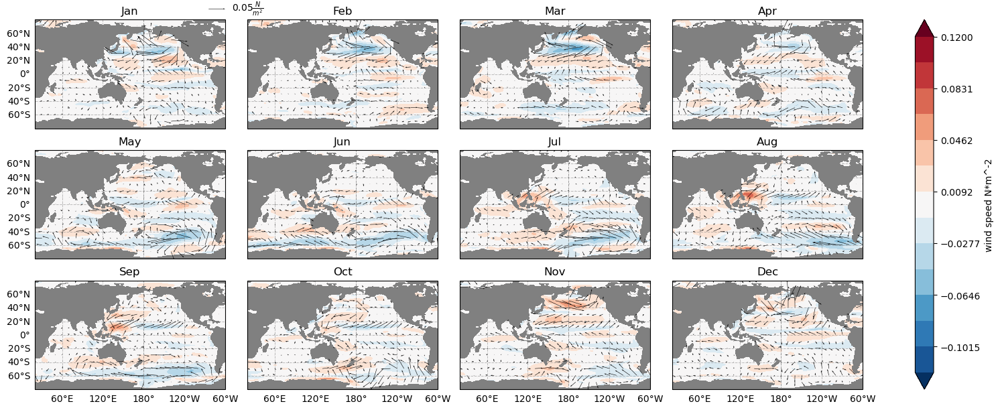

In [58]:
plot_win_bias(OC_u, OC_v, ctrl_u, ctrl_v)

/jobfs/92468374.gadi-pbs/ipykernel_1107659/2297292541.py:46: DeprecationWarning: self.axes is deprecated since 2022.11 in order to align with matplotlibs plt.subplots, use self.axs instead.
  for ax,title in zip(fg.axes.flatten(),titles):


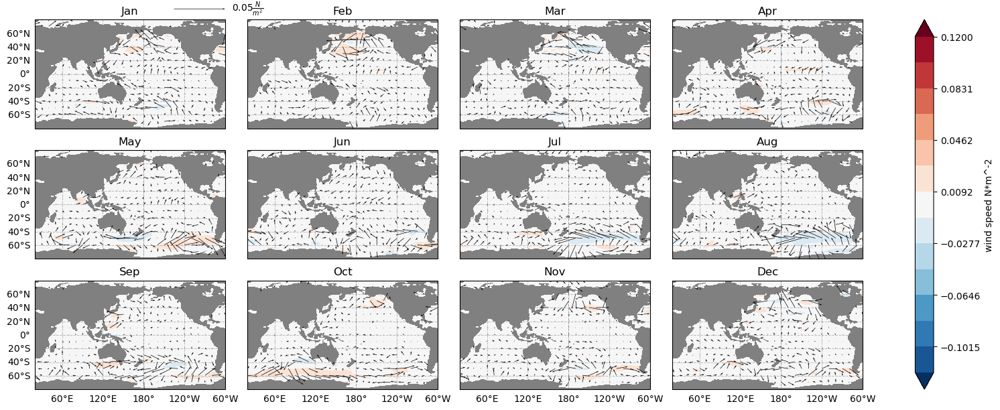

In [55]:
plot_win_bias(MC_u, MC_v, ctrl_u, ctrl_v)

/jobfs/92468374.gadi-pbs/ipykernel_1107659/2297292541.py:46: DeprecationWarning: self.axes is deprecated since 2022.11 in order to align with matplotlibs plt.subplots, use self.axs instead.
  for ax,title in zip(fg.axes.flatten(),titles):


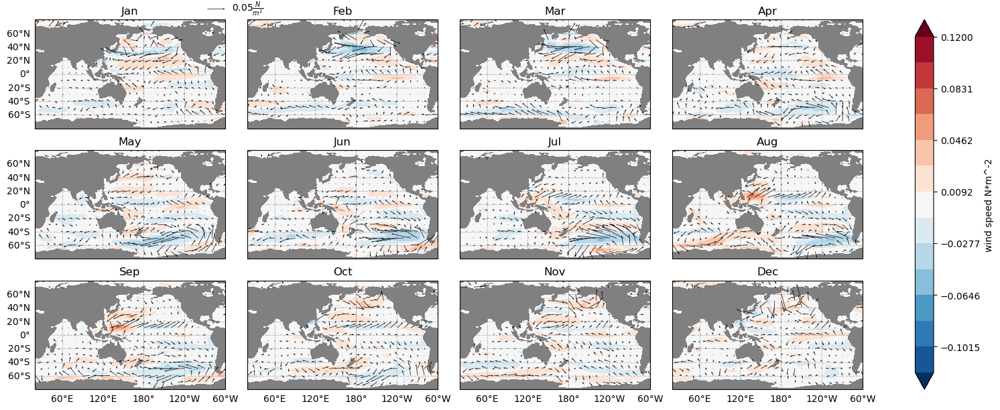

In [56]:
plot_win_bias(VC_u, VC_v, ctrl_u, ctrl_v)

In [14]:
w_str = np.sqrt(ctrl_u**2+ctrl_v**2)

In [15]:
#now plot. First create climatology
u = ctrl_u.groupby('time.month').mean('time')
v = ctrl_v.groupby('time.month').mean('time')
spd = w_str.groupby('time.month').mean('time')


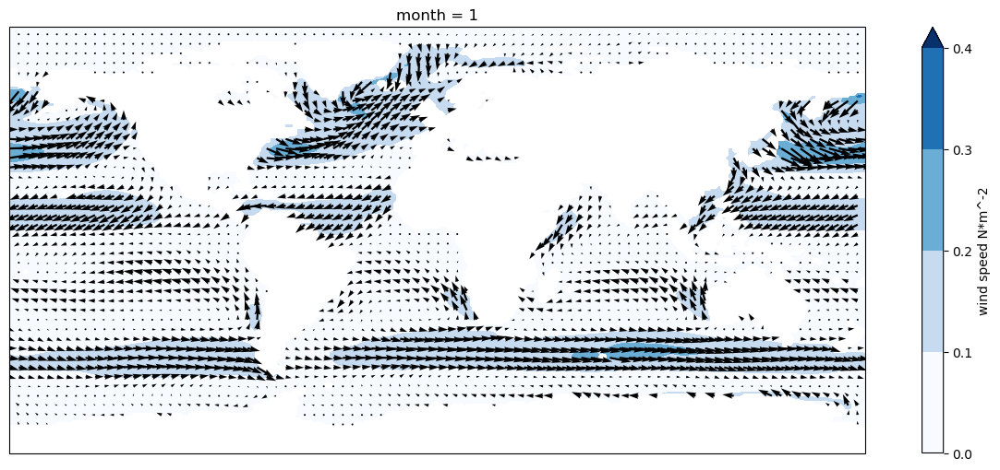

In [18]:
fg = spd[0].plot.contourf(transform=ccrs.PlateCarree(),
                             subplot_kws={"projection": ccrs.PlateCarree()}, 
                              figsize=(16,6), vmin = 0, vmax = 0.4, levels =5,  cmap = 'Blues',#can do 11 or 21 levels
                                cbar_kwargs=dict(label='wind speed N*m^-2'), extend = 'max')
#Add in features
plt.quiver(u.longitude[::4], u.latitude[::4], u[0,::4,::4].values, v[0,::4,::4].values, 
                      transform=ccrs.PlateCarree())



/jobfs/92468374.gadi-pbs/ipykernel_1107659/279566845.py:26: DeprecationWarning: self.axes is deprecated since 2022.11 in order to align with matplotlibs plt.subplots, use self.axs instead.
  for ax,title in zip(fg.axes.flatten(),titles):


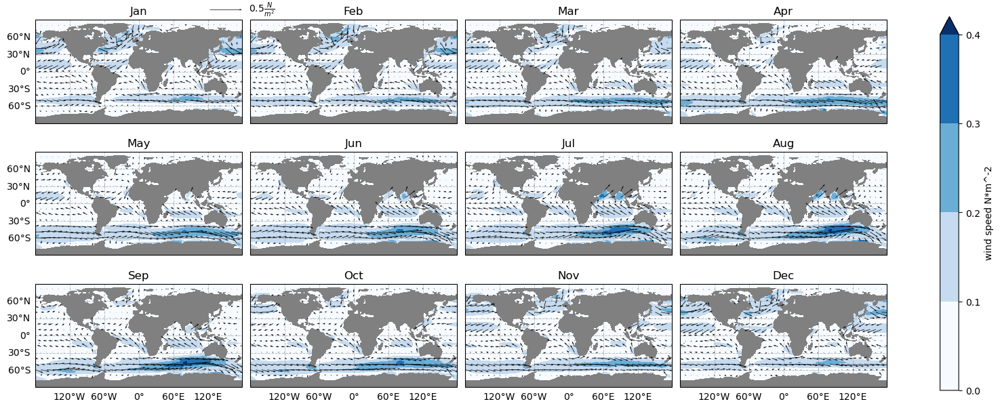

In [20]:
fg = spd.plot.contourf(col='month', col_wrap = 4,  transform=ccrs.PlateCarree(),
                             subplot_kws={"projection": ccrs.PlateCarree()}, 
                              figsize=(16,6), vmin = 0, vmax = 0.4, levels =5,  cmap = 'Blues',#can do 11 or 21 levels
                                cbar_kwargs=dict(label='wind speed N*m^-2'), extend = 'max')
#Add in features
for i, ax in enumerate(fg.axs.flat):
    if i ==0:
        Q = ax.quiver(u.longitude[::10], u.latitude[::10], u[i, ::10,::10], v[i, ::10,::10], 
                  transform=ccrs.PlateCarree())
    else:
        ax.quiver(u.longitude[::10], u.latitude[::10], u[i, ::10,::10], v[i, ::10,::10], 
                  transform=ccrs.PlateCarree())
    #ax.coastlines()
    ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')
    if i in [0,1,2,3,4,5,6,7]:
        gl.bottom_labels = False
    if i in [1,2,3,5,6,7,9,10,11]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False
#now add the month labels
titles =['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun','Jul', 
         'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
for ax,title in zip(fg.axes.flatten(),titles):
    ax.set_title(title )
qk = ax.quiverkey(Q, 1, 1.1, 0.5, r'$0.5 \frac{N}{m^2}$', labelpos='E',
                   coordinates='axes')

In [16]:
#lets loko at hivmoller of  z20 in IO

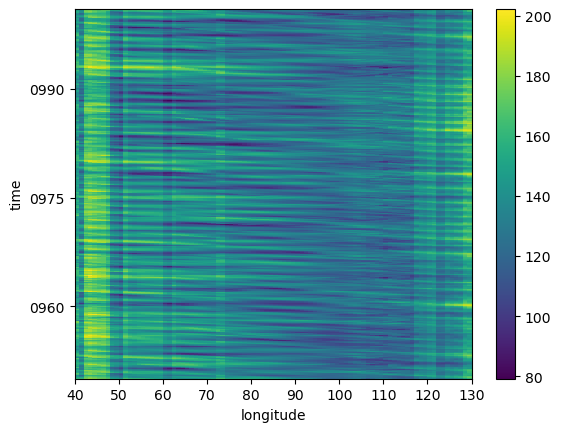

In [23]:
ctrl_z20.sel(latitude = slice(-15,-5)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0950-01-01', '1000-12-31')).plot()

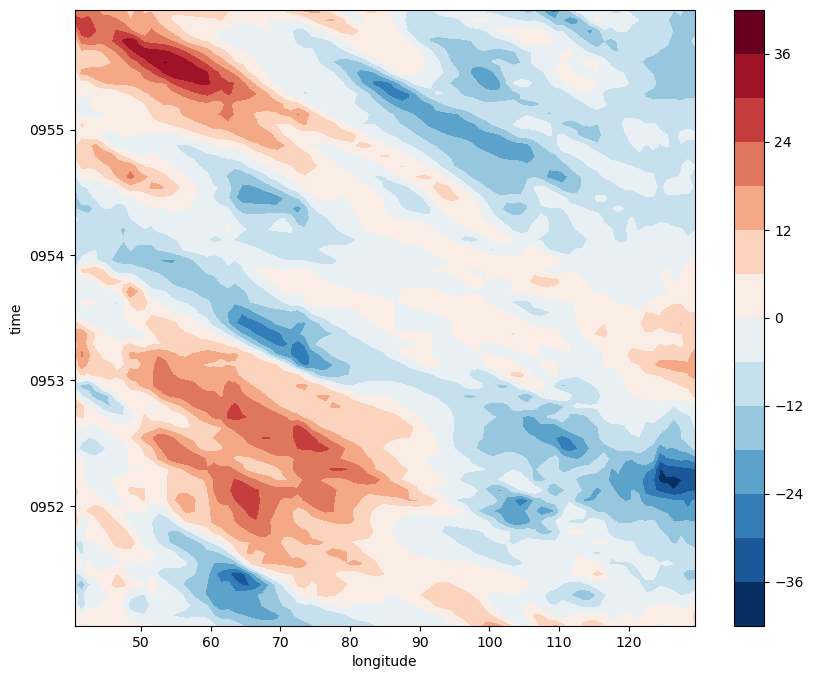

In [72]:
#plot the hovmller z20 anomaly
plt.figure(figsize = (10,8))
(ctrl_z20.groupby('time.month')-ctrl_z20.groupby('time.month').mean('time')).sel(latitude = slice(-15,-5)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0951-01-01', '0955-12-31')).plot.contourf(levels = 15)


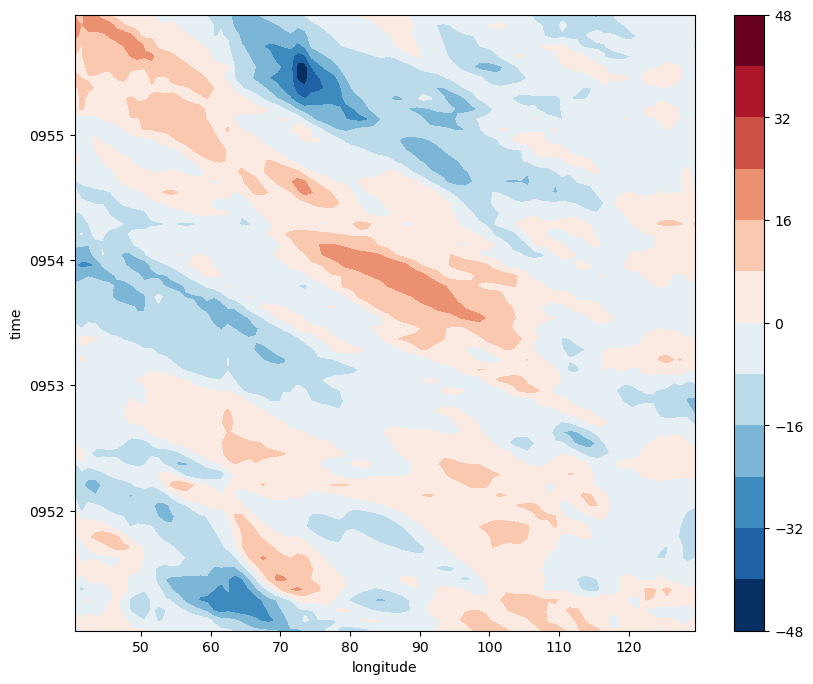

In [71]:
#plot the hovmller z20 anomaly
plt.figure(figsize = (10,8))
(MC_z20.groupby('time.month')-ctrl_z20.groupby('time.month').mean('time')).sel(latitude = slice(-15,-5)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0950-01-01', '0955-12-31')).plot.contourf(levels = 15)


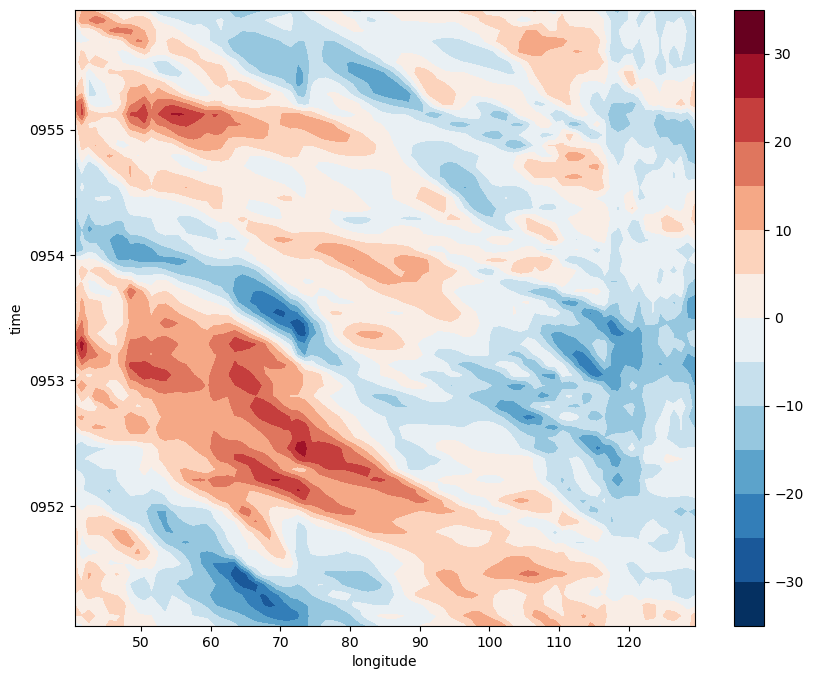

In [70]:
#plot the hovmller z20 anomaly
plt.figure(figsize = (10,8))
(OC_z20.groupby('time.month')-ctrl_z20.groupby('time.month').mean('time')).sel(latitude = slice(-15,-5)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0950-01-01', '0955-12-31')).plot.contourf(levels = 15)

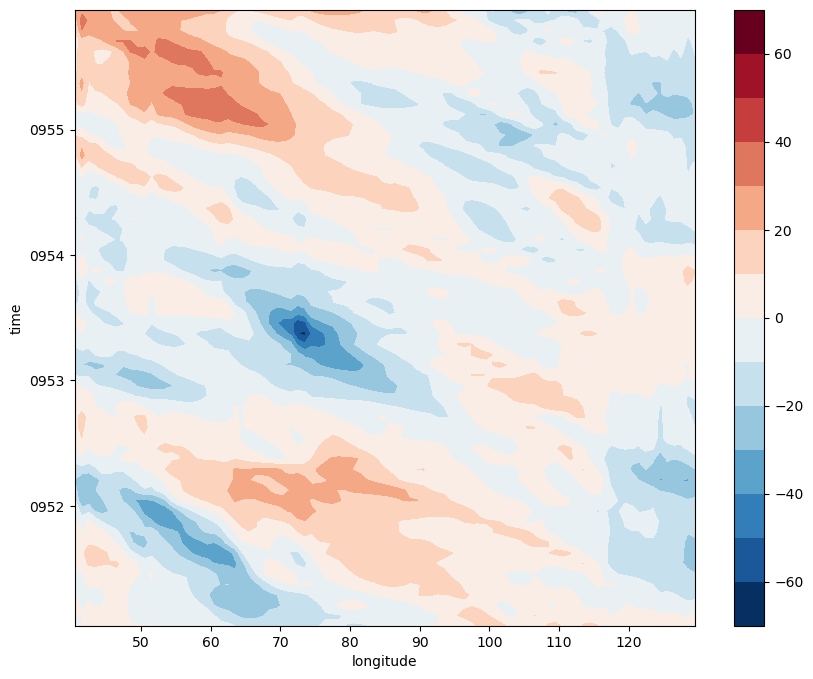

In [68]:
#plot the hovmller z20 anomaly
plt.figure(figsize = (10,8))
(VC_z20.groupby('time.month')-ctrl_z20.groupby('time.month').mean('time')).sel(latitude = slice(-15,-5)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0950-01-01', '0955-12-31')).plot.contourf(levels = 15)

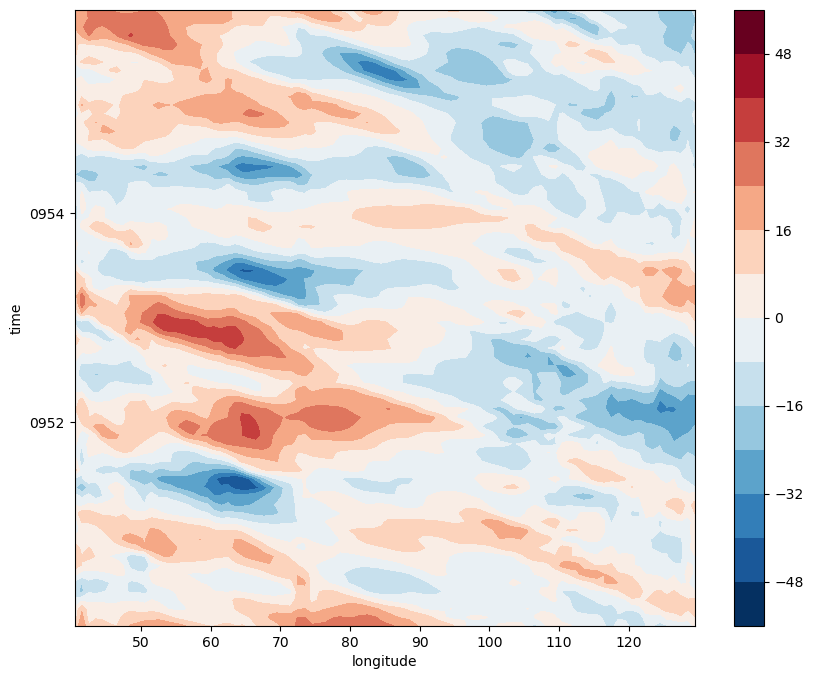

In [69]:
#plot the hovmller z20 anomaly
plt.figure(figsize = (10,8))
(ctrl_z20-ctrl_z20.mean('time')).sel(latitude = slice(-15,-5)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0950-01-01', '0955-12-31')).plot.contourf(levels = 15)


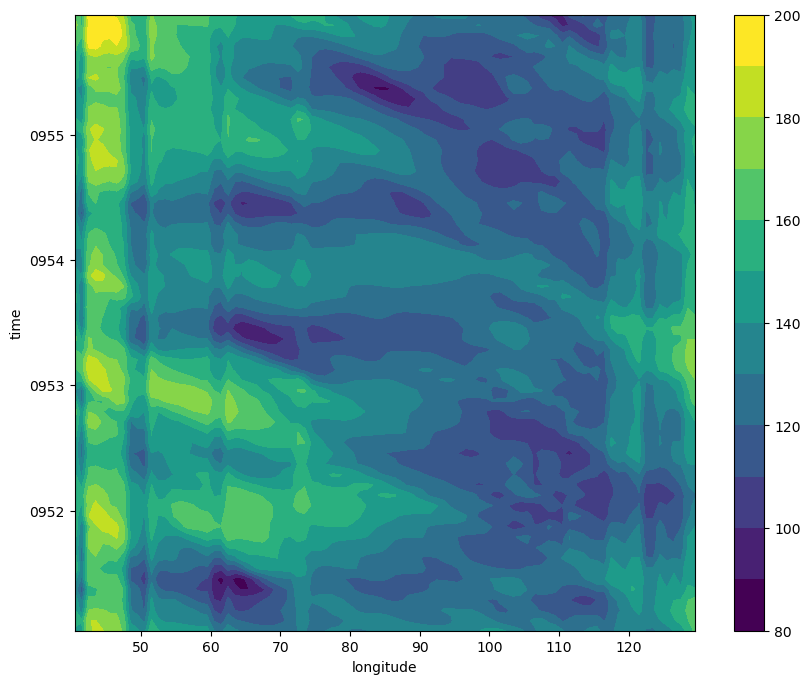

In [43]:
plt.figure(figsize = (10,8))
ctrl_z20.sel(latitude = slice(-15,-5)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0951-01-01', '0955-12-31')).plot.contourf(levels = 15)

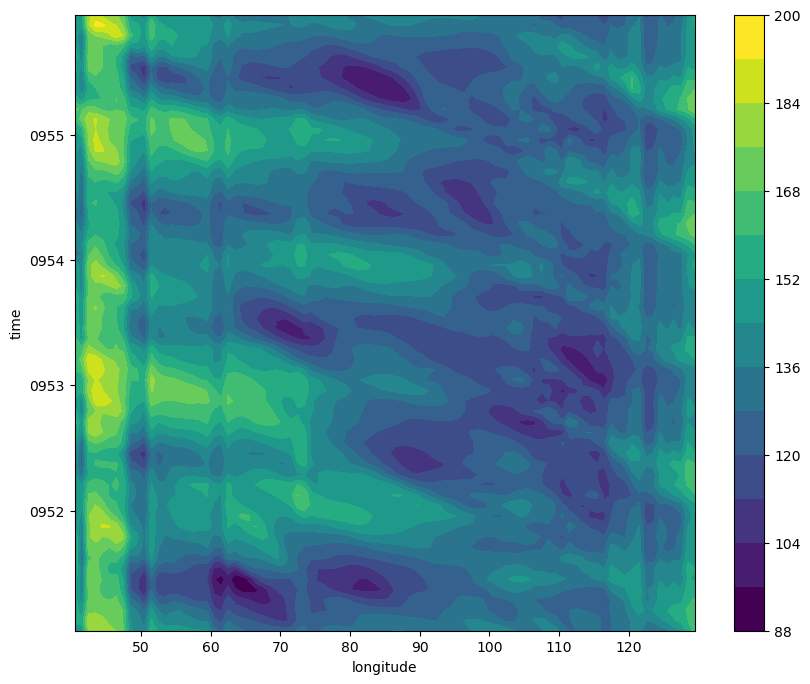

In [37]:
plt.figure(figsize = (10,8))
OC_z20.sel(latitude = slice(-15,-5)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0950-01-01', '0955-12-31')).plot.contourf(levels = 15)

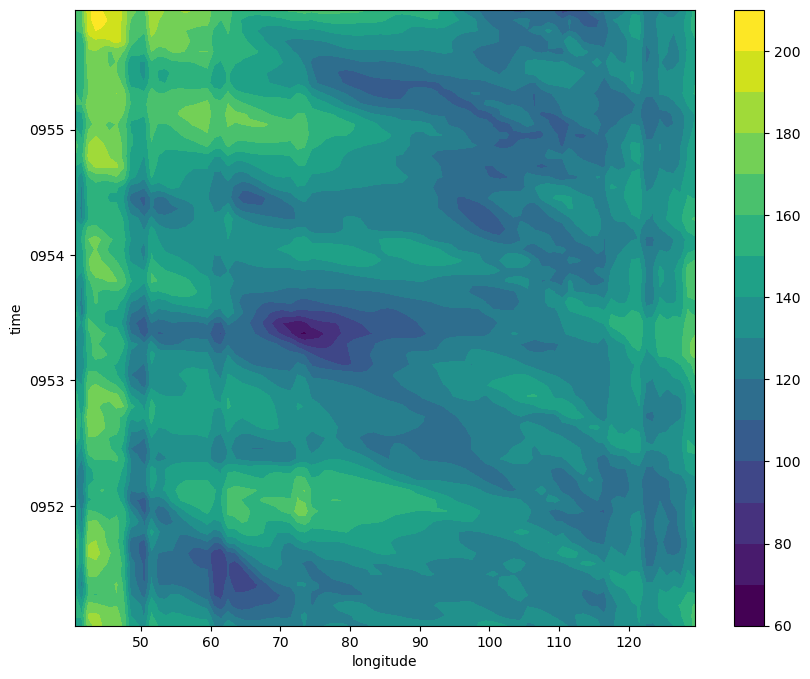

In [38]:
plt.figure(figsize = (10,8))
VC_z20.sel(latitude = slice(-15,-5)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0950-01-01', '0955-12-31')).plot.contourf(levels = 15)

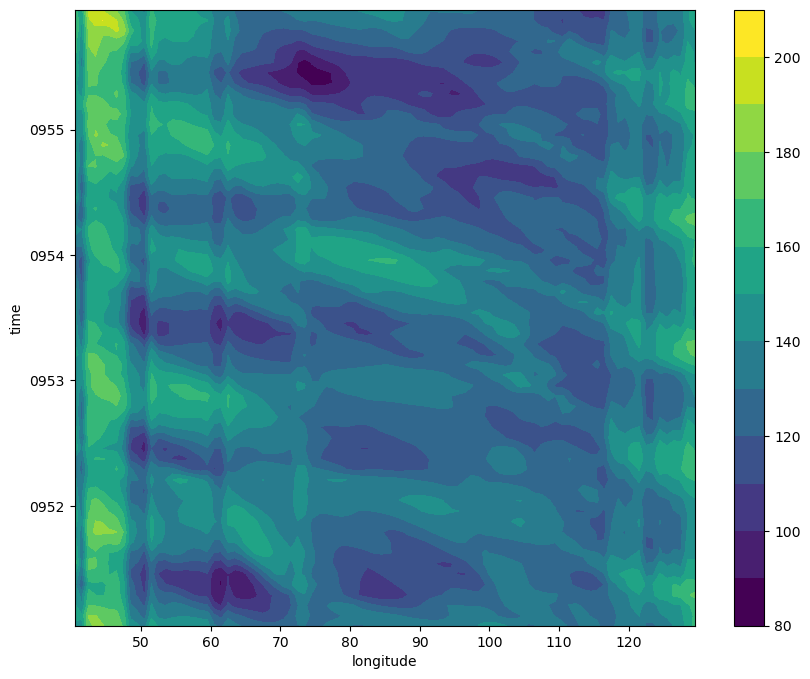

In [39]:
plt.figure(figsize = (10,8))
MC_z20.sel(latitude = slice(-15,-5)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0950-01-01', '0955-12-31')).plot.contourf(levels = 15)

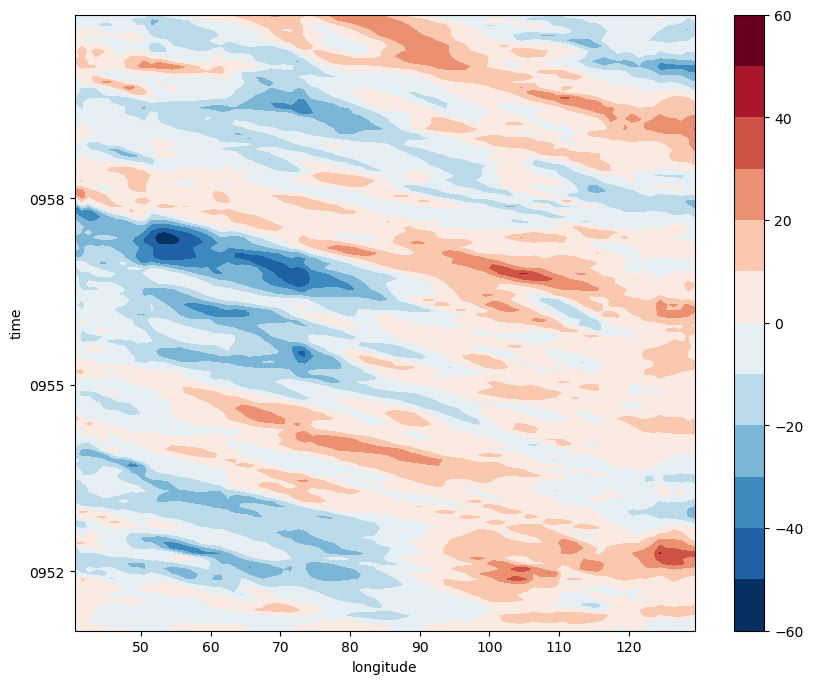

In [33]:
plt.figure(figsize = (10,8))
(MC_z20-ctrl_z20).sel(latitude = slice(-15,-5)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0950-01-01', '0960-12-31')).plot.contourf(levels = 15)

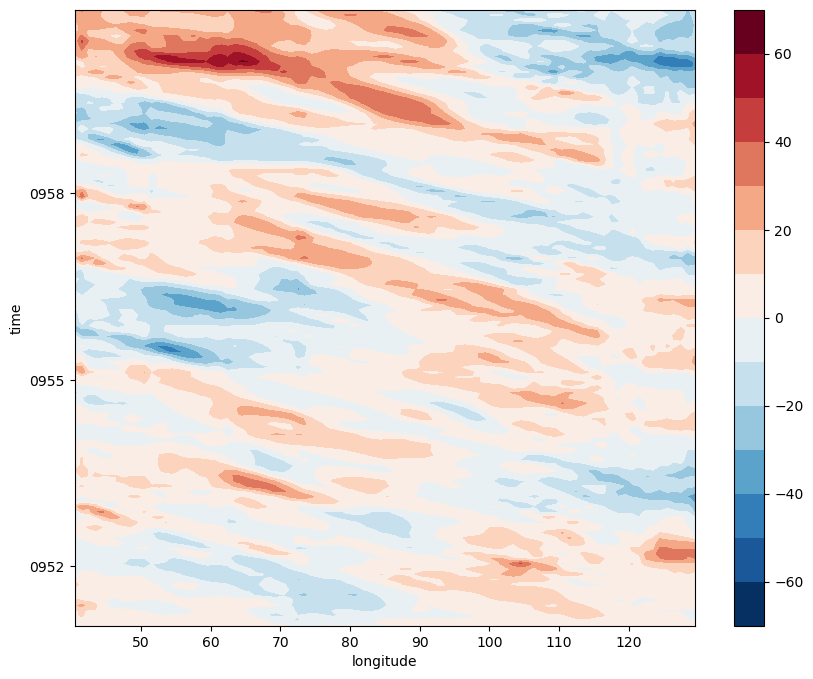

In [34]:
plt.figure(figsize = (10,8))
(OC_z20-ctrl_z20).sel(latitude = slice(-15,-5)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0950-01-01', '0960-12-31')).plot.contourf(levels = 15)

In [33]:
#get an index to calcualte the IOB
def ssta(DS):
    clim = DS.groupby('time.month').mean('time')
    ssta = DS.groupby('time.month') - clim
    return ssta
def NINO34(DS):
     return ssta(DS).sel(latitude=slice(-5, 5),longitude=slice(-170, -120)).mean(['latitude', 'longitude'])
     
def IOBM(DS):
    return ssta(DS).sel(latitude=slice(-20, 20),longitude=slice(40, 100)).mean(['latitude', 'longitude'])
def NINO34(DS):
    return ssta(DS).sel(latitude=slice(-5, 5),longitude=slice(-170, -120)).mean(['latitude', 'longitude'])
#calculate the DMI
def dmi(DS):
    WTIO = ssta(DS).sel(latitude=slice(-10, 10),longitude=slice(50, 70)).mean(['latitude', 'longitude'])
    SETIO = ssta(DS).sel(latitude=slice(-10, 0),longitude=slice(90, 110)).mean(['latitude', 'longitude'])
    return (WTIO-SETIO).drop('month')
def eio(DS):
    SETIO = ssta(DS).sel(latitude=slice(-10, 0),longitude=slice(90, 110)).mean(['latitude', 'longitude'])
    return (SETIO).drop('month')
def eio_1(DS):
    SETIO = (DS).sel(latitude=slice(-10, 0),longitude=slice(90, 110)).mean(['latitude', 'longitude'])
    return (SETIO)
def wio(DS):
    WTIO = ssta(DS).sel(latitude=slice(-10, 10),longitude=slice(50, 70)).mean(['latitude', 'longitude'])
    return (WTIO).drop('month')
def wio_1(DS):
    WTIO = (DS).sel(latitude=slice(-10, 10),longitude=slice(50, 70)).mean(['latitude', 'longitude'])
    return (WTIO)

In [32]:
#look at skewness in the experiemnts:
from scipy.stats import skew

In [36]:
print(skew(dmi(ctrl)))
print(skew(dmi(MC)))
print(skew(dmi(OC)))
print(skew(dmi(VC)))

0.4458509369547753
0.16600106146378668
0.19294976333275707
0.5808819873966029


In [37]:
print(skew(eio(ctrl)))
print(skew(eio(MC)))
print(skew(eio(OC)))
print(skew(eio(VC)))


-0.4489514928770049
-0.48960771781849977
-0.023182984180519003
-0.4279631106103355


In [38]:
print(skew(wio(ctrl)))
print(skew(wio(MC)))
print(skew(wio(OC)))
print(skew(wio(VC)))


-0.1348065302701683
-0.08523404329072692
0.021355090312527775
-0.11619601359179317


In [39]:
print(skew(eio_1(ctrl)))
print(skew(eio_1(MC)))
print(skew(eio_1(OC)))
print(skew(eio_1(VC)))


-0.31762659887569467
-0.3172026870612432
-0.3076357571282432
-0.4375930861104339


In [ ]:
#get the top 25% of IOD events
def DMI_

In [75]:
dmi(OC).resample(time='QS-DEC').mean(dim="time")

<xarray.DataArray (time: 201)>
array([ 0.1127227 ,  0.04567761, -0.5384017 , -0.5717929 , -0.11138853,
        0.02520378,  0.23610704,  0.24027814,  0.13249488,  0.04642664,
       -0.63543373, -0.298522  , -0.16543251,  0.19692451, -0.4054998 ,
       -0.248748  ,  0.21685685, -0.29089367, -0.46306792, -0.819135  ,
       -0.63435227, -0.11255684, -0.23573168,  0.04409559,  0.347154  ,
        0.04356685,  0.1329409 , -0.37717113, -0.4139513 ,  0.21373017,
       -0.49248984, -0.25342473, -0.29987082, -0.03865894,  0.32868457,
        0.3603737 ,  0.0558485 ,  0.25454706,  1.0079381 ,  0.12640195,
        0.09957216,  0.01615389,  0.30875188,  0.44337258,  0.26249516,
        0.37819266,  0.5797552 ,  0.5787402 ,  0.8718291 ,  0.39871132,
        0.45272455,  0.5869656 , -0.05071264, -0.09064841, -0.3198971 ,
       -0.13702606,  0.21575372, -0.22538881, -0.17097652, -0.12830745,
        0.28313836,  0.22461818, -0.12476829,  0.15339722,  0.06274261,
       -0.00191009,  0.00610925, -0.24581726,  0.0341442 ,  0.03124977,
        0.2402461 ,  0.32072932,  0.13839242,  0.01867428, -0.19606477,
       -0.2809933 ,  0.02884384, -0.10380012, -0.4059546 , -0.6654495 ,
       -0.32649297,  0.05297247,  0.10361914,  0.28728035, -0.37414214,
       -0.34330693, -0.1881475 , -0.05285474, -0.08789653, -0.46276927,
        0.31249136,  0.37577358,  0.27945837,  0.533037  ,  0.42757523,
        0.3381761 ,  0.09420258,  0.3262808 , -0.00225958, -0.44667122,
...
        0.09611311, -0.262068  , -0.00950748, -0.14450404, -0.07010321,
       -0.21457748,  0.22522868,  0.054821  , -0.10130624,  0.04472792,
        0.03448604, -0.07069308, -0.3007629 , -0.31336468, -0.43246904,
       -0.34439182, -0.14645617, -0.48005927, -0.29204357, -0.03962862,
       -0.1515574 ,  0.16121593,  0.193639  , -0.13079941, -0.01423431,
        0.08089257,  0.00444308, -0.45124424, -0.42044783,  0.09946322,
       -0.05882195, -0.00783024, -0.11966632, -0.42717275, -0.22892565,
       -0.04851048, -0.07687119,  0.609363  ,  0.90044206,  0.5406019 ,
        0.26382005,  0.39440334,  0.17989536,  0.16570856, -0.02610922,
        0.32691526,  0.33182648,  0.2525707 ,  0.12521142, -0.06744578,
       -0.15842873,  0.05906927, -0.04355581,  0.02796587,  0.25605035,
        0.23900205, -0.07226443, -0.5976494 , -0.39391068, -0.27219245,
       -0.03508168,  0.77794665,  0.5060156 ,  0.53479487, -0.44057646,
        0.03733138, -0.09959016,  0.00488849,  0.15662861,  0.04671103,
        0.60410947,  0.40201446,  0.23588075,  0.2733746 ,  0.02525309,
       -0.02963113, -0.2445503 ,  0.05922648,  0.34396145, -0.02746235,
        0.4198276 ,  0.31605503,  0.24581976,  0.01709087,  0.02212312,
       -0.56980044, -0.7500518 , -0.26486608,  0.02698031, -0.27690727,
       -0.45390496, -0.41268826, -0.04476799,  0.01892454, -0.13785829,
       -0.384501  ], dtype=float32)
Coordinates:
  * time     (time) object 0950-12-01 00:00:00 ... 1000-12-01 00:00:00

In [34]:
def IOD_events(ds):
    #get the DMI timeseries in seaaons starting D(0)JF(1) etc
    QS = dmi(ds).resample(time='QS-DEC').mean(dim="time")
    #select SON seasons into a timeseries
    SON = QS.groupby('time.season')["SON"]
    #now use this to select all events and create da's of niod and piod event values
    lower,upper = SON.quantile([0.25, 0.75])
    nIOD = SON.where(SON <= lower.values).dropna(dim = "time")
    pIOD = SON.where(SON > upper.values).dropna(dim = "time")
    return nIOD, pIOD

In [35]:
def get_IOD_times(ds_sst, ds_var, fn):
    nIOD, pIOD = IOD_events(ds_sst)
    #now get the times where the variable is in SON
    SON_var = fn(ds_var).resample(time='QS-DEC').mean(dim="time").groupby('time.season')["SON"]
    #Now use nIOd and PIOD to get the times that we want
    nIOD_var = SON_var.where(SON_var.time == nIOD.time).dropna(dim = "time")
    pIOD_var = SON_var.where(SON_var.time == pIOD.time).dropna(dim = "time")
    return nIOD_var, pIOD_var

In [36]:
nI_ctrl, pI_ctrl = get_IOD_times(ctrl, ctrl_z20, eio)


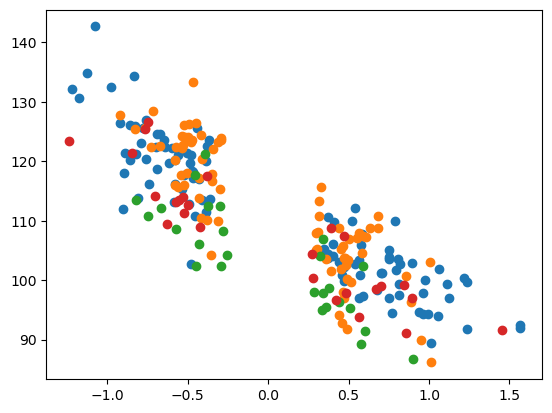

In [39]:
#get the different IOD strengths and lookat relationship to z20
nI_ctrl, pI_ctrl = IOD_events(ctrl)
nI_MC, pI_MC = IOD_events(MC)
nI_OC, pI_OC = IOD_events(OC)
nI_VC, pI_VC = IOD_events(VC)

nI_ctrl_z20, pI_ctrl_z20 = get_IOD_times(ctrl, ctrl_z20, eio_depth)
nI_MC_z20, pI_MC_z20 = get_IOD_times(MC, MC_z20, eio_depth)
nI_OC_z20, pI_OC_z20 = get_IOD_times(OC, OC_z20, eio_depth)
nI_VC_z20, pI_VC_z20 = get_IOD_times(VC, VC_z20, eio_depth)
#now plot these:

plt.figure()
plt.scatter(pI_ctrl, pI_ctrl_z20, c = "tab:blue")
plt.scatter(pI_MC, pI_MC_z20, c = "tab:orange")
plt.scatter(pI_OC, pI_OC_z20, c = "tab:green")
plt.scatter(pI_VC, pI_VC_z20, c = "tab:red")

plt.scatter(nI_ctrl, nI_ctrl_z20, c = "tab:blue")
plt.scatter(nI_MC, nI_MC_z20, c = "tab:orange")
plt.scatter(nI_OC, nI_OC_z20, c = "tab:green")
plt.scatter(nI_VC, nI_VC_z20, c = "tab:red")


In [41]:
ds = OC
vertex1 = {'longitude': 90, 'latitude': -10}  # Bottom left corner
vertex2 = {'longitude': 90, 'latitude': 10}   # Top left corner
vertex3 = {'longitude': 100, 'latitude': -10} # Bottom right corner

# Create boolean masks for each vertex
mask_vertex1 = (ds['longitude'] == vertex1['longitude']) & (ds['latitude'] == vertex1['latitude'])
mask_vertex2 = (ds['longitude'] == vertex2['longitude']) & (ds['latitude'] == vertex2['latitude'])
mask_vertex3 = (ds['longitude'] == vertex3['longitude']) & (ds['latitude'] == vertex3['latitude'])

# Combine the masks to create a mask for the entire triangle
triangle_mask = mask_vertex1 | mask_vertex2 | mask_vertex3

# Use the mask to select the desired area in the dataset
selected_area = ds.where(triangle_mask, drop=True)

In [43]:
selected_area[0].plot()

TypeError: No numeric data to plot.

In [101]:
nI, pI = IOD_events(ctrl)
pI.median(), nI.median()

(<xarray.DataArray ()>
 array(0.75055099),
 <xarray.DataArray ()>
 array(-0.63919109))

In [102]:
nI, pI = IOD_events(MC)
pI.median(), nI.median()

(<xarray.DataArray ()>
 array(0.47944796),
 <xarray.DataArray ()>
 array(-0.49253234))

In [103]:
nI, pI = IOD_events(OC)
pI.mean(), nI.mean()

(<xarray.DataArray ()>
 array(0.4598282, dtype=float32),
 <xarray.DataArray ()>
 array(-0.46427235, dtype=float32))

In [104]:
nI, pI = IOD_events(VC)
pI.mean(), nI.mean()

(<xarray.DataArray ()>
 array(0.6394419, dtype=float32),
 <xarray.DataArray ()>
 array(-0.6479183, dtype=float32))

In [55]:
test = dmi(ctrl).resample(time='QS-DEC').mean('time').groupby('time.season')["SON"]

In [62]:
lower,upper = test.quantile([0.25, 0.75])

In [69]:
test.where(test<=lower.values).dropna(dim = "time")

<xarray.DataArray (time: 51)>
array([-0.47126922, -0.53818494, -0.899978  , -0.38576975, -0.69010276,
       -0.46464598, -0.47025976, -0.5827934 , -0.8274402 , -0.4919921 ,
       -0.6452466 , -0.4278721 , -0.76265913, -0.6391911 , -0.6888261 ,
       -0.38759223, -0.78883225, -0.36534944, -0.6992926 , -0.6707694 ,
       -0.45574376, -0.80658484, -0.97591454, -0.85762435, -0.86128443,
       -0.4837788 , -0.7413476 , -0.76247567, -0.50604135, -0.61822623,
       -0.4792426 , -0.41213608, -0.88935304, -0.56278265, -0.52460593,
       -0.37895036, -1.2208241 , -0.5953091 , -0.5784064 , -1.1791917 ,
       -0.9230883 , -0.89791036, -0.47949505, -1.1278337 , -1.0778048 ,
       -0.36258507, -0.8190868 , -0.78105766, -0.83189744, -0.57680064,
       -0.4398484 ], dtype=float32)
Coordinates:
  * time     (time) object 0959-09-01 00:00:00 ... 1149-09-01 00:00:00

In [71]:
OC

<xarray.DataArray (time: 600, latitude: 180, longitude: 360)>
array([[[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [-1.7486761, -1.7486314, -1.7485867, ..., -1.7488128,
         -1.7487655, -1.7487209],
        [-1.7451661, -1.7451391, -1.7451093, ..., -1.74523  ,
         -1.7452114, -1.74519  ],
        [-1.7409573, -1.7409884, -1.7410188, ..., -1.7408606,
         -1.7408934, -1.7409256]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
...
        [-1.6950432, -1.6951823, -1.6953224, ..., -1.6945859,
         -1.6947668, -1.6949048],
        [-1.6894035, -1.6896987, -1.6899902, ..., -1.6884972,
         -1.6888026, -1.6891048],
        [-1.6832685, -1.6833696, -1.6834699, ..., -1.6829615,
         -1.6830645, -1.6831669]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [-1.704078 , -1.704272 , -1.7044673, ..., -1.7034565,
         -1.7036923, -1.7038848],
        [-1.6985925, -1.6989089, -1.699223 , ..., -1.69763  ,
         -1.6979531, -1.6982739],
        [-1.6907047, -1.6908245, -1.690943 , ..., -1.6903378,
         -1.6904613, -1.6905837]]], dtype=float32)
Coordinates:
  * time       (time) object 0951-01-16 12:00:00 ... 1000-12-15 12:00:00
  * longitude  (longitude) float64 -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
  * latitude   (latitude) float64 -89.5 -88.5 -87.5 -86.5 ... 87.5 88.5 89.5
Attributes:
    regrid_method:  bilinear

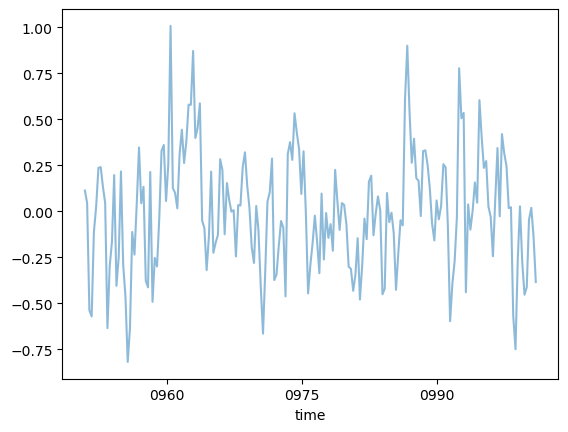

In [74]:
#dmi(OC).groupby('time.season')['SON'].groupby('time.year').mean('time').plot()
dmi(OC).resample(time='QS-DEC').mean(dim="time").plot(alpha = 0.5)
#dmi(OC).plot(alpha = 0.2)

In [53]:
iod_threshold = np.percentile(dmi(OC), 0.)

In [54]:
iod_threshold

-0.8867872765660286

In [63]:
iod_events = dmi(OC).where(abs(dmi(OC))> abs(iod_threshold), drop=True)

In [68]:
iod_events

<xarray.DataArray (time: 18)>
array([-0.8867741 , -0.8503454 , -1.0264585 , -0.8894049 , -0.81219983,
        1.2851093 ,  1.1250222 ,  1.2461001 ,  0.95434535, -0.84615177,
        0.832868  ,  1.0200219 ,  0.9037069 , -0.9310566 ,  0.90783775,
        0.8933586 ,  0.8628875 , -0.8158417 ], dtype=float32)
Coordinates:
  * time     (time) object 0954-08-16 12:00:00 ... 0998-09-16 00:00:00

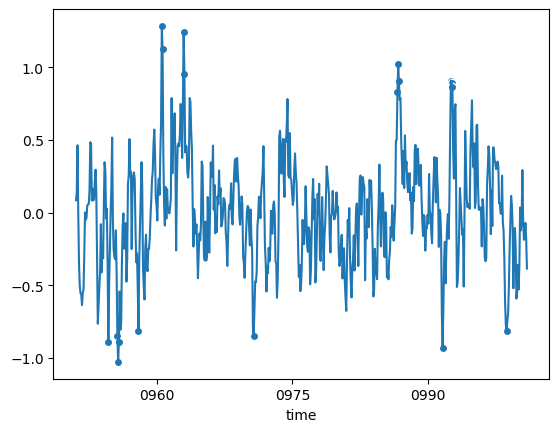

In [67]:
dmi(OC).plot()
iod_events.plot.scatter()

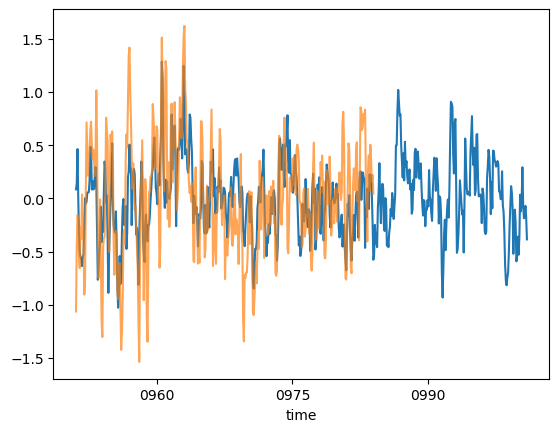

In [81]:
dmi(OC).plot()
(dmi(OC_z20)*0.05).plot(alpha = 0.7)

In [40]:
from scipy.stats import pearsonr

In [ ]:
ctrl

In [94]:
pearsonr(dmi(ctrl), dmi(ctrl_z20.sel(time = slice('0950-01-01', '1150-12-31'))))

PearsonRResult(statistic=0.6049884677130272, pvalue=8.654977440987598e-241)

In [34]:
def dmi_slope(DS):
    WTIO = (DS).sel(latitude=slice(-10, 10),longitude=slice(50, 70)).mean(['latitude', 'longitude'])
    SETIO = (DS).sel(latitude=slice(-10, 0),longitude=slice(90, 110)).mean(['latitude', 'longitude'])
    return (WTIO-SETIO)
def eio_depth(DS):
    SETIO = (DS).sel(latitude=slice(-10, 0),longitude=slice(90, 110)).mean(['latitude', 'longitude'])
    return (SETIO)
def wio_depth(DS):
    WTIO = (DS).sel(latitude=slice(-10, 10),longitude=slice(50, 70)).mean(['latitude', 'longitude'])
    return (WTIO)

In [ ]:
dmi_slope(ctrl).plot

In [35]:
from scipy.stats import ttest_ind, mannwhitneyu

In [44]:
print(wio_depth(ctrl_z20).mean('time').values)
print(wio_depth(MC_z20).mean('time').values)
print(wio_depth(OC_z20).mean('time').values)
print(wio_depth(VC_z20).mean('time').values)

151.29144622216907
150.41575396332235
150.1524447156603
150.67016152271938


In [127]:
print(eio_depth(ctrl_z20).mean('time').values)
print(eio_depth(MC_z20).mean('time').values)
print(eio_depth(OC_z20).mean('time').values)
print(eio_depth(VC_z20).mean('time').values)

122.05046082981474
122.53788681663626
115.30075621981337
117.09424661286936


In [126]:
#print thermocline slope in each experiement
print(dmi_slope(ctrl_z20).mean('time').values)
print(dmi_slope(MC_z20).mean('time').values)
print(dmi_slope(OC_z20).mean('time').values)
print(dmi_slope(VC_z20).mean('time').values)

29.240985392354325
27.877867146686075
34.85168849584694
33.57591490985002


(array([ 4.,  2.,  2., 15., 23., 28., 36., 26., 30., 38., 39., 26., 29.,
        20., 20., 19., 20.,  9.,  6.,  4.]),
 array([ 80.66403742,  84.12663403,  87.58923064,  91.05182724,
         94.51442385,  97.97702046, 101.43961707, 104.90221368,
        108.36481029, 111.8274069 , 115.2900035 , 118.75260011,
        122.21519672, 125.67779333, 129.14038994, 132.60298655,
        136.06558315, 139.52817976, 142.99077637, 146.45337298,
        149.91596959]),
 <BarContainer object of 20 artists>)

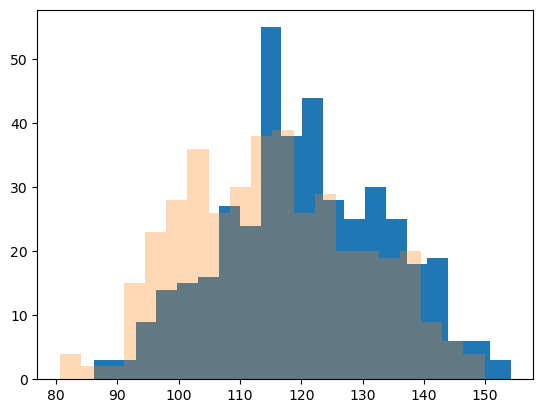

In [141]:
eio_depth(ctrl_z20.sel(time = slice('0950-01-01', '0983-12-31'))).plot.hist(bins = 20)
eio_depth(OC_z20).plot.hist(bins = 20, alpha = 0.3)


In [78]:
ttest_ind(eio_depth(ctrl_z20), eio_depth(MC_z20))

Ttest_indResult(statistic=-1.3041023039819317, pvalue=0.19226095009587574)

In [79]:
ttest_ind(eio_depth(ctrl_z20), eio_depth(OC_z20))

Ttest_indResult(statistic=9.26419631891737, pvalue=3.7855087522328463e-20)

In [80]:
ttest_ind(eio_depth(ctrl_z20), eio_depth(VC_z20))

Ttest_indResult(statistic=6.858271723110489, pvalue=8.532741686678834e-12)

In [147]:
mannwhitneyu(eio_depth(ctrl_z20), eio_depth(MC_z20))

MannwhitneyuResult(statistic=2859365.0, pvalue=0.30672600710136977)

In [102]:
ttest_ind(dmi(ctrl), dmi_slope(ctrl_z20.sel(time = slice('0950-01-01', '1150-12-31'))))

PearsonRResult(statistic=0.43049519608510417, pvalue=2.049291896734695e-109)

In [51]:
MC

<xarray.DataArray (time: 1836, latitude: 180, longitude: 360)>
array([[[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [-1.7486209, -1.7485799, -1.7485391, ..., -1.7487438,
         -1.7487034, -1.7486621],
        [-1.7451688, -1.7451558, -1.7451403, ..., -1.7451926,
         -1.7451872, -1.7451793],
        [-1.7404631, -1.7405026, -1.7405416, ..., -1.7403425,
         -1.740383 , -1.7404233]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
...
        [-1.7424974, -1.7422899, -1.7420797, ..., -1.7430807,
         -1.7429049, -1.7427025],
        [-1.7368797, -1.7368598, -1.736836 , ..., -1.7369151,
         -1.7369076, -1.7368957],
        [-1.7220154, -1.7220896, -1.722161 , ..., -1.7217747,
         -1.7218579, -1.7219381]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [-1.7481898, -1.7480695, -1.7479457, ..., -1.7485111,
         -1.7484204, -1.7483068],
        [-1.7427006, -1.742711 , -1.742718 , ..., -1.742648 ,
         -1.7426695, -1.7426869],
        [-1.7270569, -1.7271612, -1.7272624, ..., -1.7267247,
         -1.7268386, -1.7269492]]], dtype=float32)
Coordinates:
  * time       (time) object 0951-01-16 12:00:00 ... 1103-12-14 12:00:00
  * longitude  (longitude) float64 -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
  * latitude   (latitude) float64 -89.5 -88.5 -87.5 -86.5 ... 87.5 88.5 89.5
Attributes:
    regrid_method:  bilinear

In [56]:
OC_z20

<xarray.DataArray (time: 396, latitude: 180, longitude: 360)>
array([[[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
...
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]])
Coordinates:
  * time       (time) object 0951-01-16 12:00:00 ... 0983-12-16 12:00:00
  * longitude  (longitude) float64 -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
  * latitude   (latitude) float64 -89.5 -88.5 -87.5 -86.5 ... 87.5 88.5 89.5
Attributes:
    regrid_method:  bilinear

In [35]:
dmi(OC).sel(time=dmi(OC)['time.season'] == 'SON').groupby('time.year').mean(dim='time')

<xarray.DataArray (year: 50)>
array([-0.5717929 ,  0.24027814, -0.298522  , -0.248748  , -0.819135  ,
        0.04409559, -0.37717113, -0.25342473,  0.3603737 ,  0.12640195,
        0.44337258,  0.5787402 ,  0.5869656 , -0.13702606, -0.12830745,
        0.15339722, -0.24581726,  0.32072932, -0.2809933 , -0.6654495 ,
        0.28728035, -0.05285474,  0.37577358,  0.3381761 , -0.44667122,
       -0.16532882, -0.00950748,  0.22522868,  0.03448604, -0.43246904,
       -0.29204357,  0.193639  ,  0.00444308, -0.05882195, -0.22892565,
        0.90044206,  0.17989536,  0.33182648, -0.15842873,  0.25605035,
       -0.39391068,  0.5060156 , -0.09959016,  0.60410947,  0.02525309,
        0.34396145,  0.24581976, -0.7500518 , -0.45390496, -0.13785829],
      dtype=float32)
Coordinates:
  * year     (year) int64 951 952 953 954 955 956 ... 995 996 997 998 999 1000

In [38]:
print(xs.pearson_r(dmi(ctrl).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(ctrl_u).groupby('time.season')['SON'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(dmi(MC).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(MC_u).groupby('time.season')['SON'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(dmi(OC).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(OC_u).groupby('time.season')['SON'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(dmi(VC).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(VC_u).groupby('time.season')['SON'].groupby('time.year').mean('time')).values)

-0.6395040154457092
-0.44718554615974426
-0.22646714746952057
-0.44937604665756226


In [39]:
print(xs.pearson_r(eio_depth(ctrl_u).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(ctrl_z20).groupby('time.season')['SON'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(eio_depth(MC_u).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(MC_z20).groupby('time.season')['SON'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(eio_depth(OC_u).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(OC_z20).groupby('time.season')['SON'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(eio_depth(VC_u).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(VC_z20).groupby('time.season')['SON'].groupby('time.year').mean('time')).values)

0.5668639876400338
0.41346138601322774
0.20617959795500435
0.46221387351075177


In [40]:
print(xs.pearson_r(dmi(ctrl).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(ctrl_z20).groupby('time.season')['SON'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(dmi(MC).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(MC_z20).groupby('time.season')['SON'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(dmi(OC).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(OC_z20).groupby('time.season')['SON'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(dmi(VC).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(VC_z20).groupby('time.season')['SON'].groupby('time.year').mean('time')).values)

-0.8461009128261829
-0.7779075679152997
-0.7171505036189327
-0.7805722817446682


In [41]:
print(xs.pearson_r(dmi(ctrl).groupby('time.season')['JJA'].groupby('time.year').mean('time'),
                  eio_depth(ctrl_u).groupby('time.season')['JJA'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(dmi(MC).groupby('time.season')['JJA'].groupby('time.year').mean('time'),
                  eio_depth(MC_u).groupby('time.season')['JJA'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(dmi(OC).groupby('time.season')['JJA'].groupby('time.year').mean('time'),
                  eio_depth(OC_u).groupby('time.season')['JJA'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(dmi(VC).groupby('time.season')['JJA'].groupby('time.year').mean('time'),
                  eio_depth(VC_u).groupby('time.season')['JJA'].groupby('time.year').mean('time')).values)

-0.6975871920585632
-0.651984691619873
-0.3419671058654785
-0.5732100605964661


In [42]:
print(xs.pearson_r(eio_depth(ctrl_u).groupby('time.season')['JJA'].groupby('time.year').mean('time'),
                  eio_depth(ctrl_z20).groupby('time.season')['JJA'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(eio_depth(MC_u).groupby('time.season')['JJA'].groupby('time.year').mean('time'),
                  eio_depth(MC_z20).groupby('time.season')['JJA'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(eio_depth(OC_u).groupby('time.season')['JJA'].groupby('time.year').mean('time'),
                  eio_depth(OC_z20).groupby('time.season')['JJA'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(eio_depth(VC_u).groupby('time.season')['JJA'].groupby('time.year').mean('time'),
                  eio_depth(VC_z20).groupby('time.season')['JJA'].groupby('time.year').mean('time')).values)

0.514031997683419
0.5074543726240494
0.12609898558633076
0.2840052018539239


In [43]:
print(xs.pearson_r(dmi(ctrl).groupby('time.season')['JJA'].groupby('time.year').mean('time'),
                  eio_depth(ctrl_z20).groupby('time.season')['JJA'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(dmi(MC).groupby('time.season')['JJA'].groupby('time.year').mean('time'),
                  eio_depth(MC_z20).groupby('time.season')['JJA'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(dmi(OC).groupby('time.season')['JJA'].groupby('time.year').mean('time'),
                  eio_depth(OC_z20).groupby('time.season')['JJA'].groupby('time.year').mean('time')).values)
print(xs.pearson_r(dmi(VC).groupby('time.season')['JJA'].groupby('time.year').mean('time'),
                  eio_depth(VC_z20).groupby('time.season')['JJA'].groupby('time.year').mean('time')).values)

-0.7695237126785474
-0.7641233408663041
-0.7370169741591421
-0.704260722972486


Text(0.5, 1.0, 'No ENSO, no Bias')

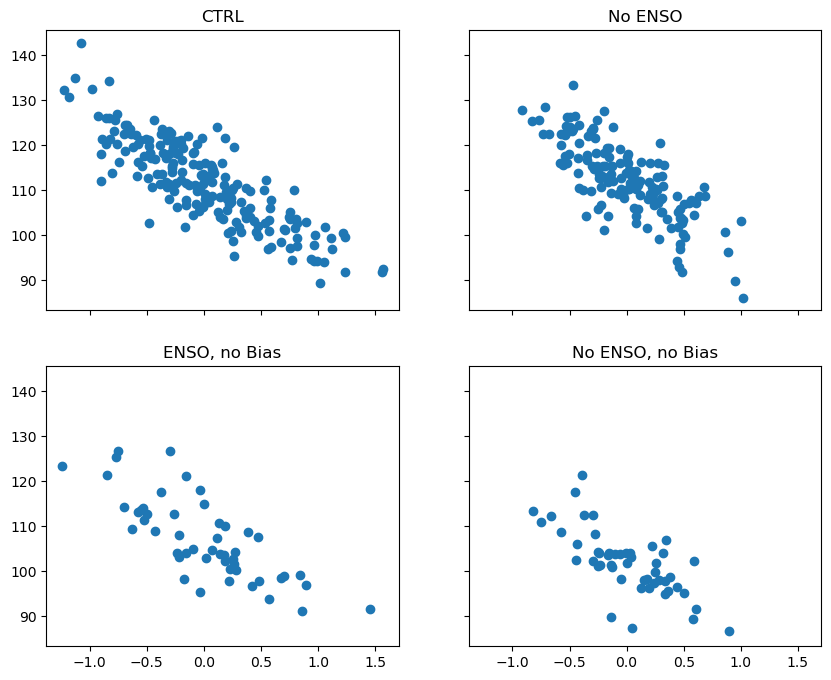

In [46]:
fig, axs = plt.subplots(2, 2, figsize=(10, 8), sharex=True, sharey=True)

axs[0, 0].scatter(dmi(ctrl).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(ctrl_z20).groupby('time.season')['SON'].groupby('time.year').mean('time'))
axs[0, 0].set_title('CTRL')

axs[0, 1].scatter(dmi(MC).groupby('time.season')['SON'].groupby('time.year').mean('time'), 
                  eio_depth(MC_z20).groupby('time.season')['SON'].groupby('time.year').mean('time'))
axs[0, 1].set_title('No ENSO')

axs[1, 0].scatter(dmi(VC).groupby('time.season')['SON'].groupby('time.year').mean('time'), 
                  eio_depth(VC_z20).groupby('time.season')['SON'].groupby('time.year').mean('time'))
axs[1, 0].set_title('ENSO, no Bias')

axs[1, 1].scatter(dmi(OC).groupby('time.season')['SON'].groupby('time.year').mean('time'), 
                  eio_depth(OC_z20).groupby('time.season')['SON'].groupby('time.year').mean('time'))
axs[1, 1].set_title('No ENSO, no Bias')


Text(0.5, 1.0, 'no enso no bias')

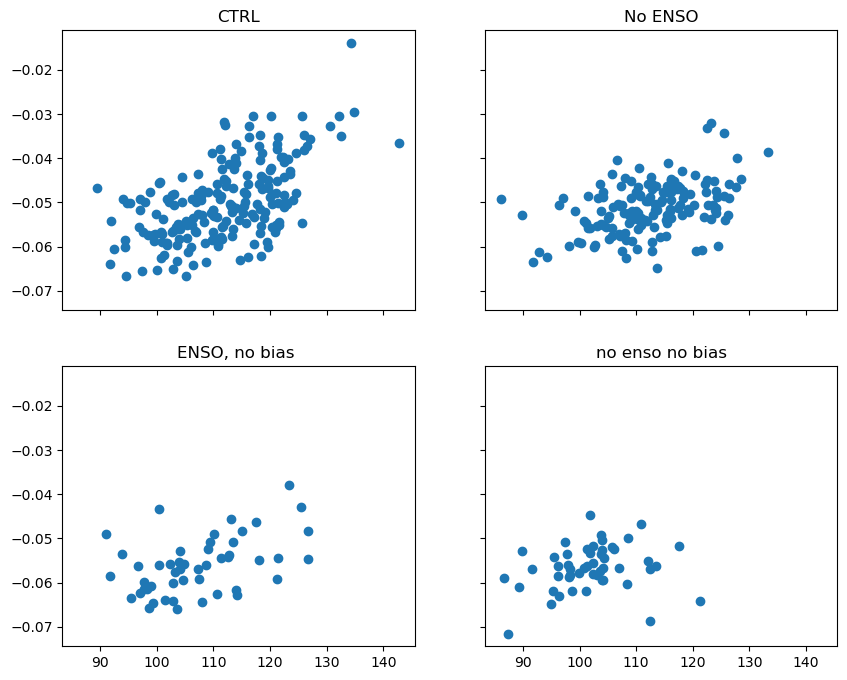

In [47]:
fig, axs = plt.subplots(2, 2, figsize=(10, 8), sharex=True, sharey=True)

axs[0, 0].scatter(eio_depth(ctrl_z20).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(ctrl_u).groupby('time.season')['SON'].groupby('time.year').mean('time'))
axs[0, 0].set_title('CTRL')

axs[0, 1].scatter(eio_depth(MC_z20).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(MC_u).groupby('time.season')['SON'].groupby('time.year').mean('time'))
axs[0, 1].set_title('No ENSO')

axs[1, 0].scatter(eio_depth(VC_z20).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(VC_u).groupby('time.season')['SON'].groupby('time.year').mean('time'))
axs[1, 0].set_title('ENSO, no bias ')

axs[1, 1].scatter(eio_depth(OC_z20).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(OC_u).groupby('time.season')['SON'].groupby('time.year').mean('time'))
axs[1, 1].set_title('no enso no bias')


Text(0.5, 1.0, 'no enso no bias')

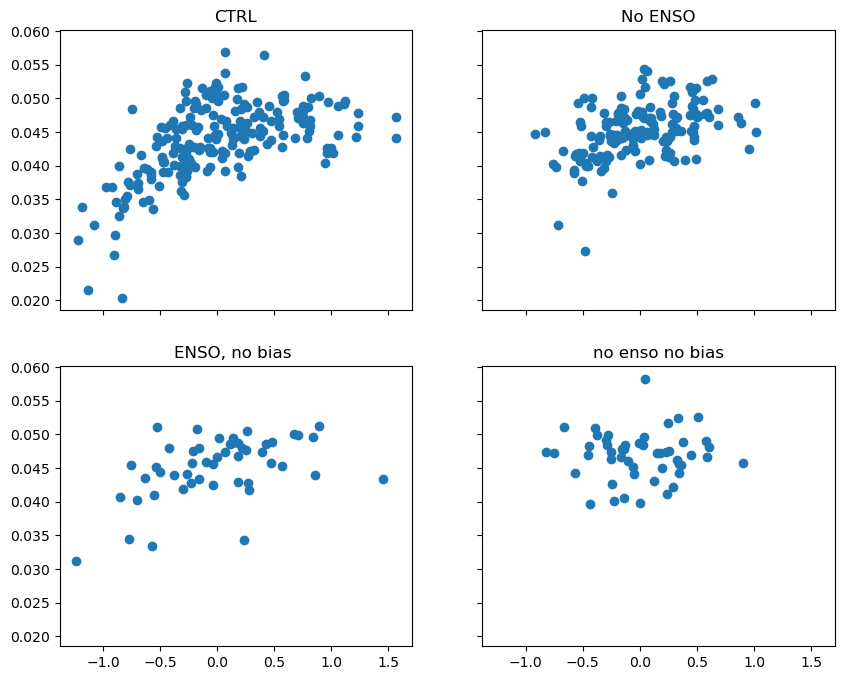

In [50]:
fig, axs = plt.subplots(2, 2, figsize=(10, 8), sharex=True, sharey=True)

axs[0, 0].scatter(dmi(ctrl).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(ctrl_v).groupby('time.season')['SON'].groupby('time.year').mean('time'))
axs[0, 0].set_title('CTRL')

axs[0, 1].scatter(dmi(MC).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(MC_v).groupby('time.season')['SON'].groupby('time.year').mean('time'))
axs[0, 1].set_title('No ENSO')

axs[1, 0].scatter(dmi(VC).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(VC_v).groupby('time.season')['SON'].groupby('time.year').mean('time'))
axs[1, 0].set_title('ENSO, no bias ')

axs[1, 1].scatter(dmi(OC).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(OC_v).groupby('time.season')['SON'].groupby('time.year').mean('time'))
axs[1, 1].set_title('no enso no bias')


Text(0.5, 1.0, 'no enso no bias')

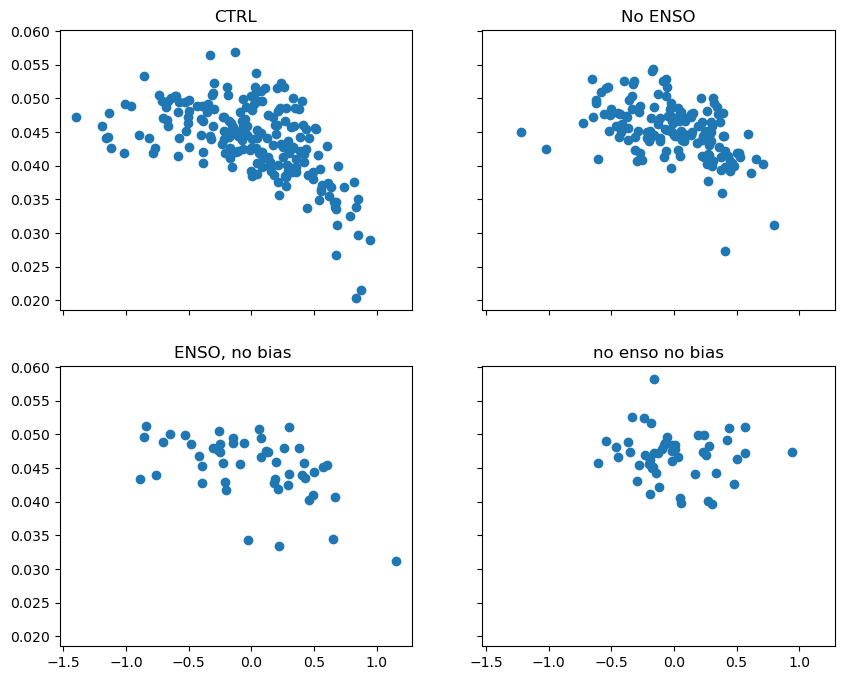

In [44]:
fig, axs = plt.subplots(2, 2, figsize=(10, 8), sharex=True, sharey=True)

axs[0, 0].scatter(eio(ctrl).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(ctrl_v).groupby('time.season')['SON'].groupby('time.year').mean('time'))
axs[0, 0].set_title('CTRL')

axs[0, 1].scatter(eio(MC).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(MC_v).groupby('time.season')['SON'].groupby('time.year').mean('time'))
axs[0, 1].set_title('No ENSO')

axs[1, 0].scatter(eio(VC).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(VC_v).groupby('time.season')['SON'].groupby('time.year').mean('time'))
axs[1, 0].set_title('ENSO, no bias ')

axs[1, 1].scatter(eio(OC).groupby('time.season')['SON'].groupby('time.year').mean('time'),
                  eio_depth(OC_v).groupby('time.season')['SON'].groupby('time.year').mean('time'))
axs[1, 1].set_title('no enso no bias')


Text(0, 0.5, 'IODE z20 depth')

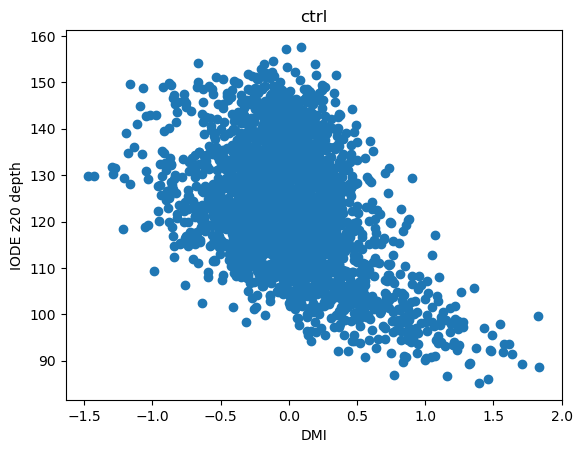

In [47]:
plt.figure
plt.scatter(dmi(ctrl), eio_depth(ctrl_z20.sel(time = slice('0950-01-01', '1150-12-31'))))
plt.title("ctrl")
plt.xlabel("DMI")
plt.ylabel("IODE z20 depth")

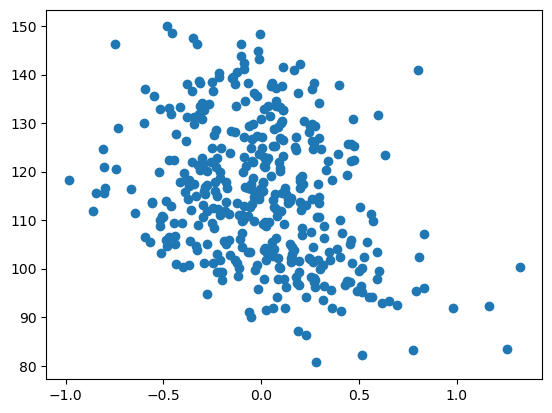

In [108]:
plt.scatter(dmi(OC.sel(time = slice('0950-01-01', '0983-12-31'))), eio_depth(OC_z20))

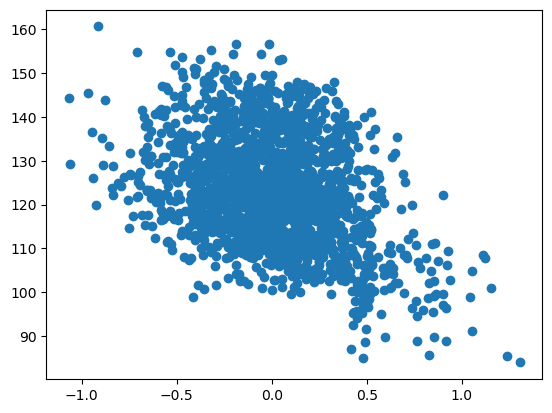

In [112]:
plt.scatter(dmi(MC), eio_depth(MC_z20.sel(time = slice('0950-01-01', '1103-12-31'))))

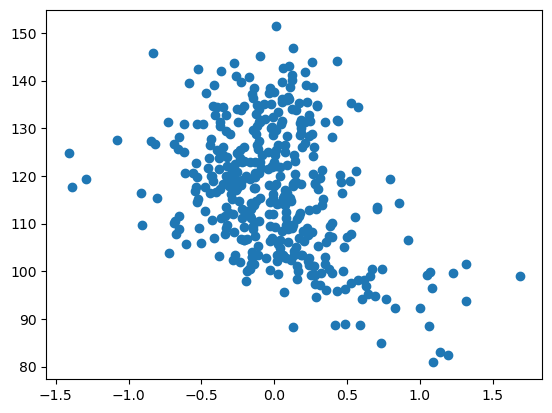

In [117]:
plt.scatter(dmi(VC.sel(time = slice('0950-01-01', '0983-12-31'))), eio_depth(VC_z20))

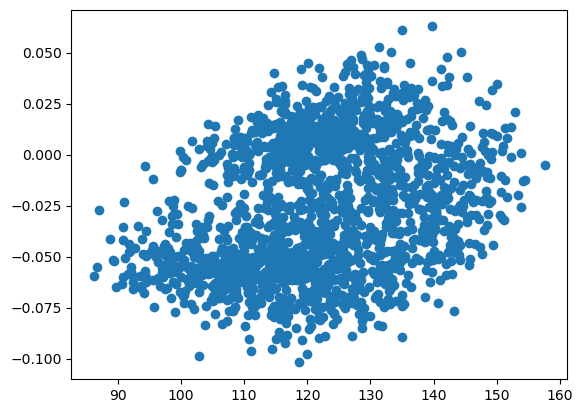

In [45]:
plt.scatter(eio_depth(ctrl_z20.sel(time = slice('0950-01-01', '1100-12-31'))), eio_depth(ctrl_u.sel(time = slice('0950-01-01', '1100-12-31'))))


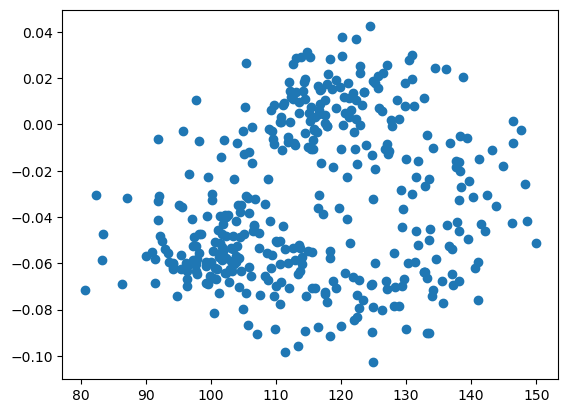

In [46]:
plt.scatter(eio_depth(OC_z20.sel(time = slice('0950-01-01', '1100-12-31'))), eio_depth(OC_u.sel(time = slice('0950-01-01', '1100-12-31'))))


In [ ]:
.sel(time = slice('0950-01-01', '0983-12-31'))

In [66]:
def plot_hovmoller(ds, ref, lat1, lat2):
    plt.figure(figsize = (10,8))
    ds2 = (ds.groupby('time.month')-ref.groupby('time.month').mean('time'))
    ds2.sel(latitude = slice(lat1,lat2)).mean('latitude').sel(longitude = slice(40, 150
                                                )).sel(time = slice('0950-01-01', '0980-12-31')
                                    ).plot.contourf(levels = 15)
    return

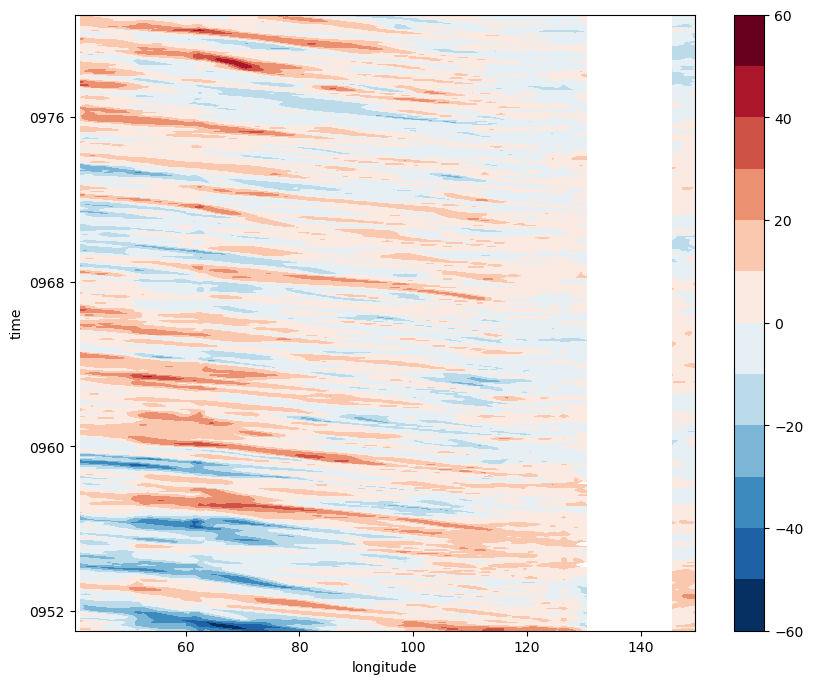

In [72]:
plot_hovmoller(OC_z20, OC_z20, -12, -9)

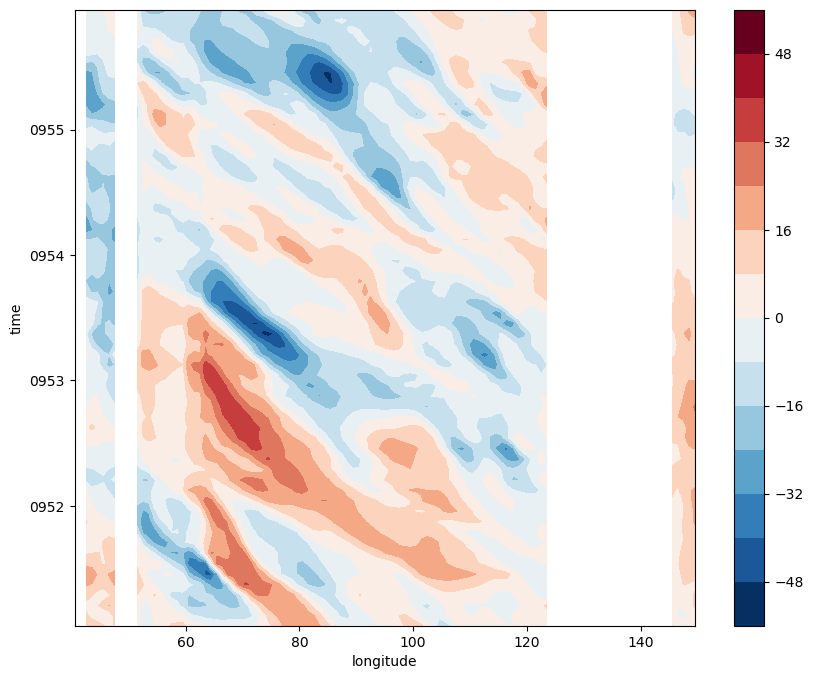

In [63]:
plot_hovmoller(OC_z20, ctrl_z20, -15, -12)

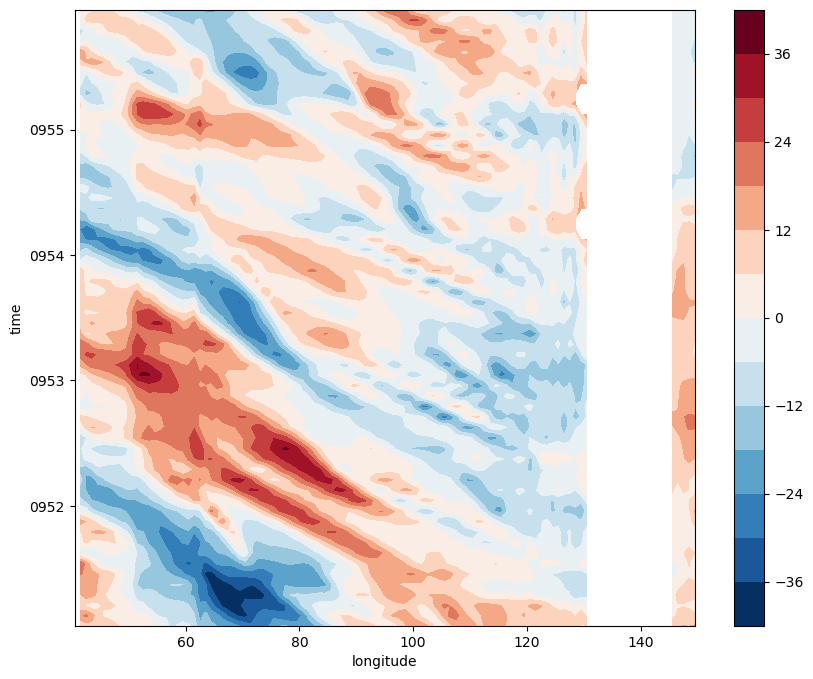

In [64]:
plot_hovmoller(OC_z20, ctrl_z20, -12, -9)

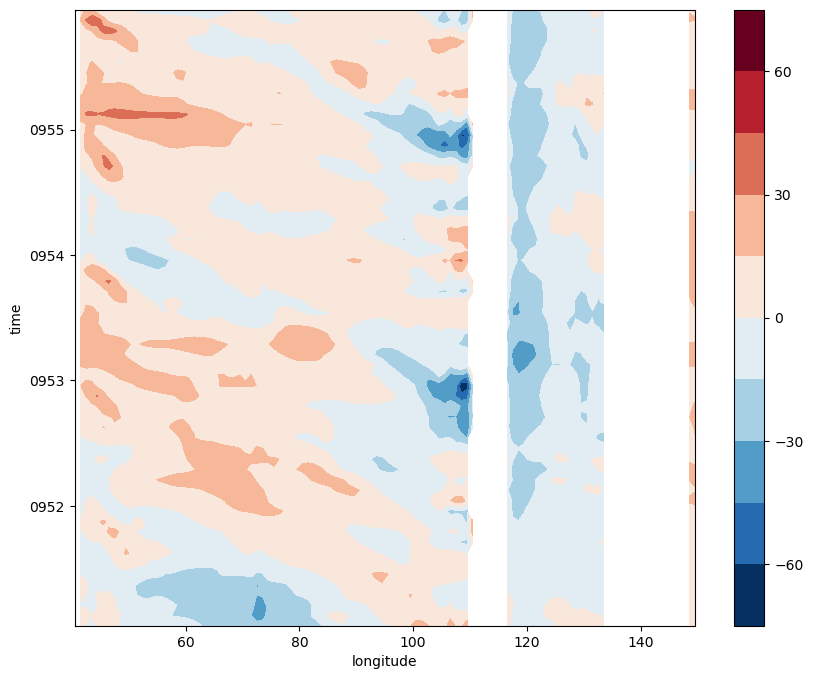

In [65]:
plot_hovmoller(OC_z20, ctrl_z20, -9, -6)

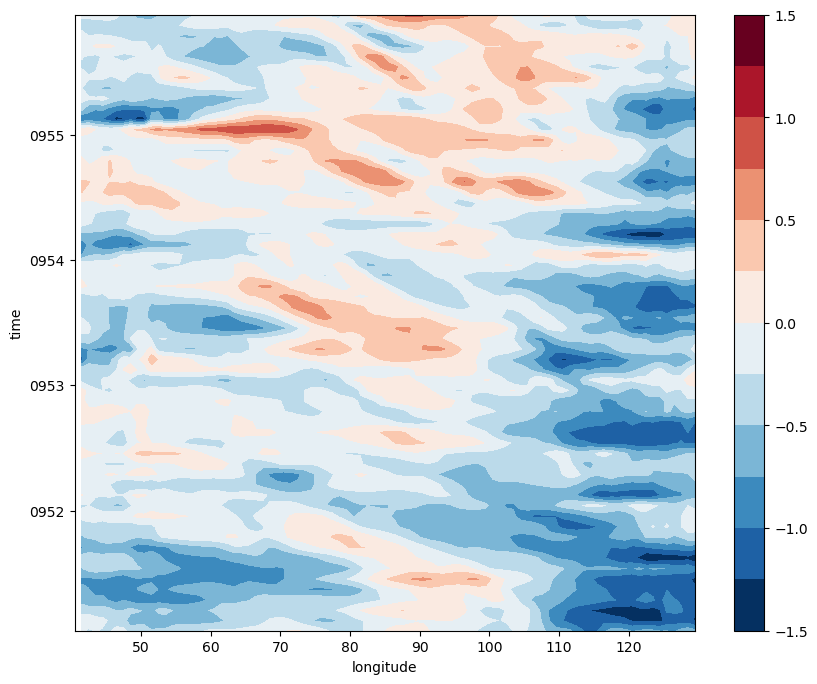

In [44]:
#plot the hovmller SST anomaly
plt.figure(figsize = (10,8))
(OC.groupby('time.month')-ctrl.groupby('time.month').mean('time')).sel(latitude = slice(-15,-10)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0950-01-01', '0955-12-31')).plot.contourf(levels = 15)

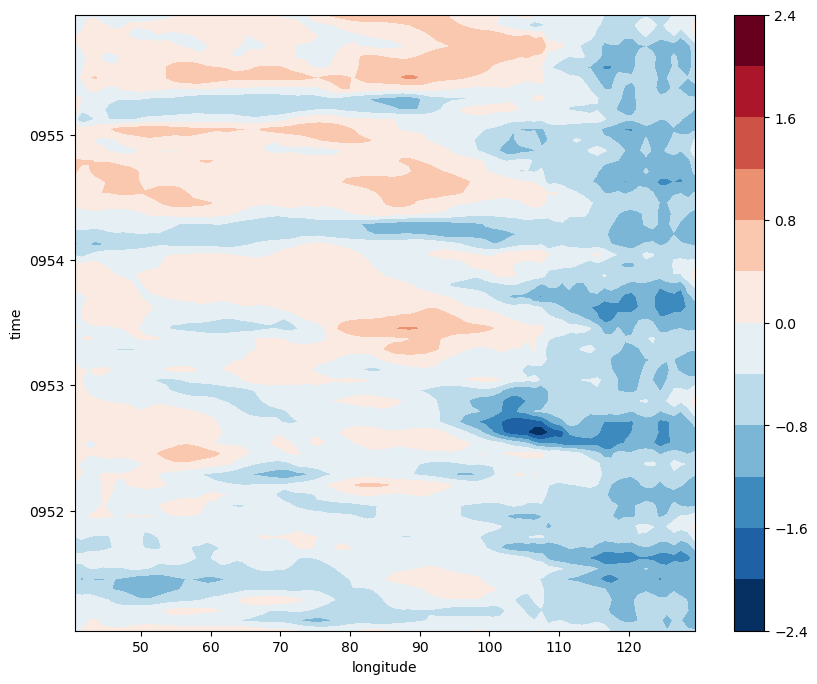

In [45]:
#plot the hovmller SST anomaly
plt.figure(figsize = (10,8))
(OC.groupby('time.month')-MC.groupby('time.month').mean('time')).sel(latitude = slice(-10,-5)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0950-01-01', '0955-12-31')).plot.contourf(levels = 15)

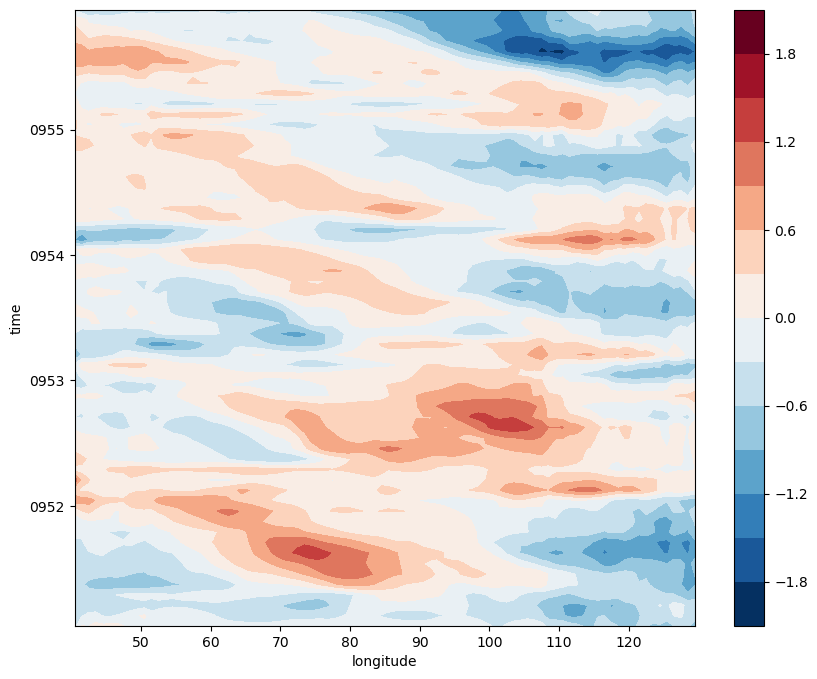

In [37]:
#plot the hovmller SST anomaly
plt.figure(figsize = (10,8))
(VC.groupby('time.month')-ctrl.groupby('time.month').mean('time')).sel(latitude = slice(-15,-5)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0950-01-01', '0955-12-31')).plot.contourf(levels = 15)

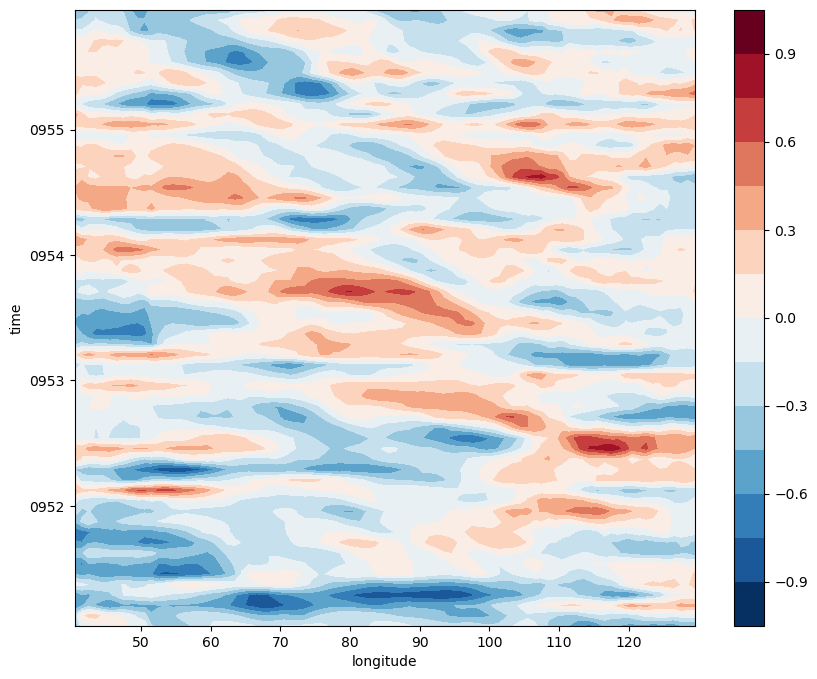

In [38]:
#plot the hovmller SST anomaly
plt.figure(figsize = (10,8))
(MC.groupby('time.month')-ctrl.groupby('time.month').mean('time')).sel(latitude = slice(-15,-5)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0950-01-01', '0955-12-31')).plot.contourf(levels = 15)

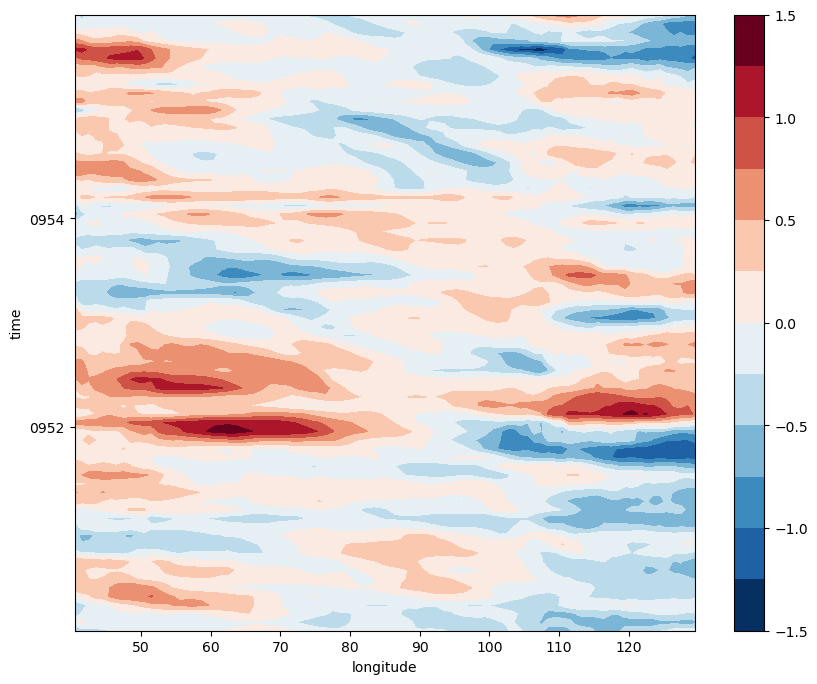

In [39]:
#plot the hovmller SST anomaly
plt.figure(figsize = (10,8))
(ctrl.groupby('time.month')-ctrl.groupby('time.month').mean('time')).sel(latitude = slice(-15,-5)).mean('latitude').sel(longitude = slice(40, 130)).sel(time = slice('0950-01-01', '0955-12-31')).plot.contourf(levels = 15)

In [141]:
def calculate_wind_stress_curl_and_ekman_pumping(u_wind_stress, v_wind_stress, latitude, rho=1025):
    """
    Calculate wind stress curl and Ekman pumping in the ocean.
    
    Parameters:
        u_wind_stress (xarray.DataArray): Zonal (u) component of wind stress.
        v_wind_stress (xarray.DataArray): Meridional (v) component of wind stress.
        latitude (xarray.DataArray): Latitude values corresponding to wind stress components.
        rho (float, optional): Water density (default: 1025 kg/m³).
        
    Returns:
        wind_stress_curl (xarray.DataArray): Calculated wind stress curl.
        ekman_pumping (xarray.DataArray): Calculated Ekman pumping.
    """
    
    mask = np.logical_or(latitude < -3, latitude > 3)
    
    # Calculate Coriolis parameter (f) based on latitude
    f = 2 * 7.2921e-5 * np.sin(latitude * np.pi / 180)
    
    # Calculate wind stress curl
    du_dy = u_wind_stress.where(mask).differentiate('latitude', edge_order=1) / 110e3
    dv_dx = v_wind_stress.where(mask).differentiate('longitude', edge_order=1) / (110e3 * np.cos(latitude * np.pi / 180))
    wind_stress_curl = dv_dx - du_dy
    
    # Calculate Ekman pumping
    ekman_pumping = -(wind_stress_curl / (rho * f))
    #ek = (1/(rho*f))*(dv_dx-du_dy)
    
    
    return wind_stress_curl, ekman_pumping

In [142]:
wsc, ek = calculate_wind_stress_curl_and_ekman_pumping(OC_u, OC_v, OC_u.latitude)

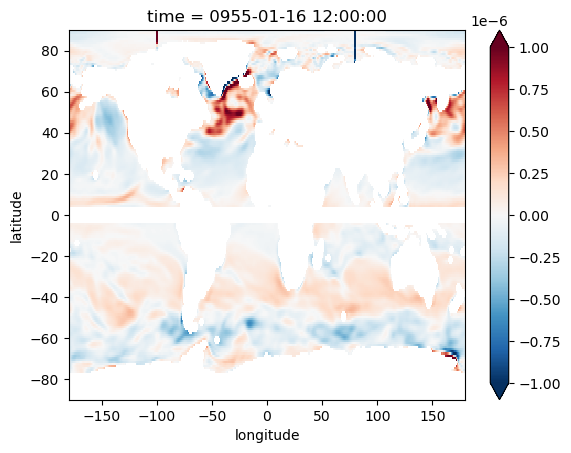

In [147]:
wsc[48].plot(cmap = "RdBu_r", vmin = -1e-6, vmax = 1e-6)

In [53]:
24*60*60*10


864000

In [55]:
#lets try a density calculation for z20

In [56]:
test = xr.open_dataset("/scratch/e14/sm2435/PACE_OC/cy286/history/ocn/ocean_month.nc-09551231")

/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/xarray/coding/times.py:710: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.10/lib/python3.9/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


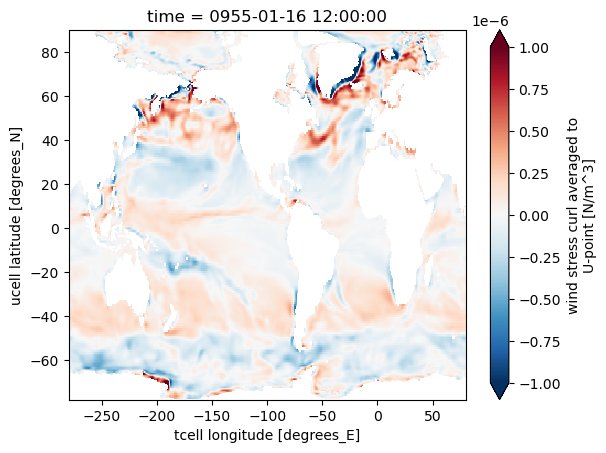

In [146]:
test.tau_curl[0].plot(cmap = "RdBu_r", vmin = -1e-6, vmax = 1e-6)

In [120]:
thetao = test.temp

In [122]:
z20 = isosurface(test.temp, 293.15, dim = "st_ocean")

In [58]:
density = test.rho

In [62]:
thickness = test.dht

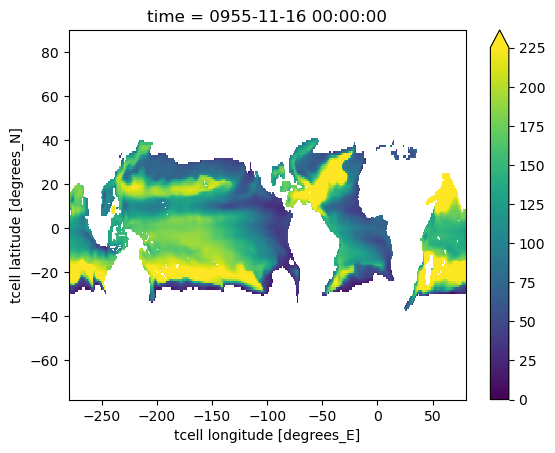

In [128]:
z20[10].plot(vmin = 0, vmax = 225)

In [74]:
drhodz = density.differentiate("st_ocean")/thickness

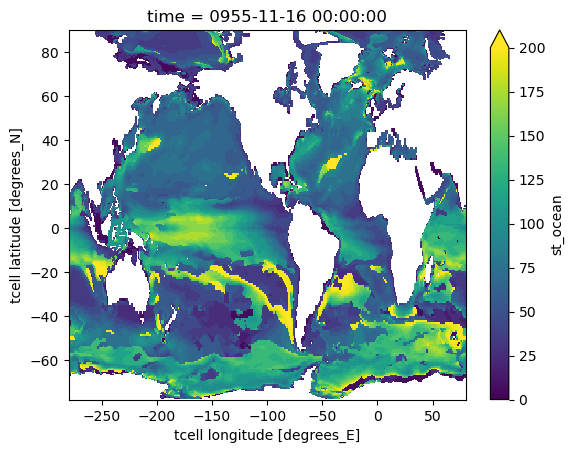

In [127]:
drhodz.idxmax("st_ocean")[10].plot(vmin = 0, vmax = 200)

In [96]:
sorted_1[0]

<xarray.DataArray (st_ocean: 50, yt_ocean: 300, xt_ocean: 360)>
array([[[  0, 244, 243, ..., 114, 112, 359],
        [101, 102, 100, ..., 133, 131, 359],
        [231, 100, 101, ..., 137, 155, 359],
        ...,
        [309, 142, 307, ..., 196, 174, 359],
        [135, 306, 143, ..., 192, 194, 359],
        [319, 333, 334, ..., 188, 181, 359]],

       [[  0, 244, 243, ..., 114, 112, 359],
        [101, 100, 102, ..., 133, 131, 359],
        [100, 101,  99, ..., 137, 155, 359],
        ...,
        [309, 125, 127, ..., 196, 174, 359],
        [135, 306, 134, ..., 192, 194, 359],
        [122, 305, 145, ..., 188, 181, 359]],

       [[  0, 244, 243, ..., 114, 112, 359],
        [100,  99, 101, ..., 133, 131, 359],
        [231,  99,  98, ..., 137, 155, 359],
        ...,
...
        ...,
        [  0, 244, 243, ..., 114, 112, 359],
        [  0, 244, 243, ..., 114, 112, 359],
        [  0, 244, 243, ..., 114, 112, 359]],

       [[  0, 244, 243, ..., 114, 112, 359],
        [  0, 244, 243, ..., 114, 112, 359],
        [  0, 244, 243, ..., 114, 112, 359],
        ...,
        [  0, 244, 243, ..., 114, 112, 359],
        [  0, 244, 243, ..., 114, 112, 359],
        [  0, 244, 243, ..., 114, 112, 359]],

       [[  0, 244, 243, ..., 114, 112, 359],
        [  0, 244, 243, ..., 114, 112, 359],
        [  0, 244, 243, ..., 114, 112, 359],
        ...,
        [  0, 244, 243, ..., 114, 112, 359],
        [  0, 244, 243, ..., 114, 112, 359],
        [  0, 244, 243, ..., 114, 112, 359]]])
Coordinates:
  * xt_ocean  (xt_ocean) float64 -279.5 -278.5 -277.5 -276.5 ... 77.5 78.5 79.5
  * yt_ocean  (yt_ocean) float64 -77.88 -77.63 -77.38 ... 88.87 89.32 89.77
    time      object 0955-01-16 12:00:00
  * st_ocean  (st_ocean) float64 5.0 15.0 25.0 ... 5.166e+03 5.499e+03 5.831e+03
    geolat_t  (yt_ocean, xt_ocean) float32 -77.88 -77.88 -77.88 ... 65.63 65.21
    geolon_t  (yt_ocean, xt_ocean) float32 -279.5 -278.5 -277.5 ... 79.97 79.99

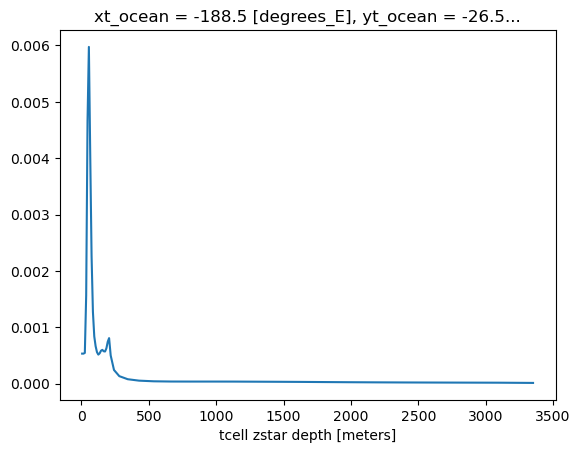

In [111]:
drhodz[2,:,80,91].plot()

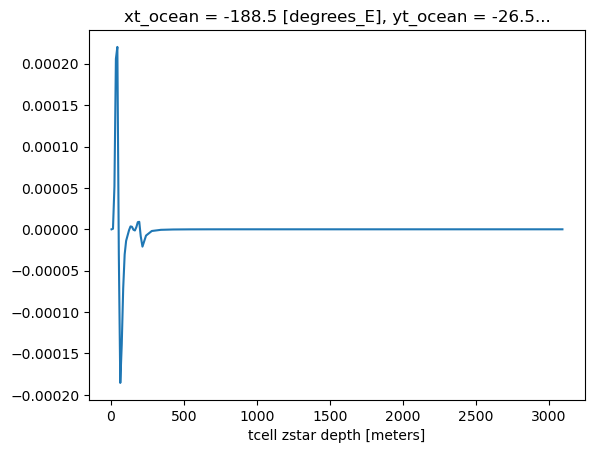

In [110]:
drhodz[2,:,80,91].differentiate("st_ocean").plot()

In [105]:
#density[2,:,80,91].plot()
np.argsort(drhodz[2,:,80,91])#[::-1]

<xarray.DataArray (st_ocean: 50)>
array([41, 40, 39, 38, 37, 36, 35, 34, 33, 32, 31, 30, 28, 29, 27, 26, 25,
       24, 23, 22, 21, 12,  1,  0, 13,  2, 11, 17, 16, 14, 15, 18, 10, 19,
       20,  9,  8,  3,  7,  6,  4,  5, 46, 47, 45, 48, 43, 42, 44, 49])
Coordinates:
    xt_ocean  float64 -188.5
    yt_ocean  float64 -26.52
    time      object 0955-03-16 12:00:00
  * st_ocean  (st_ocean) float64 5.0 15.0 25.0 ... 5.166e+03 5.499e+03 5.831e+03
    geolat_t  float32 -26.52
    geolon_t  float32 -188.5

In [80]:
drhodz[2,:,90,91].idxmax()

<xarray.DataArray 'st_ocean' ()>
array(35.)
Coordinates:
    xt_ocean  float64 -188.5
    yt_ocean  float64 -17.85
    time      object 0955-03-16 12:00:00
    geolat_t  float32 -17.85
    geolon_t  float32 -188.5

In [ ]:
TCM = (TM.diff('level')/(TM.level.diff('level'))).idxmin('level').groupby('time.month').mean('time')

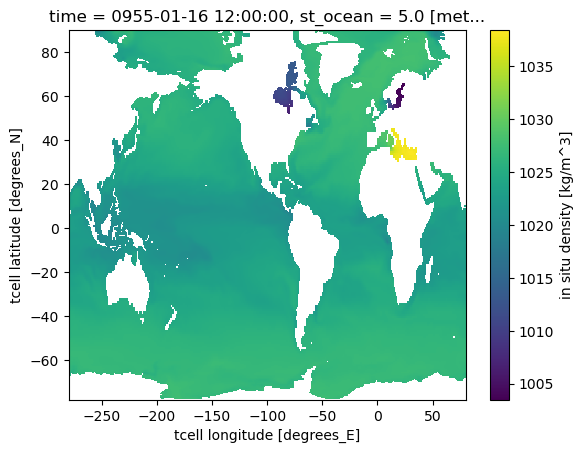

In [65]:
density[0,0].plot()

In [117]:
def isosurface(field, target, dim):
    """
    Linearly interpolate a coordinate isosurface where a field
    equals a target

    Parameters
    ----------
    field : xarray DataArray
        The field in which to interpolate the target isosurface
    target : float
        The target isosurface value
    dim : str
        The field dimension to interpolate
        
    Examples
    --------
    Calculate the depth of an isotherm with a value of 5.5:
    
    >>> temp = xr.DataArray(
    ...     range(10,0,-1),
    ...     coords={"depth": range(10)}
    ... )
    >>> isosurface(temp, 5.5, dim="depth")
    <xarray.DataArray ()>
    array(4.5)
    """
    slice0 = {dim: slice(None, -1)}
    slice1 = {dim: slice(1, None)}

    field0 = field.isel(slice0).drop(dim)
    field1 = field.isel(slice1).drop(dim)

    crossing_mask_decr = (field0 > target) & (field1 <= target)
    crossing_mask_incr = (field0 < target) & (field1 >= target)
    crossing_mask = xr.where(
        crossing_mask_decr | crossing_mask_incr, 1, np.nan
    )

    coords0 = crossing_mask * field[dim].isel(slice0).drop(dim)
    coords1 = crossing_mask * field[dim].isel(slice1).drop(dim)
    field0 = crossing_mask * field0
    field1 = crossing_mask * field1

    iso = (
        coords0 + (target - field0) * 
        (coords1 - coords0) / (field1 - field0)
    )

    return iso.max(dim, skipna=True)

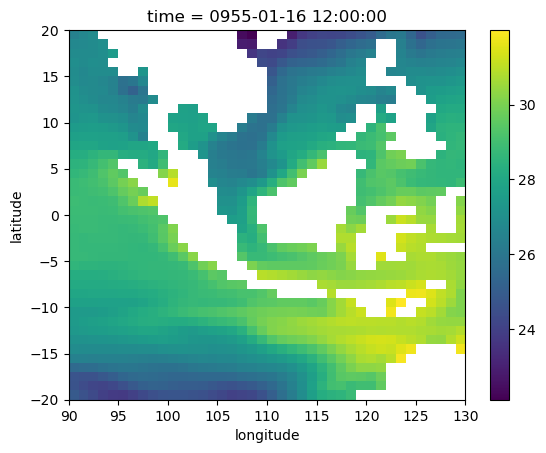

2023-09-12 15:40:31,696 - distributed.nanny - WARNING - Restarting worker
2023-09-12 15:40:31,699 - distributed.nanny - WARNING - Restarting worker
2023-09-12 15:40:31,785 - distributed.nanny - WARNING - Restarting worker
2023-09-12 15:40:31,791 - distributed.nanny - WARNING - Restarting worker
2023-09-12 15:40:31,889 - distributed.nanny - WARNING - Restarting worker
2023-09-12 15:40:31,935 - distributed.nanny - WARNING - Restarting worker
2023-09-12 15:40:31,979 - distributed.nanny - WARNING - Restarting worker
2023-09-12 15:40:31,989 - distributed.nanny - WARNING - Restarting worker
2023-09-12 15:40:32,029 - distributed.nanny - WARNING - Restarting worker
2023-09-12 15:40:32,063 - distributed.nanny - WARNING - Restarting worker
2023-09-12 15:40:32,069 - distributed.nanny - WARNING - Restarting worker
2023-09-12 15:40:32,176 - distributed.nanny - WARNING - Restarting worker
2023-09-12 15:40:32,178 - distributed.nanny - WARNING - Restarting worker
2023-09-12 15:40:32,213 - distributed.

In [53]:
ctrl.sel(latitude = slice(-20,20), longitude = slice(90,130))[60].plot()